<a href="https://colab.research.google.com/github/humzkhan/Adaptive_learning/blob/main/Thesis_Smooth2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install scikit-optimize

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings("ignore", category=UserWarning)

from skopt import gp_minimize
from skopt.plots import plot_convergence

import os
import glob
import pandas as pd

import re

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from mpl_toolkits.mplot3d import Axes3D
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.gaussian_process.kernels import RBF, WhiteKernel, ExpSineSquared, RationalQuadratic, Matern, Product, ConstantKernel as C
from collections import defaultdict
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from pandas.plotting import parallel_coordinates
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
from scipy.stats import f_oneway

In [3]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)  # Approve the authentication prompts as needed

Mounted at /content/drive


Helper Functions

In [4]:
def check_headers(dataframes, required_headers):
    """
    Check each DataFrame for the presence of required headers.

    Parameters:
    - dataframes (dict): Dictionary where keys are file paths and values are DataFrames.
    - required_headers (list): List of required headers to check for.

    Returns:
    - dict: Dictionary with filenames as keys and missing headers as values.
    """
    missing_headers = {}

    for file_path, df in dataframes.items():
        # Normalize the column names: lowercase and remove spaces
        normalized_columns = [col.lower().replace(" ", "") for col in df.columns]

        # Find missing headers
        file_missing = [header.lower().replace(" ", "") for header in required_headers if header.lower().replace(" ", "") not in normalized_columns]

        if file_missing:
            missing_headers[file_path] = file_missing

    return missing_headers

def add_missing_headers_flexible(dataframes):
    """
    Add missing headers to DataFrames by searching flexibly for S11 and S21 in column headers.

    Parameters:
    - dataframes (dict): Dictionary where keys are file paths and values are DataFrames.

    Returns:
    - dict: Updated dictionary of DataFrames with missing headers added.
    """
    updated_files = []  # To track files that were updated

    for file_path, df in dataframes.items():
        # Normalize column names for consistent matching
        df.columns = [col.lower().replace(" ", "").replace("(linm)", "") for col in df.columns]

        # Flag to track if any update was made
        updated = False

        # Attempt to locate 'S11' and 'S21' columns
        s11_col = next((col for col in df.columns if "s11" in col), None)
        s21_col = next((col for col in df.columns if "s21" in col), None)

        # Check and calculate each required column
        if 'r' not in df.columns:
            if s11_col:
                df['r'] = df[s11_col] ** 2
                updated = True
            else:
                print(f"Missing 'S11' column for calculating 'R' in {file_path}")
                continue

        if 't' not in df.columns:
            if s21_col:
                df['t'] = df[s21_col] ** 2
                updated = True
            else:
                print(f"Missing 'S21' column for calculating 'T' in {file_path}")
                continue

        if 'a' not in df.columns:
            if 'r' in df.columns and 't' in df.columns:
                df['a'] = 1 - df['r'] - df['t']
                updated = True
            else:
                print(f"Cannot calculate 'A' in {file_path} due to missing 'R' or 'T'")
                continue

        if 'ser' not in df.columns:
            if 'r' in df.columns:
                df['ser'] = -10 * np.log10(1 - df['r'])
                updated = True
            else:
                print(f"Cannot calculate 'SEr' in {file_path} due to missing 'R'")
                continue

        if 'set' not in df.columns:
            if 't' in df.columns:
                df['set'] = -10 * np.log10(df['t'])
                updated = True
            else:
                print(f"Cannot calculate 'SEt' in {file_path} due to missing 'T'")
                continue

        if 'sea' not in df.columns:
            if 'set' in df.columns and 'ser' in df.columns:
                df['sea'] = df['set'] - df['ser']
                updated = True
            else:
                print(f"Cannot calculate 'SEa' in {file_path} due to missing 'SEt' or 'SEr'")
                continue

        # If updated, track the file
        if updated:
            updated_files.append(file_path)

        # Update DataFrame in the dictionary
        dataframes[file_path] = df

    ## Print updated files
    #for file_path in updated_files:
     #   print(f"\nUpdated {file_path}:")
      #  print(dataframes[file_path].head(1))  # Print only the first row for preview

    return dataframes

def standardize_files(dataframes):
    """
    Standardize the headers and clean up the data for all provided dataframes.

    Parameters:
    - dataframes (dict): Dictionary where keys are file paths and values are DataFrames.

    Returns:
    - dict: Updated dictionary with standardized DataFrames.
    """
    standardized_headers = [
        "frequency(Hz)", "Tr 1  Data(e')", "Tr 2  Data(e'')", "Tr 3  Data(u')",
        "Tr 4  Data(u'')", "Tr 5  S11(LinM)", "Tr 6  S21(LinM)", "R", "T", "A", "SEr", "Sea", "Set"
    ]
    standardized_dfs = {}

    for file_path, df in dataframes.items():
        # Standardize column names (remove spacing, normalize to lowercase for matching)
        df.columns = [col.lower().strip().replace(" ", "").replace("(linm)", "") for col in df.columns]

        # Map the standardized headers to the current column names
        column_mapping = {}
        for std_col in standardized_headers:
            std_col_lower = std_col.lower().replace(" ", "").replace("(linm)", "")
            match = next((col for col in df.columns if col == std_col_lower), None)
            if match:
                column_mapping[match] = std_col

        # Apply the mapping to the DataFrame
        df = df.rename(columns=column_mapping)

        # Retain only the standardized headers
        df = df[[col for col in standardized_headers if col in df.columns]]

        # Filter rows to keep only frequency values within the specified range (12.4 GHz to 18 GHz)
        freq_col = "frequency(Hz)"
        if freq_col in df.columns:
            df = df[(df[freq_col] >= 12.4e9) & (df[freq_col] <= 18e9)]

        # Save the standardized DataFrame
        standardized_dfs[file_path] = df

    return standardized_dfs


def remove_footer_data(dataframes):
    """
    Remove footer data from DataFrames by splitting off rows starting at the first null value.

    Parameters:
    - dataframes (dict): Dictionary where keys are file paths and values are DataFrames.

    Returns:
    - dict: Updated dictionary of DataFrames with footer data removed.
    """
    updated_dataframes = {}

    for file_path, df in dataframes.items():
        # Find the first index where a null value appears
        null_index = df.isnull().any(axis=1).idxmax() if df.isnull().any().any() else None

        if null_index is not None and null_index > 0:
            # Keep only the rows before the first null
            df_cleaned = df.iloc[:null_index]
            #print(f"Footer data removed from {file_path} starting at index {null_index}")
        else:
            df_cleaned = df  # No null values, keep the DataFrame as is
            #print(f"No footer data found in {file_path}")

        # Update the dictionary with cleaned DataFrame
        updated_dataframes[file_path] = df_cleaned

    return updated_dataframes

def thesis_row_with_alternative_features(file_path, df):
    """
    Extract features for a single dataframe with alternative features for modeling.

    Parameters:
    - file_path (str): Path to the file.
    - df (pd.DataFrame): Dataframe to process.

    Returns:
    - dict: Extracted features as a dictionary.
    """

    match = re.search(r'(\d+)%/(ABS|PBT)/(\d+)%-(ABS|PBT)-([\d.]+)mm', file_path)
    if not match:
        print(f"Filename format not recognized: {file_path}")
        return None

    cnt_pct = int(match.group(1))
    material = match.group(2)
    thickness = float(match.group(5))

    # Normalize column names
    df.columns = [col.strip().lower() for col in df.columns]

    # Create a row with features
    row = {
        'filename': file_path,
        'cnt_pct': cnt_pct,
        'material': material,
        'thickness': thickness,
        'mean_a': df['a'].mean() if 'a' in df.columns else np.nan,
        'max_a': df['a'].max() if 'a' in df.columns else np.nan,
        'std_a': df['a'].std() if 'a' in df.columns else np.nan,
        'range_a': (df['a'].max() - df['a'].min()) if 'a' in df.columns else np.nan,
        'weighted_mean_a': (df['a'] * df['frequency(hz)']).sum() / df['frequency(hz)'].sum()
        if 'a' in df.columns else np.nan,
        'mean_r': df['r'].mean() if 'r' in df.columns else np.nan,
        'std_r': df['r'].std() if 'r' in df.columns else np.nan,
        'mean_t': df['t'].mean() if 't' in df.columns else np.nan,
        'std_t': df['t'].std() if 't' in df.columns else np.nan,
        'mean_a_to_r_ratio': (df['a'].mean() / df['r'].mean()) if 'a' in df.columns and 'r' in df.columns else np.nan,
        'gradient_a': np.gradient(df['a']).mean() if 'a' in df.columns else np.nan,
        'gradient_r': np.gradient(df['r']).mean() if 'r' in df.columns else np.nan,
        'gradient_t': np.gradient(df['t']).mean() if 't' in df.columns else np.nan,
        'performance_score': (
            0.5 * df['a'].mean() - 0.3 * df['r'].mean() + 0.2 * df['t'].mean()
        ) if 'a' in df.columns and 'r' in df.columns and 't' in df.columns else np.nan,
    }
    return row

def create_thesis_dataframe_with_alternative_features(dataframes):
    """
    Create a single thesis dataframe by processing multiple dataframes with alternative features.

    Parameters:
    - dataframes (dict): Dictionary where keys are file paths and values are DataFrames.

    Returns:
    - pd.DataFrame: Thesis dataframe with all rows appended.
    """
    thesis_data = []
    for file_path, df in dataframes.items():
        thesis_row_data = thesis_row_with_alternative_features(file_path, df)
        if thesis_row_data:
            thesis_data.append(thesis_row_data)

    return pd.DataFrame(thesis_data)



In [5]:
import re

def extract_material_properties(file_path, df):
    """
    Extract material properties at each frequency for a given sample.

    Parameters:
    - file_path (str): Path to the file.
    - df (pd.DataFrame): DataFrame with frequency-based data.

    Returns:
    - pd.DataFrame: DataFrame containing material properties per frequency.
    """
    # Extract CNT%, Material, and Thickness from the filename
    match = re.search(r'(\d+)%/(ABS|PBT)/(\d+)%-(ABS|PBT)-([\d.]+)mm', file_path)
    if not match:
        print(f"❌ Filename format not recognized: {file_path}")
        return None

    cnt_pct = int(match.group(1))
    material = match.group(2)
    thickness = float(match.group(5))

    # Normalize column names (remove extra spaces, lowercase everything)
    df.columns = [col.strip().lower().replace(" ", "") for col in df.columns]

    # Print available columns for debugging
    #print(f"\n🔍 Checking columns in {file_path}:")
    #print(df.columns.tolist())

    # **Flexible Column Mapping**
    column_mapping = {
        "frequency": r"frequency\(hz\)|freq",
        "epsilon_real": r"tr\d+data\(e'\)|e_real|epsilon_real",
        "epsilon_imag": r"tr\d+data\(e''\)|e_imag|epsilon_imag",
        "mu_real": r"tr\d+data\(u'\)|u_real|mu_real",
        "mu_imag": r"tr\d+data\(u''\)|u_imag|mu_imag",
    }

    # Find the best-matching columns dynamically
    selected_columns = {}
    for standard_name, regex_pattern in column_mapping.items():
        found_col = next((col for col in df.columns if re.search(regex_pattern, col)), None)
        if found_col:
            selected_columns[standard_name] = found_col
        else:
            print(f"⚠️ Warning: Could not find column for {standard_name} in {file_path}")

    # If critical columns are missing, skip this file
    if "frequency" not in selected_columns:
        print(f"❌ Skipping {file_path} due to missing frequency column")
        return None

    # Extract relevant data
    material_df = df[list(selected_columns.values())].copy()

    # Rename columns for consistency
    material_df.rename(columns={v: k for k, v in selected_columns.items()}, inplace=True)

    # Add metadata columns
    material_df["cnt_pct"] = cnt_pct
    material_df["material"] = material
    material_df["thickness"] = thickness

    print(f"Found required columns in {file_path}")

    return material_df


def create_material_properties_dataframe(dataframes):
    """
    Process multiple dataframes to extract per-frequency material properties.

    Parameters:
    - dataframes (dict): Dictionary of file paths and corresponding DataFrames.

    Returns:
    - pd.DataFrame: Combined DataFrame with all extracted material properties.
    """
    all_material_data = []

    for file_path, df in dataframes.items():
        material_df = extract_material_properties(file_path, df)
        if material_df is not None:
            all_material_data.append(material_df)

    # Combine all extracted material data
    combined_df = pd.concat(all_material_data, ignore_index=True) if all_material_data else None

    # Remove rows where 'frequency' is NaN (likely footer data)
    if combined_df is not None:
        combined_df = combined_df.dropna(subset=["frequency"])

    return combined_df


Main Function

In [6]:
def pull_all_data_from_google_drive_folder():
    """
    Step 1: Retrieves all Data files (csv, xls, xlsx) from desginated google drive path
    Step 2: Calculates SEr, SEa, SEt if hasn't been calculated yet
    Step 3: Standardizes files header names, removes header data, and footer data
    Step 4: Compiles cleaned data into DataFrame of Single layer samples

    returns dataframe

    """

    # Define the base path to your folder
    base_path = '/content/drive/MyDrive/Thesis_Updated/singleLayerData'

    # Dictionary to store DataFrames
    all_dfs = {}

    # Find all CSV and Excel files
    csv_files = glob.glob(os.path.join(base_path, '**', '*.csv'), recursive=True)
    xls_files = glob.glob(os.path.join(base_path, '**', '*.xls'), recursive=True)
    xlsx_files = glob.glob(os.path.join(base_path, '**', '*.xlsx'), recursive=True)
    excel_files = xls_files + xlsx_files

    print(f"Found {len(csv_files)} CSV files and {len(excel_files)} Excel files.")

    # Step 4: Load all files into pandas DataFrames
    # Load CSV files (skip first 14 lines of the header)
    for file_path in csv_files:
        try:
            relative_path = os.path.relpath(file_path, base_path)
            print(f"Loading CSV: {relative_path} (Skipping first 14 lines)")
            df = pd.read_csv(file_path, skiprows=14)  # Skip first 14 rows
            all_dfs[relative_path] = df
        except Exception as e:
            print(f"Error reading CSV {file_path}: {e}")

    # Load Excel files
    for file_path in excel_files:
        try:
            relative_path = os.path.relpath(file_path, base_path)
            print(f"Loading Excel: {relative_path}")
            df = pd.read_excel(file_path)
            all_dfs[relative_path] = df
        except Exception as e:
            print(f"Error reading Excel {file_path}: {e}")

    # Step 5: Verify loaded DataFrames
    #print("\nLoaded the following files (relative paths):")
    #for rel_path in all_dfs:
        #print(f"  -> {rel_path}")
        #print(all_dfs[rel_path].head())  # Show the first few rows for each DataFrame

    # Define required headers
    required_headers = ['A', 'R', 'T', 'SEr', 'SEa', 'SEt']

    # Check headers for all DataFrames
    missing_headers_info = check_headers(all_dfs, required_headers)

    # Display results
    #if missing_headers_info:
     ##   print("\nFiles missing required headers:")
     #   for file, missing in missing_headers_info.items():
        #    print(f"File: {file}")
        #    print(f"Missing headers: {missing}")
    #else:
        #print("\nAll files have the required headers.")


    # Apply the updated function to all DataFrames
    updated_dfs = add_missing_headers_flexible(all_dfs)

    print("\nHeaders: SEr, SEa, SEt - Calculated")

    print("\nData Extraction Started")

    # Apply the standardization function to the dataframes
    standardized_dfs = standardize_files(all_dfs)



    # Check the results for a few files
    #for file_path, df in standardized_dfs.items():
        #print(f"\nStandardized {file_path}:")
        #print(df.head())

    # Apply the function to remove footer data

    cleaned_dfs = remove_footer_data(standardized_dfs)
    print("\nData Extraction Complete")

    # Example usage:
    thesis_df = create_thesis_dataframe_with_alternative_features(cleaned_dfs)
    print("\nData Frame Complete")

    # Generate material_df for material property analysis
    material_df = create_material_properties_dataframe(all_dfs)
    print("\nMaterial Properties DataFrame Complete")

    return thesis_df, material_df

thesis_df, material_df = pull_all_data_from_google_drive_folder()


Found 37 CSV files and 0 Excel files.
Loading CSV: 4%/PBT/4%-PBT-2.0mm.csv (Skipping first 14 lines)
Loading CSV: 5%/PBT/5%-PBT-2.8mm-B.csv (Skipping first 14 lines)
Loading CSV: 5%/PBT/5%-PBT-2.0mm.csv (Skipping first 14 lines)
Loading CSV: 5%/PBT/5%-PBT-2.8mm-A.csv (Skipping first 14 lines)
Loading CSV: 5%/ABS/5%-ABS-2.8mm-C.csv (Skipping first 14 lines)
Loading CSV: 5%/ABS/5%-ABS-2.8mm-B.csv (Skipping first 14 lines)
Loading CSV: 5%/ABS/5%-ABS-2.8mm-A.csv (Skipping first 14 lines)
Loading CSV: 3%/ABS/3%-ABS-1.1mm-B-ambient.csv (Skipping first 14 lines)
Loading CSV: 3%/ABS/3%-ABS-2.8mm-C.csv (Skipping first 14 lines)
Loading CSV: 3%/ABS/3%-ABS-1.1mm-A-ambient.csv (Skipping first 14 lines)
Loading CSV: 3%/ABS/3%-ABS-1.1mm-A-compressed.csv (Skipping first 14 lines)
Loading CSV: 3%/ABS/3%-ABS-1.1mm-B-compressed.csv (Skipping first 14 lines)
Loading CSV: 3%/ABS/3%-ABS-2.8mm-B.csv (Skipping first 14 lines)
Loading CSV: 3%/ABS/3%-ABS-1.1mm-B-quenched.csv (Skipping first 14 lines)
Loading C

In [ ]:
thesis_df

,filename,cnt_pct,material,thickness,mean_a,max_a,std_a,range_a,weighted_mean_a,mean_r,std_r,mean_t,std_t,mean_a_to_r_ratio,gradient_a,gradient_r,gradient_t,performance_score
0,4%/PBT/4%-PBT-2.0mm.csv,4,PBT,2.0,0.322400,0.366000,0.032448,0.120000,0.325429,0.675710,0.032294,0.001980,1.407053e-04,0.477128,0.001260,-0.001250,-1.000000e-05,-0.041117
1,5%/PBT/5%-PBT-2.8mm-B.csv,5,PBT,2.8,0.290490,0.340000,0.031941,0.109000,0.293846,0.708940,0.031879,0.001000,6.537985e-19,0.409753,0.001065,-0.001055,0.000000e+00,-0.067237
2,5%/PBT/5%-PBT-2.0mm.csv,5,PBT,2.0,0.280870,0.308000,0.024239,0.087000,0.282945,0.709060,0.023523,0.010010,8.932406e-04,0.396116,0.000950,-0.000915,-3.000000e-05,-0.070281
3,5%/PBT/5%-PBT-2.8mm-A.csv,5,PBT,2.8,0.381270,0.428000,0.032487,0.121000,0.384122,0.614710,0.032279,0.004000,2.615194e-18,0.620244,0.001225,-0.001235,0.000000e+00,0.007022
4,5%/ABS/5%-ABS-2.8mm-C.csv,5,ABS,2.8,0.323394,0.378991,0.037225,0.151901,0.327121,0.675066,0.037086,0.001541,1.515093e-04,0.479055,0.001591,-0.001586,-5.277696e-06,-0.040515
5,5%/ABS/5%-ABS-2.8mm-B.csv,5,ABS,2.8,0.386848,0.447619,0.041150,0.165001,0.391030,0.610900,0.040854,0.002252,3.136588e-04,0.633243,0.001709,-0.001698,-1.075371e-05,0.010605
6,5%/ABS/5%-ABS-2.8mm-A.csv,5,ABS,2.8,0.364283,0.420302,0.037661,0.154790,0.368035,0.634600,0.037497,0.001117,1.783259e-04,0.574036,0.001598,-0.001592,-6.100656e-06,-0.008015
7,3%/ABS/3%-ABS-1.1mm-B-ambient.csv,3,ABS,1.1,0.277968,0.336482,0.037138,0.145670,0.281689,0.682892,0.040165,0.039140,3.254189e-03,0.407046,0.001491,-0.001586,9.488576e-05,-0.058055
8,3%/ABS/3%-ABS-2.8mm-C.csv,3,ABS,2.8,0.398753,0.453739,0.037528,0.153152,0.402528,0.597885,0.037241,0.003362,3.208077e-04,0.666940,0.001552,-0.001541,-1.118723e-05,0.020684
9,3%/ABS/3%-ABS-1.1mm-A-ambient.csv,3,ABS,1.1,0.264837,0.319390,0.035780,0.132930,0.268387,0.703096,0.038867,0.032068,3.369347e-03,0.376672,0.001321,-0.001426,1.044107e-04,-0.072097


In [ ]:
material_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 3700 entries, 0 to 3758
Data columns (total 8 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   frequency     3700 non-null   float64
 1   epsilon_real  3700 non-null   float64
 2   epsilon_imag  3700 non-null   float64
 3   mu_real       3700 non-null   object 
 4   mu_imag       3700 non-null   object 
 5   cnt_pct       3700 non-null   int64  
 6   material      3700 non-null   object 
 7   thickness     3700 non-null   float64
dtypes: float64(4), int64(1), object(3)
memory usage: 260.2+ KB


In [ ]:
material_df

,frequency,epsilon_real,epsilon_imag,mu_real,mu_imag,cnt_pct,material,thickness
0,1.240000e+10,12.70,6.38,1.0,0.00E+00,4,PBT,2.0
1,1.245657e+10,12.40,6.13,1.0,0.00E+00,4,PBT,2.0
2,1.251313e+10,12.60,6.13,1.0,0.00E+00,4,PBT,2.0
3,1.256970e+10,12.40,5.99,1.0,0.00E+00,4,PBT,2.0
4,1.262626e+10,12.60,6.19,1.0,0.00E+00,4,PBT,2.0
...,...,...,...,...,...,...,...,...
3754,1.777374e+10,6.17,4.59,1.0,0.00E+00,2,PBT,2.0
3755,1.783030e+10,6.15,4.74,1.0,0.00E+00,2,PBT,2.0
3756,1.788687e+10,6.17,4.53,1.0,0.00E+00,2,PBT,2.0
3757,1.794343e+10,6.09,4.63,1.0,0.00E+00,2,PBT,2.0


Volumetric CNT

In [54]:
density_abs = 1.05  # g/cm³ (Typical for ABS)
density_pbt = 1.35  # g/cm³ (Assuming glass-filled PBT)
density_cnt = 1.8   # g/cm³ (Carbon Nanotubes)

def compute_volumetric_cnt(row):
    """
    Compute volumetric CNT percentage given weight percentage and material type.
    """
    # Select density based on material type
    if row['material'] == 'ABS':
        density_material = density_abs
    elif row['material'] == 'PBT':
        density_material = density_pbt
    else:
        return np.nan  # Return NaN if material is unknown

    # Extract weight % CNT
    w_cnt = row['cnt_pct']  # Weight percentage of CNT (already in dataframe)

    # Convert to volume fraction
    v_cnt = ( (w_cnt / 100) * density_material ) / \
            ( (w_cnt / 100) * density_material + (1 - w_cnt / 100) * density_cnt ) * 100

    return v_cnt

# Apply the function to create the new column
thesis_df['v_cnt_pct'] = thesis_df.apply(compute_volumetric_cnt, axis=1)

thesis_df


,filename,cnt_pct,material,thickness,mean_a,max_a,std_a,range_a,weighted_mean_a,mean_r,...,mean_t,std_t,mean_a_to_r_ratio,gradient_a,gradient_r,gradient_t,performance_score,CNT%,Thickness,v_cnt_pct
0,4%/PBT/4%-PBT-2.0mm.csv,4,PBT,2.0,0.322400,0.366000,0.032448,0.120000,0.325429,0.675710,...,0.001980,1.407053e-04,0.477128,0.001260,-0.001250,-1.000000e-05,-0.041117,4.0,2.0,3.030303
1,5%/PBT/5%-PBT-2.8mm-B.csv,5,PBT,2.8,0.290490,0.340000,0.031941,0.109000,0.293846,0.708940,...,0.001000,6.537985e-19,0.409753,0.001065,-0.001055,0.000000e+00,-0.067237,5.0,2.8,3.797468
2,5%/PBT/5%-PBT-2.0mm.csv,5,PBT,2.0,0.280870,0.308000,0.024239,0.087000,0.282945,0.709060,...,0.010010,8.932406e-04,0.396116,0.000950,-0.000915,-3.000000e-05,-0.070281,5.0,2.0,3.797468
3,5%/PBT/5%-PBT-2.8mm-A.csv,5,PBT,2.8,0.381270,0.428000,0.032487,0.121000,0.384122,0.614710,...,0.004000,2.615194e-18,0.620244,0.001225,-0.001235,0.000000e+00,0.007022,5.0,2.8,3.797468
4,5%/ABS/5%-ABS-2.8mm-C.csv,5,ABS,2.8,0.323394,0.378991,0.037225,0.151901,0.327121,0.675066,...,0.001541,1.515093e-04,0.479055,0.001591,-0.001586,-5.277696e-06,-0.040515,5.0,2.8,2.978723
5,5%/ABS/5%-ABS-2.8mm-B.csv,5,ABS,2.8,0.386848,0.447619,0.041150,0.165001,0.391030,0.610900,...,0.002252,3.136588e-04,0.633243,0.001709,-0.001698,-1.075371e-05,0.010605,5.0,2.8,2.978723
6,5%/ABS/5%-ABS-2.8mm-A.csv,5,ABS,2.8,0.364283,0.420302,0.037661,0.154790,0.368035,0.634600,...,0.001117,1.783259e-04,0.574036,0.001598,-0.001592,-6.100656e-06,-0.008015,5.0,2.8,2.978723
7,3%/ABS/3%-ABS-1.1mm-B-ambient.csv,3,ABS,1.1,0.277968,0.336482,0.037138,0.145670,0.281689,0.682892,...,0.039140,3.254189e-03,0.407046,0.001491,-0.001586,9.488576e-05,-0.058055,3.0,1.1,1.772152
8,3%/ABS/3%-ABS-2.8mm-C.csv,3,ABS,2.8,0.398753,0.453739,0.037528,0.153152,0.402528,0.597885,...,0.003362,3.208077e-04,0.666940,0.001552,-0.001541,-1.118723e-05,0.020684,3.0,2.8,1.772152
9,3%/ABS/3%-ABS-1.1mm-A-ambient.csv,3,ABS,1.1,0.264837,0.319390,0.035780,0.132930,0.268387,0.703096,...,0.032068,3.369347e-03,0.376672,0.001321,-0.001426,1.044107e-04,-0.072097,3.0,1.1,1.772152


In [ ]:
import statsmodels.api as sm
import statsmodels.formula.api as smf

# Convert material type to categorical
thesis_df['material'] = thesis_df['material'].astype('category')

# Run ANCOVA for each target variable
for target in ['mean_a', 'mean_r', 'mean_t']:
    model = smf.ols(f"{target} ~ material + cnt_pct", data=thesis_df).fit()
    anova_table = sm.stats.anova_lm(model, typ=2)  # Type II ANOVA for ANCOVA
    print(f"ANCOVA results for {target}:")
    print(anova_table)
    print("\n" + "-"*50 + "\n")

ANCOVA results for mean_a:
            sum_sq    df         F    PR(>F)
material  0.003205   1.0  0.855176  0.361609
cnt_pct   0.037041   1.0  9.883322  0.003451
Residual  0.127427  34.0       NaN       NaN

--------------------------------------------------

ANCOVA results for mean_r:
            sum_sq    df          F        PR(>F)
material  0.003440   1.0   0.454625  5.047058e-01
cnt_pct   0.351167   1.0  46.416027  7.730597e-08
Residual  0.257232  34.0        NaN           NaN

--------------------------------------------------

ANCOVA results for mean_t:
            sum_sq    df          F        PR(>F)
material  0.013371   1.0   4.062678  5.179989e-02
cnt_pct   0.160384   1.0  48.729839  4.728916e-08
Residual  0.111904  34.0        NaN           NaN

--------------------------------------------------



## Visualizations

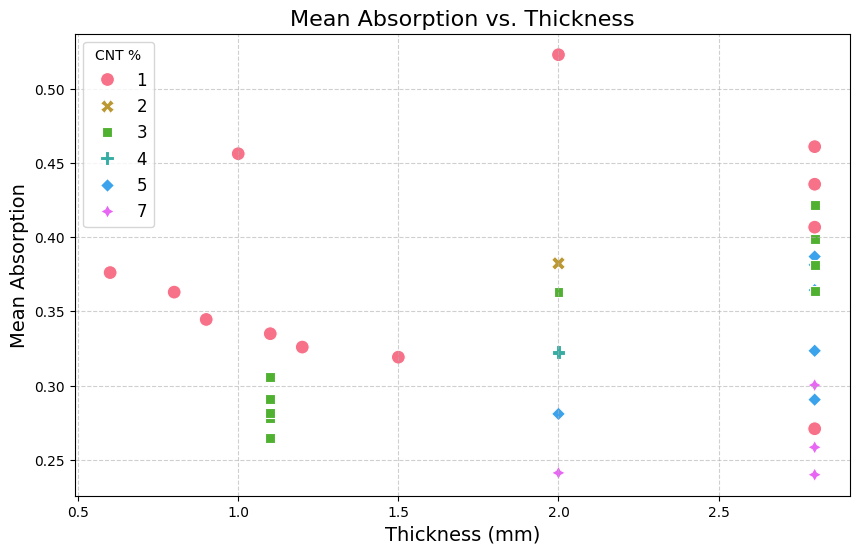

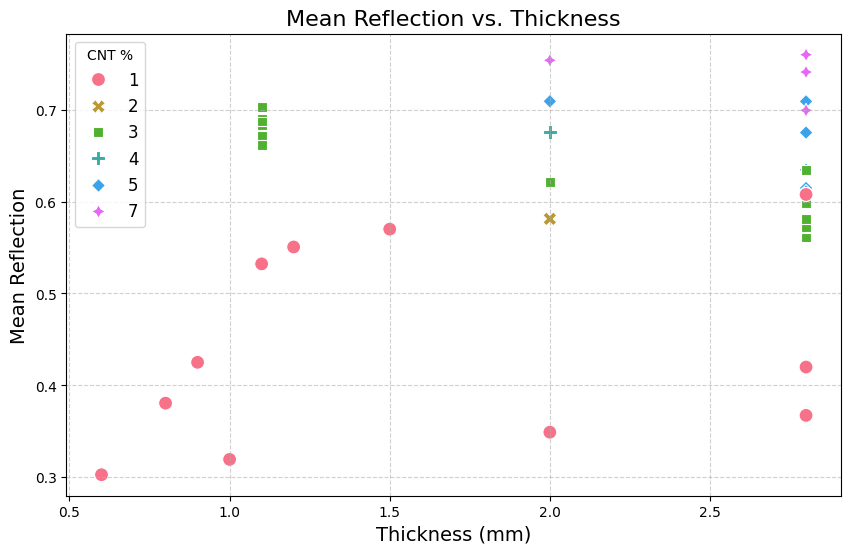

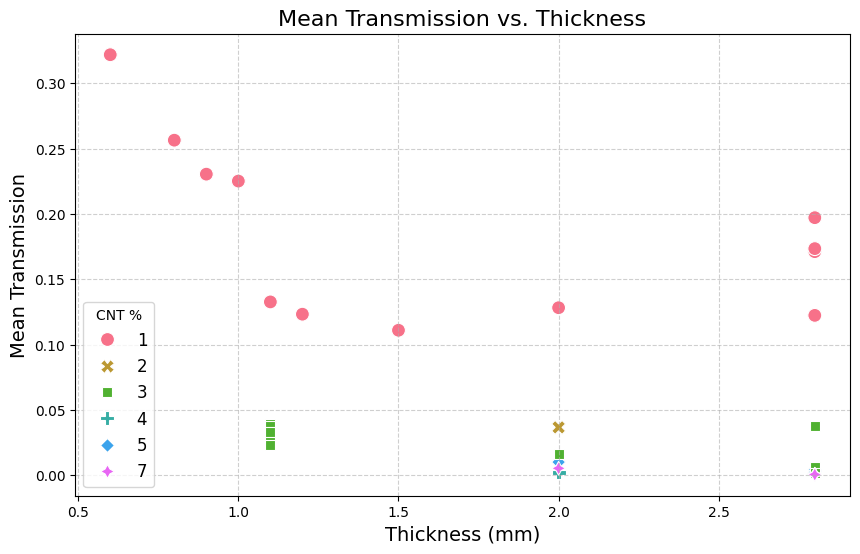

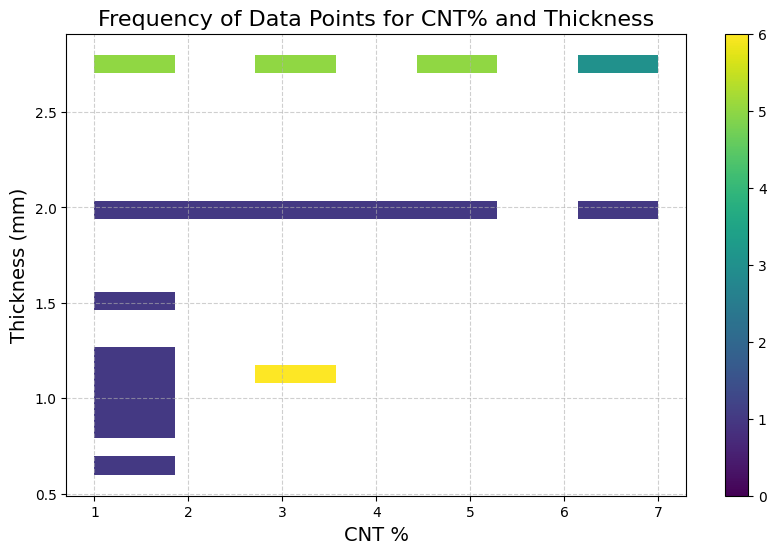

In [ ]:
def plot_targets_by_thickness(df):
    """
    Plot mean absorption, reflection, and transmission as functions of thickness,
    with CNT% as different colors, and add a histogram showing the frequency
    of data points for each CNT% and thickness combination.

    Parameters:
    - df (pd.DataFrame): DataFrame containing 'thickness', 'cnt_pct', 'mean_a', 'mean_r', 'mean_t'
    """
    # Define target variables and titles
    targets = {'mean_a': 'Mean Absorption', 'mean_r': 'Mean Reflection', 'mean_t': 'Mean Transmission'}
    colors = sns.color_palette("husl", len(df['cnt_pct'].unique()))

    # Create scatter plots for each target variable
    for target, title in targets.items():
        plt.figure(figsize=(10, 6))
        sns.scatterplot(
            data=df,
            x="thickness",
            y=target,
            hue="cnt_pct",
            palette=colors,
            style="cnt_pct",
            s=100
        )
        plt.title(f'{title} vs. Thickness', fontsize=16)
        plt.xlabel('Thickness (mm)', fontsize=14)
        plt.ylabel(title, fontsize=14)
        plt.legend(title='CNT %', fontsize=12)
        plt.grid(True, linestyle='--', alpha=0.6)
        plt.show()

    # **New Plot: Histogram of data point frequencies for CNT% and Thickness**
    plt.figure(figsize=(10, 6))
    sns.histplot(
        data=df,
        y="thickness",
        x="cnt_pct",
        bins=[7, 23],  # 8 thickness bins (0.6mm-2.8mm), 7 CNT% bins (1%-7%)
        cbar=True,
        cmap="viridis"
    )
    plt.title('Frequency of Data Points for CNT% and Thickness', fontsize=16)
    plt.ylabel('Thickness (mm)', fontsize=14)
    plt.xlabel('CNT %', fontsize=14)
    plt.grid(True, linestyle='--', alpha=0.6)
    plt.show()

# Call the function
plot_targets_by_thickness(thesis_df)


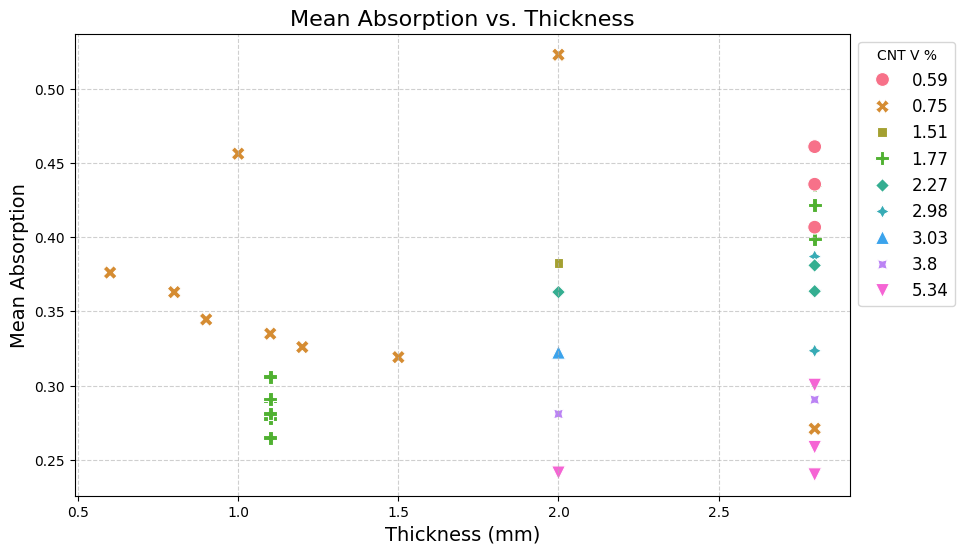

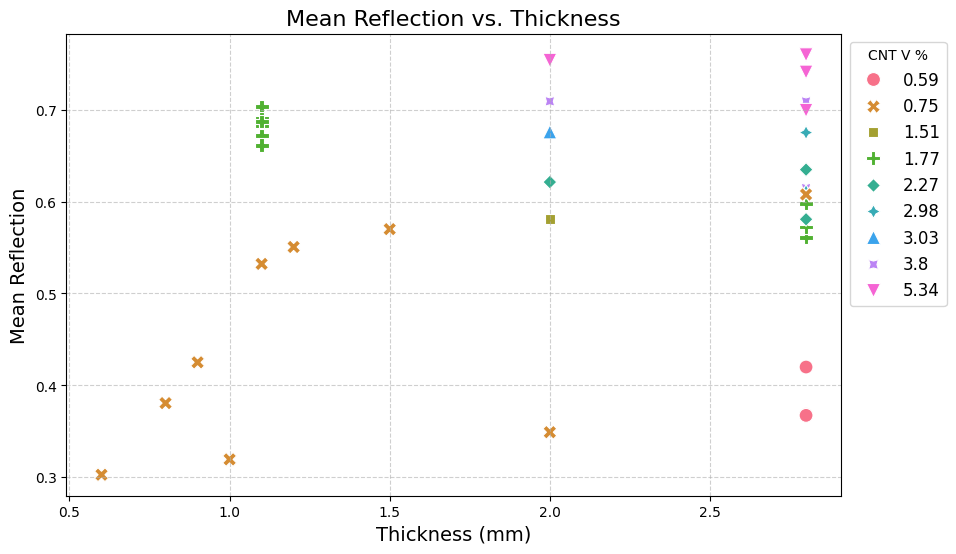

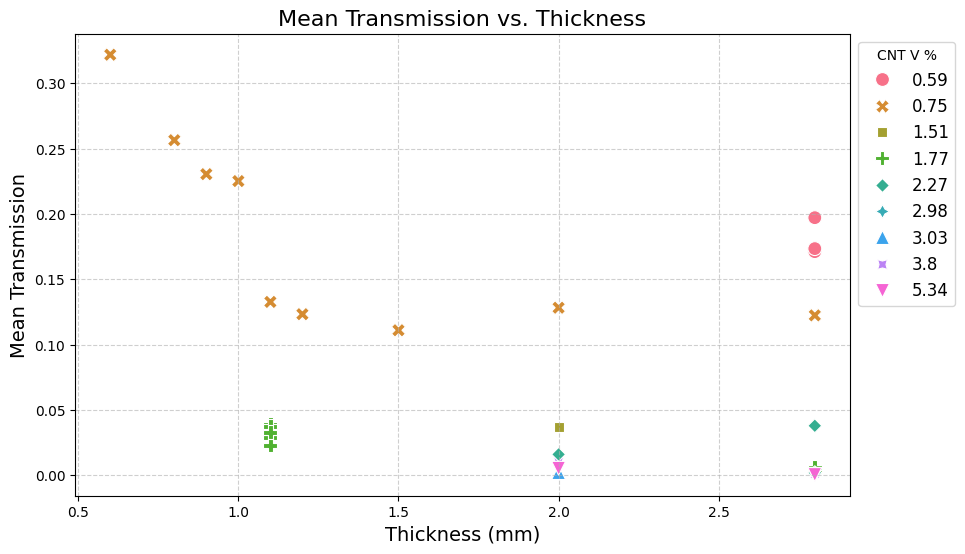

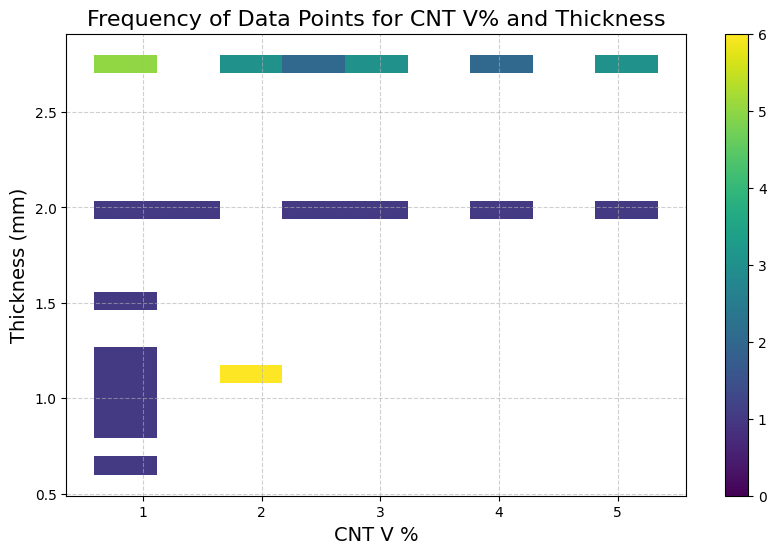

In [ ]:
def plot_targets_by_thickness(df):
    """
    Plot mean absorption, reflection, and transmission as functions of thickness,
    with CNT% as different colors, and add a histogram showing the frequency
    of data points for each CNT% and thickness combination.

    Parameters:
    - df (pd.DataFrame): DataFrame containing 'thickness', 'cnt_pct', 'mean_a', 'mean_r', 'mean_t'
    """
    # Round `v-cnt_pct` to 2 decimal places for better readability
    df['v_cnt_pct_rounded'] = df['v_cnt_pct'].round(2)  # Convert to string for clean legend

    # **Sort the labels in ascending order**
    sorted_labels = sorted(df['v_cnt_pct_rounded'].unique(), key=float)  # Convert to float for proper sorting

    # Define target variables and titles
    targets = {'mean_a': 'Mean Absorption', 'mean_r': 'Mean Reflection', 'mean_t': 'Mean Transmission'}
    colors = sns.color_palette("husl", len(sorted_labels))

    # Create scatter plots for each target variable
    for target, title in targets.items():
        plt.figure(figsize=(10, 6))
        sns.scatterplot(
            data=df,
            x="thickness",
            y=target,
            hue="v_cnt_pct_rounded",
            hue_order=sorted_labels,  # Ensure legend is in ascending order
            palette=colors,
            style="v_cnt_pct_rounded",
            s=100
        )
        plt.title(f'{title} vs. Thickness', fontsize=16)
        plt.xlabel('Thickness (mm)', fontsize=14)
        plt.ylabel(title, fontsize=14)
        plt.legend(title='CNT V %', fontsize=12, loc='upper left', bbox_to_anchor=(1, 1))
        plt.grid(True, linestyle='--', alpha=0.6)
        plt.show()

    # **New Plot: Histogram of data point frequencies for CNT% and Thickness**
    plt.figure(figsize=(10, 6))
    sns.histplot(
        data=df,
        y="thickness",
        x="v_cnt_pct_rounded",
        bins=[np.linspace(min(sorted_labels), max(sorted_labels), len(sorted_labels) + 1), 23],  # Ensuring CNT% bin edges match actual values
        cbar=True,
        cmap="viridis"
    )
    plt.title('Frequency of Data Points for CNT V% and Thickness', fontsize=16)
    plt.ylabel('Thickness (mm)', fontsize=14)
    plt.xlabel('CNT V %', fontsize=14)
    plt.grid(True, linestyle='--', alpha=0.6)
    plt.show()

# Call the function
plot_targets_by_thickness(thesis_df)


## Predicting Material Properties from Frequency, CNT, Thickness, and Material

GPR samples

In [ ]:
material_df

,frequency,epsilon_real,epsilon_imag,mu_real,mu_imag,cnt_pct,material,thickness
0,1.240000e+10,12.70,6.38,1.0,0.00E+00,4,PBT,2.0
1,1.245657e+10,12.40,6.13,1.0,0.00E+00,4,PBT,2.0
2,1.251313e+10,12.60,6.13,1.0,0.00E+00,4,PBT,2.0
3,1.256970e+10,12.40,5.99,1.0,0.00E+00,4,PBT,2.0
4,1.262626e+10,12.60,6.19,1.0,0.00E+00,4,PBT,2.0
...,...,...,...,...,...,...,...,...
3754,1.777374e+10,6.17,4.59,1.0,0.00E+00,2,PBT,2.0
3755,1.783030e+10,6.15,4.74,1.0,0.00E+00,2,PBT,2.0
3756,1.788687e+10,6.17,4.53,1.0,0.00E+00,2,PBT,2.0
3757,1.794343e+10,6.09,4.63,1.0,0.00E+00,2,PBT,2.0


Training GPR for epsilon_real...
Training GPR for epsilon_imag...


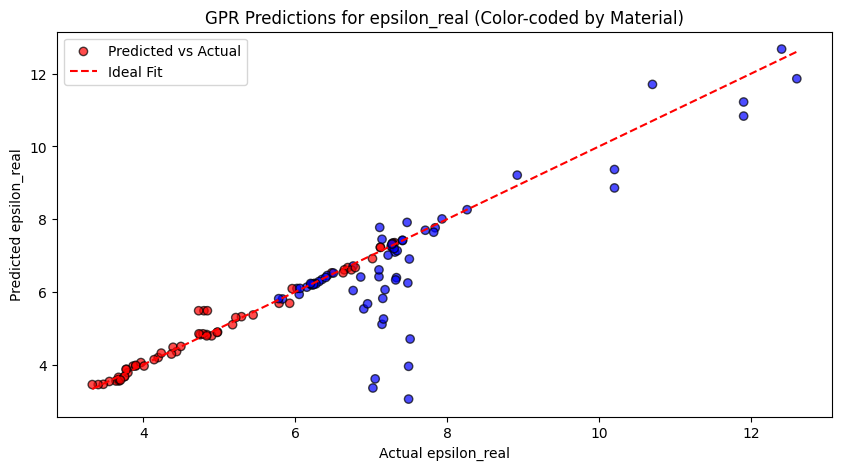

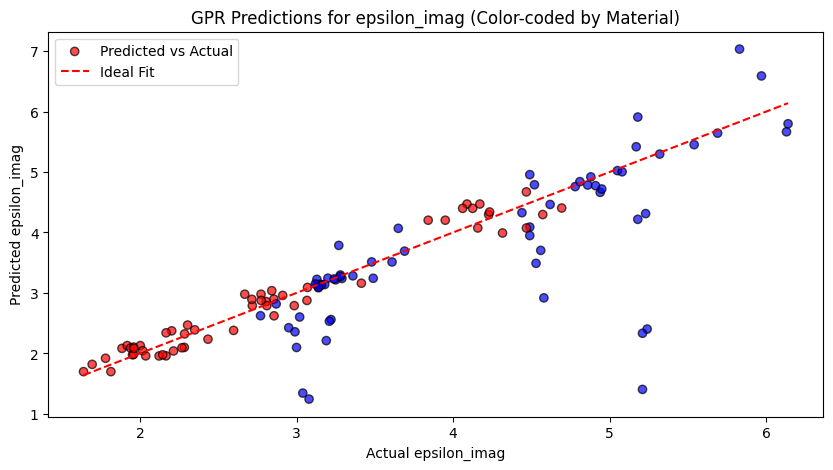

Kernel used for GPR (epsilon_real): 4.78**2 * RBF(length_scale=0.0522)
Kernel used for GPR (epsilon_imag): 2.8**2 * RBF(length_scale=0.0488)


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.gaussian_process.kernels import RBF, ConstantKernel as C
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.pipeline import Pipeline

# Load data (assuming material_df is already loaded)
df = material_df.copy()

# Select 4 unique combinations of (cnt_pct, material, thickness)
selected_combos = df.groupby(['cnt_pct', 'material', 'thickness']).size().reset_index().sample(4)
filtered_df = df.merge(selected_combos[['cnt_pct', 'material', 'thickness']], on=['cnt_pct', 'material', 'thickness'])

# Encode 'material' as a categorical feature
encoder = OneHotEncoder(sparse_output=False, drop='first')
material_encoded = encoder.fit_transform(filtered_df[['material']])
material_columns = encoder.get_feature_names_out(['material'])

# Store material labels for coloring later
material_labels = filtered_df['material'].values

# Prepare feature matrix (X) and target values (y)
X = np.column_stack((
    filtered_df[['cnt_pct', 'thickness', 'frequency']].values,
    material_encoded
))
y_real = filtered_df['epsilon_real'].values
y_imag = filtered_df['epsilon_imag'].values

# Split into training and testing sets (80% train, 20% test)
X_train, X_test, y_real_train, y_real_test, mat_train, mat_test = train_test_split(
    X, y_real, material_labels, test_size=0.2, random_state=42
)
_, _, y_imag_train, y_imag_test, _, _ = train_test_split(X, y_imag, material_labels, test_size=0.2, random_state=42)

# Normalize features (important for GPR)
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Define a Gaussian Process model with RBF kernel
kernel = C(1.0, (1e-2, 1e2)) * RBF(length_scale=1.0, length_scale_bounds=(1e-2, 1e2))
gpr_real = GaussianProcessRegressor(kernel=kernel, n_restarts_optimizer=5, alpha=1e-6)
gpr_imag = GaussianProcessRegressor(kernel=kernel, n_restarts_optimizer=5, alpha=1e-6)

# Train GPR models
print("Training GPR for epsilon_real...")
gpr_real.fit(X_train_scaled, y_real_train)
print("Training GPR for epsilon_imag...")
gpr_imag.fit(X_train_scaled, y_imag_train)

# Predictions
y_real_pred, _ = gpr_real.predict(X_test_scaled, return_std=True)
y_imag_pred, _ = gpr_imag.predict(X_test_scaled, return_std=True)

# Color mapping for materials
color_map = {'PBT': 'blue', 'ABS': 'red'}
colors_test = [color_map[m] for m in mat_test]

# Plot results for epsilon_real with color coding
plt.figure(figsize=(10, 5))
plt.scatter(y_real_test, y_real_pred, c=colors_test, label="Predicted vs Actual", alpha=0.7, edgecolors='k')
plt.plot([min(y_real_test), max(y_real_test)], [min(y_real_test), max(y_real_test)], 'r--', label="Ideal Fit")
plt.xlabel("Actual epsilon_real")
plt.ylabel("Predicted epsilon_real")
plt.title("GPR Predictions for epsilon_real (Color-coded by Material)")
plt.legend()
plt.show()

# Plot results for epsilon_imag with color coding
plt.figure(figsize=(10, 5))
plt.scatter(y_imag_test, y_imag_pred, c=colors_test, label="Predicted vs Actual", alpha=0.7, edgecolors='k')
plt.plot([min(y_imag_test), max(y_imag_test)], [min(y_imag_test), max(y_imag_test)], 'r--', label="Ideal Fit")
plt.xlabel("Actual epsilon_imag")
plt.ylabel("Predicted epsilon_imag")
plt.title("GPR Predictions for epsilon_imag (Color-coded by Material)")
plt.legend()
plt.show()

# Print model performance
print(f"Kernel used for GPR (epsilon_real): {gpr_real.kernel_}")
print(f"Kernel used for GPR (epsilon_imag): {gpr_imag.kernel_}")


Total unique samples: 21 (ABS + PBT)
Identified 22 unique PBT samples.

Training GPR for epsilon_real (PBT) with 2200 samples...
Training GPR for epsilon_imag (PBT) with 2200 samples...


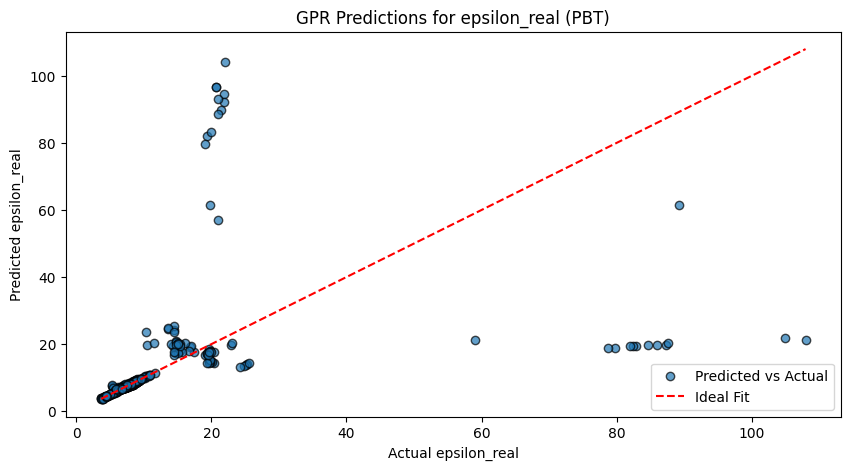

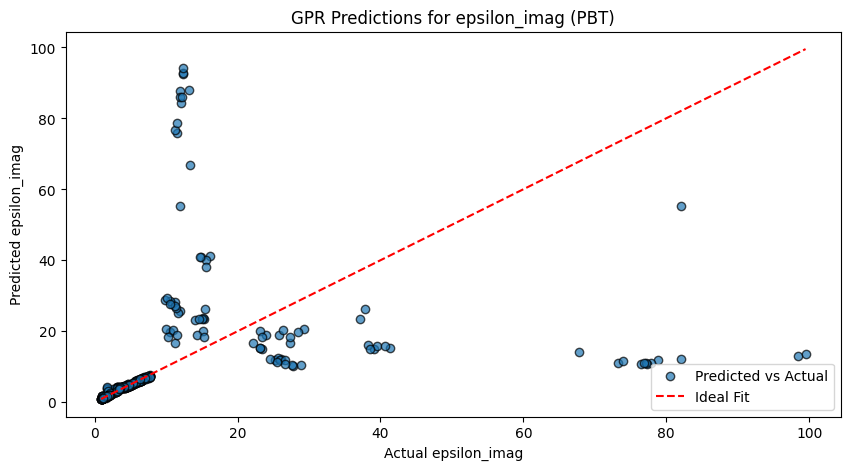

Kernel used for GPR (epsilon_real) - PBT: 10**2 * RationalQuadratic(alpha=0.038, length_scale=0.01)
Kernel used for GPR (epsilon_imag) - PBT: 10**2 * RationalQuadratic(alpha=0.0164, length_scale=0.01)
Total unique samples: 21 (ABS + PBT)
Identified 15 unique ABS samples.

Training GPR for epsilon_real (ABS) with 1500 samples...
Training GPR for epsilon_imag (ABS) with 1500 samples...


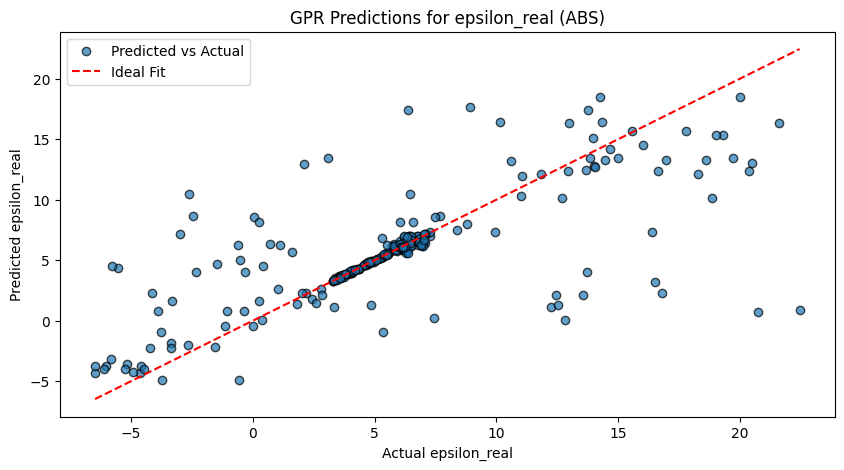

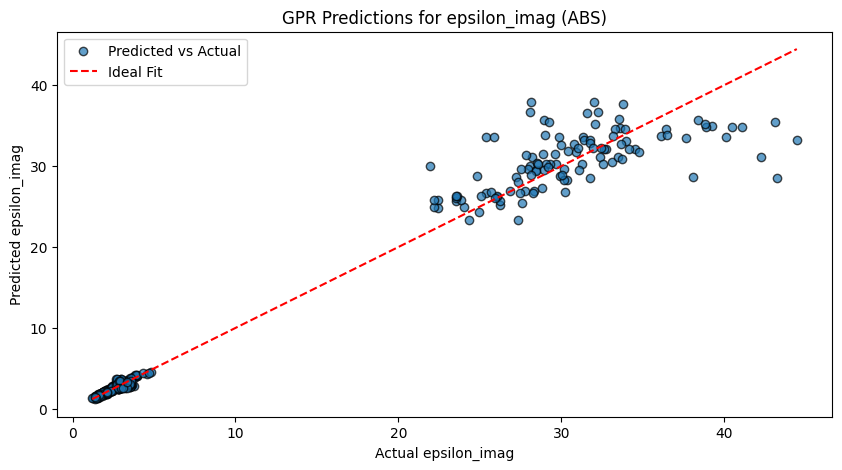

Kernel used for GPR (epsilon_real) - ABS: 5.54**2 * RationalQuadratic(alpha=0.00682, length_scale=0.0108)
Kernel used for GPR (epsilon_imag) - ABS: 5.55**2 * RationalQuadratic(alpha=0.052, length_scale=0.0628)


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.gaussian_process.kernels import RationalQuadratic, ConstantKernel as C
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

def train_gpr_model(df, material_name):
    """
    Trains a GPR model for a given material using all valid samples for that material.

    Parameters:
        df: DataFrame containing data for both ABS and PBT
        material_name: String indicating whether training is for "ABS" or "PBT"

    Returns:
        Trained GPR models (for epsilon_real and epsilon_imag) and the scaler
    """

    # Step 1: Extract Unique CNT%, Thickness, and Material Combinations
    unique_samples = df[['cnt_pct', 'thickness', 'material']].drop_duplicates()
    print(f"Total unique samples: {len(unique_samples)} (ABS + PBT)")

    # Step 2: Keep only rows where the material matches the training material
    df_material = df[df['material'] == material_name]

    # Step 3: Ensure we have the correct number of samples for this material
    num_samples = df_material.shape[0] // 100  # Assuming 100 frequency points per sample
    print(f"Identified {num_samples} unique {material_name} samples.")

    # Step 4: Prepare Features and Targets
    X = df_material[['cnt_pct', 'thickness', 'frequency']].values
    y_real = df_material['epsilon_real'].values
    y_imag = df_material['epsilon_imag'].values

    # Step 5: Split into Training and Testing Sets
    X_train, X_test, y_real_train, y_real_test = train_test_split(X, y_real, test_size=0.2, random_state=42)
    _, _, y_imag_train, y_imag_test = train_test_split(X, y_imag, test_size=0.2, random_state=42)

    # Step 6: Normalize Features
    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)

    # Step 7: Define Gaussian Process Model with Rational Quadratic Kernel
    kernel = C(1.0, (1e-2, 1e2)) * RationalQuadratic(length_scale=1.0, alpha=1.0, length_scale_bounds=(1e-2, 1e2))
    gpr_real = GaussianProcessRegressor(kernel=kernel, n_restarts_optimizer=5, alpha=1e-6)
    gpr_imag = GaussianProcessRegressor(kernel=kernel, n_restarts_optimizer=5, alpha=1e-6)

    # Step 8: Train GPR Models
    print(f"\nTraining GPR for epsilon_real ({material_name}) with {df_material.shape[0]} samples...")
    gpr_real.fit(X_train_scaled, y_real_train)
    print(f"Training GPR for epsilon_imag ({material_name}) with {df_material.shape[0]} samples...")
    gpr_imag.fit(X_train_scaled, y_imag_train)

    # Step 9: Predictions and Plotting
    y_real_pred, _ = gpr_real.predict(X_test_scaled, return_std=True)
    y_imag_pred, _ = gpr_imag.predict(X_test_scaled, return_std=True)

    # Plot results for epsilon_real
    plt.figure(figsize=(10, 5))
    plt.scatter(y_real_test, y_real_pred, label="Predicted vs Actual", alpha=0.7, edgecolors='k')
    plt.plot([min(y_real_test), max(y_real_test)], [min(y_real_test), max(y_real_test)], 'r--', label="Ideal Fit")
    plt.xlabel("Actual epsilon_real")
    plt.ylabel("Predicted epsilon_real")
    plt.title(f"GPR Predictions for epsilon_real ({material_name})")
    plt.legend()
    plt.show()

    # Plot results for epsilon_imag
    plt.figure(figsize=(10, 5))
    plt.scatter(y_imag_test, y_imag_pred, label="Predicted vs Actual", alpha=0.7, edgecolors='k')
    plt.plot([min(y_imag_test), max(y_imag_test)], [min(y_imag_test), max(y_imag_test)], 'r--', label="Ideal Fit")
    plt.xlabel("Actual epsilon_imag")
    plt.ylabel("Predicted epsilon_imag")
    plt.title(f"GPR Predictions for epsilon_imag ({material_name})")
    plt.legend()
    plt.show()

    # Print Model Performance
    print(f"Kernel used for GPR (epsilon_real) - {material_name}: {gpr_real.kernel_}")
    print(f"Kernel used for GPR (epsilon_imag) - {material_name}: {gpr_imag.kernel_}")

    return gpr_real, gpr_imag, scaler

# Train models for PBT and ABS using ALL valid samples for each material
gpr_real_pbt, gpr_imag_pbt, scaler_pbt = train_gpr_model(material_df, "PBT")
gpr_real_abs, gpr_imag_abs, scaler_abs = train_gpr_model(material_df, "ABS")


Save and Load

In [ ]:
!pip install joblib
import os
import joblib
from datetime import datetime

def save_gpr_model(model_real, model_imag, scaler, material_name, base_path='/content/drive/MyDrive/Thesis_Updated/Models/MaterialProperties'):
    """
    Saves the GPR real & imag models and scaler with timestamped filename into the specified Google Drive folder.
    """
    timestamp = datetime.now().strftime("%Y%m%d_%H%M%S")
    filename = f"{material_name}_GPR_Model_{timestamp}.pkl"
    save_path = os.path.join(base_path, filename)

    # Bundle everything into a dict
    model_data = {
        'gpr_real': model_real,
        'gpr_imag': model_imag,
        'scaler': scaler,
        'material': material_name,
        'timestamp': timestamp
    }

    # Ensure the directory exists
    os.makedirs(base_path, exist_ok=True)

    # Save using joblib
    joblib.dump(model_data, save_path)
    print(f"✅ GPR model for {material_name} saved to: {save_path}")

def load_gpr_model(filepath):
    """
    Loads a saved GPR model from the given filepath.
    Returns: gpr_real, gpr_imag, scaler, metadata
    """
    if not os.path.exists(filepath):
        raise FileNotFoundError(f"❌ File not found: {filepath}")

    model_data = joblib.load(filepath)
    print(f"✅ Loaded model from: {filepath}")
    return model_data['gpr_real'], model_data['gpr_imag'], model_data['scaler'], model_data


In [ ]:
# After training
save_gpr_model(gpr_real_abs, gpr_imag_abs, scaler_abs, material_name="ABS")
save_gpr_model(gpr_real_pbt, gpr_imag_pbt, scaler_pbt, material_name="PBT")


✅ GPR model for ABS saved to: /content/drive/MyDrive/Thesis_Updated/Models/MaterialProperties/ABS_GPR_Model_20250324_193537.pkl
✅ GPR model for PBT saved to: /content/drive/MyDrive/Thesis_Updated/Models/MaterialProperties/PBT_GPR_Model_20250324_193537.pkl


In [7]:
import os
import glob
import joblib

def load_latest_gpr_model(material_name, folder_path='/content/drive/MyDrive/Thesis_Updated/Models/MaterialProperties'):
    """
    Loads the most recently saved GPR model for the specified material from the given folder.

    Parameters:
        material_name: 'ABS' or 'PBT'
        folder_path: Path to the directory containing the model files

    Returns:
        gpr_real, gpr_imag, scaler, metadata
    """
    # Search for all matching model files
    pattern = os.path.join(folder_path, f"{material_name}_GPR_Model_*.pkl")
    model_files = glob.glob(pattern)

    if not model_files:
        raise FileNotFoundError(f"No model files found for {material_name} in {folder_path}")

    # Get the most recently modified file
    latest_model = max(model_files, key=os.path.getmtime)
    print(f"✅ Loading latest {material_name} model: {os.path.basename(latest_model)}")

    model_data = joblib.load(latest_model)
    return model_data['gpr_real'], model_data['gpr_imag'], model_data['scaler'], model_data
# Load latest ABS and PBT models automatically
gpr_real_abs, gpr_imag_abs, scaler_abs, meta_abs = load_latest_gpr_model("ABS")
gpr_real_pbt, gpr_imag_pbt, scaler_pbt, meta_pbt = load_latest_gpr_model("PBT")


✅ Loading latest ABS model: ABS_GPR_Model_20250324_224420.pkl
✅ Loading latest PBT model: PBT_GPR_Model_20250324_224420.pkl


training data overlayed


In [64]:
from mpl_toolkits.mplot3d import Axes3D

def plot_gpr_3d_fixed(gpr_model, scaler, feature_name, title, cnt_pct=3.0, training_df=None):
    """
    Plots a 3D surface for a trained GPR model, optionally with training data overlay.

    Parameters:
        gpr_model: Trained GPR model
        scaler: StandardScaler used during training
        feature_name: 'epsilon_real' or 'epsilon_imag'
        title: Title for the 3D plot
        cnt_pct: CNT percentage value to plot
        training_df: (optional) DataFrame containing the training data (cnt_pct, thickness, frequency, epsilon_*)
    """
    # Define frequency and thickness ranges
    freq_range = np.linspace(12.4e9, 18e9, 50)
    thickness_range = np.linspace(0.6, 2.8, 50)

    # Create grid for prediction
    FREQ, THICK = np.meshgrid(freq_range, thickness_range)
    X_pred = np.column_stack((np.full(FREQ.ravel().shape, cnt_pct), THICK.ravel(), FREQ.ravel()))
    X_pred_scaled = scaler.transform(X_pred)

    # Predict with GPR
    Y_pred = gpr_model.predict(X_pred_scaled).reshape(FREQ.shape)

    # Begin plotting
    fig = plt.figure(figsize=(10, 6))
    ax = fig.add_subplot(111, projection='3d')

    # Surface
    surf = ax.plot_surface(FREQ / 1e9, THICK, Y_pred, cmap='viridis', edgecolor='k', alpha=0.7)

    # Overlay training data
    if training_df is not None:
        # Filter to match CNT%
        df_overlay = training_df[np.isclose(training_df['cnt_pct'], cnt_pct)]

        # Plot scatter points
        ax.scatter(
            df_overlay['frequency'] / 1e9,
            df_overlay['thickness'],
            df_overlay[feature_name],
            color='r',
            label='Training Data',
            s=8,
            alpha=0.6
        )

        # Optional: connect along frequency with a faint line for each thickness slice
        for thickness in df_overlay['thickness'].unique():
            subset = df_overlay[df_overlay['thickness'] == thickness].sort_values(by='frequency')
            ax.plot(
                subset['frequency'] / 1e9,
                np.full_like(subset['frequency'], thickness),
                subset[feature_name],
                color='r',
                linestyle='dotted',
                linewidth=0.5,
                alpha=0.6
            )

    # Labels
    ax.set_xlabel("Frequency (GHz)")
    ax.set_ylabel("Thickness (mm)")
    ax.set_zlabel(feature_name)
    ax.set_title(title)
    fig.colorbar(surf, shrink=0.5, aspect=5)

    plt.legend(loc='upper left')
    plt.show()


In [67]:
# from mpl_toolkits.mplot3d import Axes3D
# import matplotlib.pyplot as plt
# import numpy as np

# def plot_gpr_3d_fixed_with_data(gpr_model, scaler, feature_name, title, data_df, cnt_pct=3.0):
#     """
#     Plots a 3D surface for a trained GPR model with real data points overlay.

#     Parameters:
#         gpr_model: Trained GPR model
#         scaler: StandardScaler used in training
#         feature_name: The name of the feature being predicted ('epsilon_real' or 'epsilon_imag')
#         title: The plot title
#         data_df: DataFrame with real data (columns: 'CNT%', 'Thickness', 'Frequency', 'epsilon_real', 'epsilon_imag')
#         cnt_pct: Fixed CNT percentage (default: 3.0%)
#     """
#     # Define prediction grid
#     freq_range = np.linspace(12.4e9, 18e9, 50)
#     thickness_range = np.linspace(0.6, 2.8, 50)

#     FREQ, THICK = np.meshgrid(freq_range, thickness_range)

#     X_pred = np.column_stack((np.full(FREQ.ravel().shape, cnt_pct), THICK.ravel(), FREQ.ravel()))
#     X_pred_scaled = scaler.transform(X_pred)
#     Y_pred = gpr_model.predict(X_pred_scaled).reshape(FREQ.shape)

#     fig = plt.figure(figsize=(10, 6))
#     ax = fig.add_subplot(111, projection='3d')

#     # Plot surface
#     surf = ax.plot_surface(FREQ / 1e9, THICK, Y_pred, cmap='viridis', edgecolor='k', alpha=0.7)

#     # Overlay real data points (filtered by CNT%)
#     filtered_df = data_df[data_df['CNT%'] == cnt_pct]

#     ax.scatter(
#         filtered_df['Frequency'] / 1e9,  # Convert Hz to GHz for consistency
#         filtered_df['Thickness'],
#         filtered_df[feature_name],
#         c='red',
#         label='Real Data Points',
#         s=50
#     )

#     ax.set_xlabel("Frequency (GHz)")
#     ax.set_ylabel("Thickness (mm)")
#     ax.set_zlabel(feature_name)
#     ax.set_title(title)
#     ax.legend()
#     fig.colorbar(surf, shrink=0.5, aspect=5)

#     plt.show()


In [62]:
material_df

,frequency,epsilon_real,epsilon_imag,mu_real,mu_imag,cnt_pct,material,thickness
0,1.240000e+10,12.70,6.38,1.0,0.00E+00,4,PBT,2.0
1,1.245657e+10,12.40,6.13,1.0,0.00E+00,4,PBT,2.0
2,1.251313e+10,12.60,6.13,1.0,0.00E+00,4,PBT,2.0
3,1.256970e+10,12.40,5.99,1.0,0.00E+00,4,PBT,2.0
4,1.262626e+10,12.60,6.19,1.0,0.00E+00,4,PBT,2.0
...,...,...,...,...,...,...,...,...
3754,1.777374e+10,6.17,4.59,1.0,0.00E+00,2,PBT,2.0
3755,1.783030e+10,6.15,4.74,1.0,0.00E+00,2,PBT,2.0
3756,1.788687e+10,6.17,4.53,1.0,0.00E+00,2,PBT,2.0
3757,1.794343e+10,6.09,4.63,1.0,0.00E+00,2,PBT,2.0


In [8]:
df_abs_train = material_df[material_df['material'] == 'ABS']
df_pbt_train = material_df[material_df['material'] == 'PBT']



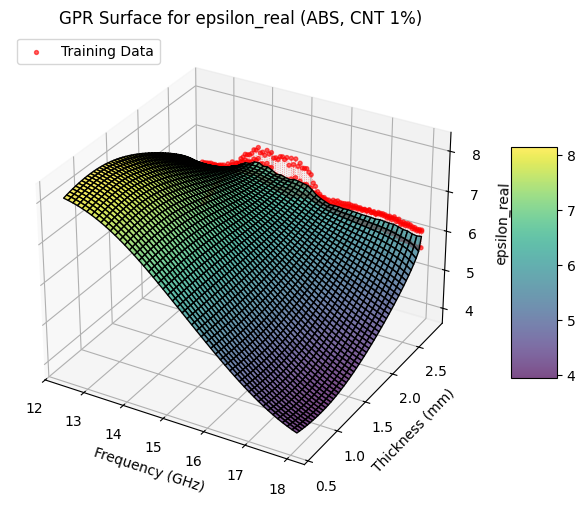

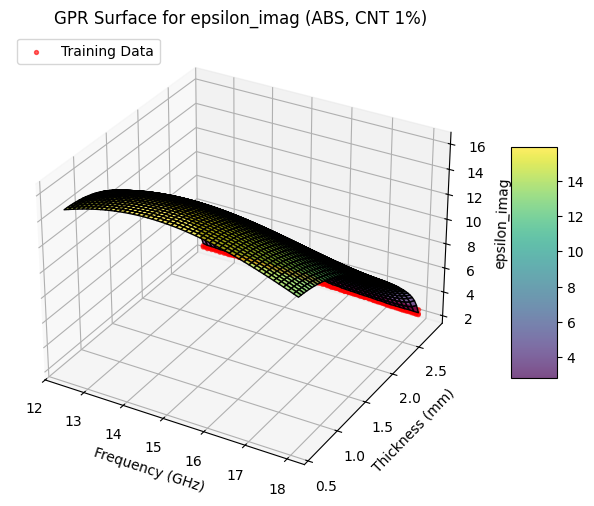

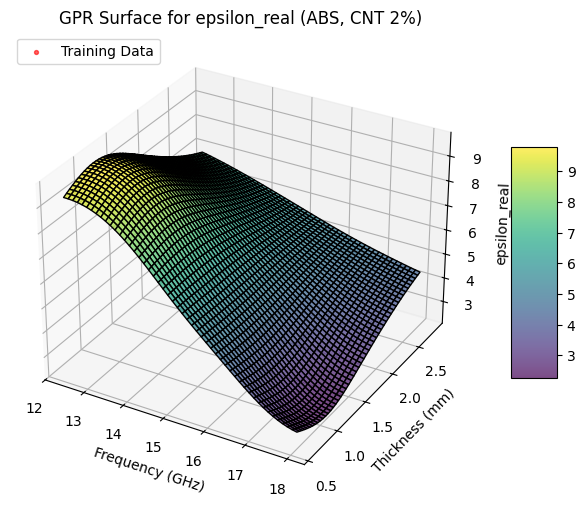

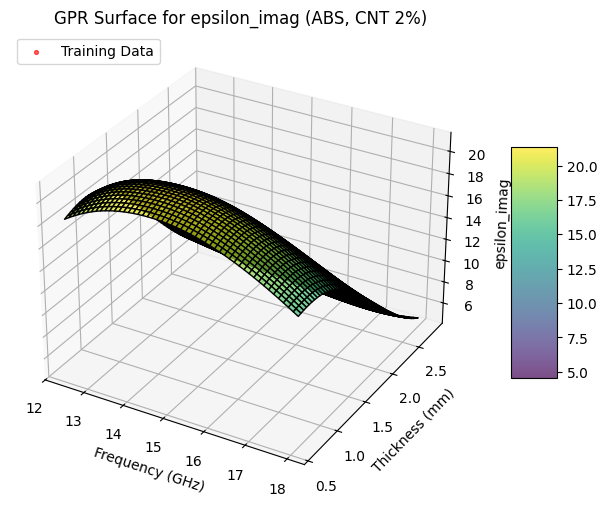

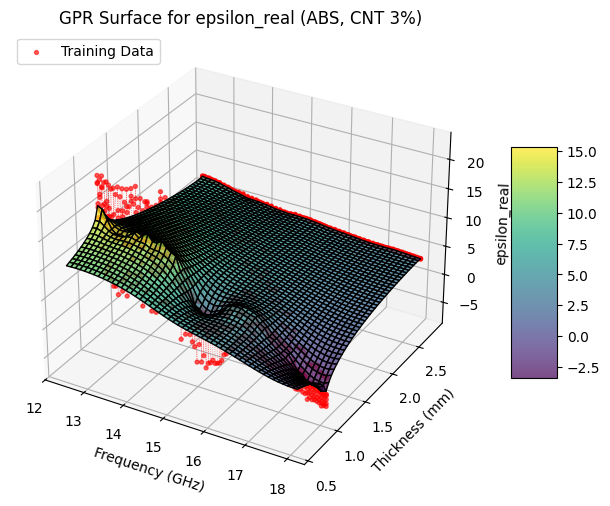

...

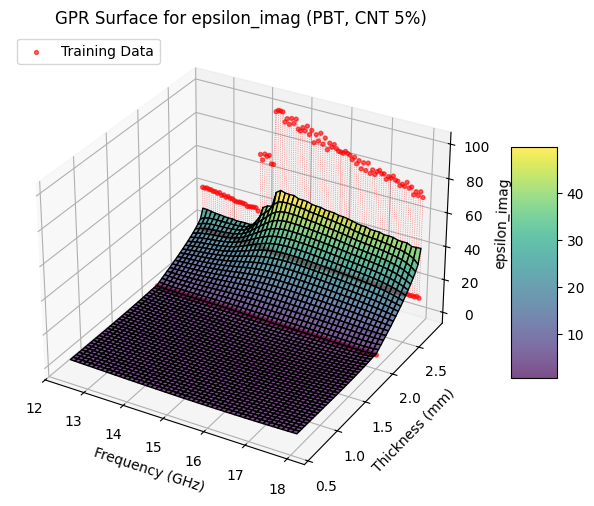

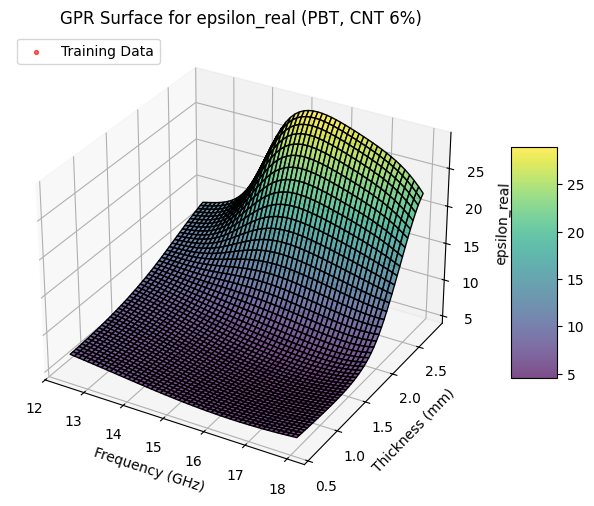

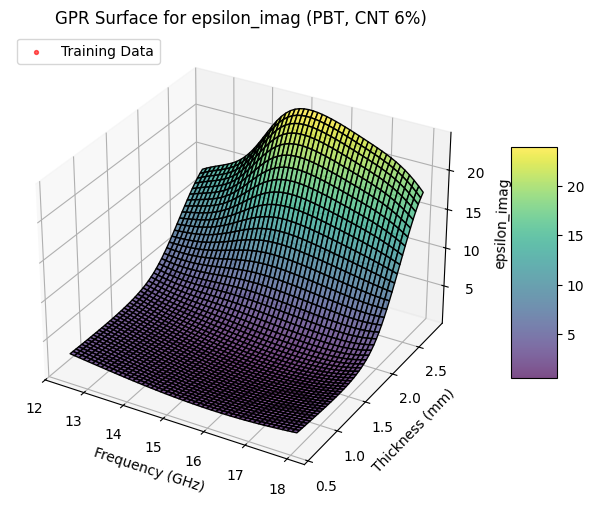

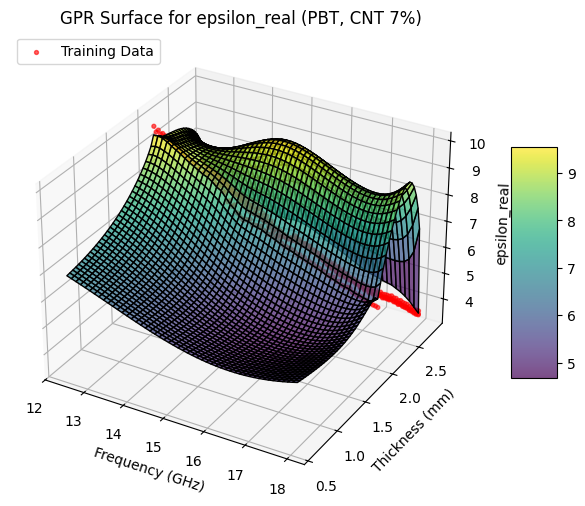

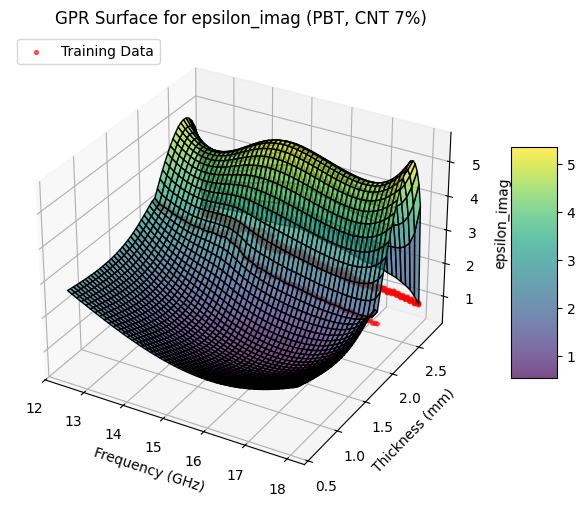

In [69]:
for cnt in range(1, 8):
    plot_gpr_3d_fixed(gpr_real_abs, scaler_abs, "epsilon_real", f"GPR Surface for epsilon_real (ABS, CNT {cnt}%)", cnt_pct=cnt, training_df=df_abs_train)
    plot_gpr_3d_fixed(gpr_imag_abs, scaler_abs, "epsilon_imag", f"GPR Surface for epsilon_imag (ABS, CNT {cnt}%)", cnt_pct=cnt, training_df=df_abs_train)

for cnt in range(1, 8):
    plot_gpr_3d_fixed(gpr_real_pbt, scaler_pbt, "epsilon_real", f"GPR Surface for epsilon_real (PBT, CNT {cnt}%)", cnt_pct=cnt, training_df=df_pbt_train)
    plot_gpr_3d_fixed(gpr_imag_pbt, scaler_pbt, "epsilon_imag", f"GPR Surface for epsilon_imag (PBT, CNT {cnt}%)", cnt_pct=cnt, training_df=df_pbt_train)


In [13]:
import numpy as np
from sklearn.metrics import mean_squared_error

def evaluate_gpr_model(gpr_model, scaler, data_df, target_col, physical_bounds, extended_bounds, resolution=30):
    """
    Evaluate GPR model over physical and extended regions.

    Parameters:
    - gpr_model: Trained GPR model
    - scaler: Scaler used for training
    - data_df: DataFrame with real data
    - target_col: Column name of target feature (epsilon_real or epsilon_imag)
    - physical_bounds: ((cnt_min, cnt_max), (thickness_min, thickness_max))
    - extended_bounds: ((cnt_min, cnt_max), (thickness_min, thickness_max))
    - resolution: Number of points for grid generation

    Returns:
    - results: Dictionary with losses and uncertainties
    """
    results = {}

    # ---------- Physical Region ----------
    df_phys = data_df[
        (data_df['cnt_pct'] >= physical_bounds[0][0]) & (data_df['cnt_pct'] <= physical_bounds[0][1]) &
        (data_df['thickness'] >= physical_bounds[1][0]) & (data_df['thickness'] <= physical_bounds[1][1])
    ]

    X_phys = df_phys[['cnt_pct', 'thickness', 'frequency']].values
    X_phys_scaled = scaler.transform(X_phys)
    y_phys_true = df_phys[target_col].values
    y_phys_pred, y_phys_std = gpr_model.predict(X_phys_scaled, return_std=True)

    results['physical_loss'] = mean_squared_error(y_phys_true, y_phys_pred)
    results['physical_uncertainty'] = np.mean(y_phys_std)

    # ---------- Extended Region ----------
    cnt_min, cnt_max = extended_bounds[0]
    thick_min, thick_max = extended_bounds[1]
    freq_min, freq_max = data_df['frequency'].min(), data_df['frequency'].max()

    cnt_grid = np.linspace(cnt_min, cnt_max, resolution)
    thick_grid = np.linspace(thick_min, thick_max, resolution)
    freq_grid = np.linspace(freq_min, freq_max, resolution)

    CNT_mesh, THICK_mesh, FREQ_mesh = np.meshgrid(cnt_grid, thick_grid, freq_grid)

    X_ext = np.c_[CNT_mesh.ravel(), THICK_mesh.ravel(), FREQ_mesh.ravel()]
    X_ext_scaled = scaler.transform(X_ext)

    y_ext_pred, y_ext_std = gpr_model.predict(X_ext_scaled, return_std=True)

    results['extended_uncertainty'] = np.mean(y_ext_std)

    return results

physical_bounds = ((1.0, 7.0), (0.6, 2.8))   # CNT%, Thickness (Training Range)
extended_bounds = ((0.0, 10.0), (0.0, 5.0))  # Larger range for Extrapolation test

# For ABS Material and epsilon_real
results_abs_real = evaluate_gpr_model(
    gpr_model=gpr_real_abs,
    scaler=scaler_abs,
    data_df=df_abs_train,
    target_col='epsilon_real',
    physical_bounds=physical_bounds,
    extended_bounds=extended_bounds
)
print("ABS epsilon_real Evaluation Results:")
print(results_abs_real)

# For ABS Material and epsilon_imag
results_abs_imag = evaluate_gpr_model(
    gpr_model=gpr_real_abs,
    scaler=scaler_abs,
    data_df=df_abs_train,
    target_col='epsilon_imag',
    physical_bounds=physical_bounds,
    extended_bounds=extended_bounds
)
print("ABS epsilon_imag Evaluation Results:")
print(results_abs_imag)

# For PBT Material and epsilon_real
results_pbt_real = evaluate_gpr_model(
    gpr_model=gpr_real_abs,
    scaler=scaler_abs,
    data_df=df_pbt_train,
    target_col='epsilon_real',
    physical_bounds=physical_bounds,
    extended_bounds=extended_bounds
)

print("PBT epsilon_real Evaluation Results:")
print(results_pbt_real)

# For PBT Material and epsilon_imag
results_pbt_imag = evaluate_gpr_model(
    gpr_model=gpr_real_abs,
    scaler=scaler_abs,
    data_df=df_pbt_train,
    target_col='epsilon_imag',
    physical_bounds=physical_bounds,
    extended_bounds=extended_bounds
)

print("PBT epsilon_imag Evaluation Results:")
print(results_pbt_imag)


ABS epsilon_real Evaluation Results:
{'physical_loss': 8.718985448781448, 'physical_uncertainty': np.float64(0.0005097094116237575), 'extended_uncertainty': np.float64(1.422382416498939)}
ABS epsilon_imag Evaluation Results:
{'physical_loss': 257.2097738115313, 'physical_uncertainty': np.float64(0.0005097094116237575), 'extended_uncertainty': np.float64(1.422382416498939)}
PBT epsilon_real Evaluation Results:
{'physical_loss': 265.71218302570975, 'physical_uncertainty': np.float64(1.0138253357057763), 'extended_uncertainty': np.float64(1.422382416498939)}
PBT epsilon_imag Evaluation Results:
{'physical_loss': 253.83233326493593, 'physical_uncertainty': np.float64(1.0138253357057763), 'extended_uncertainty': np.float64(1.422382416498939)}


In [ ]:
print("ABS epsilon_imag Evaluation Results:")
print(results_abs_real)

## Modelling

In [27]:
def prepare_gpr_data(thesis_df):
    """
    Prepare data for GPR by grouping by CNT% and Thickness combinations,
    and aggregating the mean and variance of target values.
    """
    # Extract CNT% and Thickness from filenames
    thesis_df['CNT%'] = thesis_df['filename'].str.extract(r'(\d+)%').astype(float)
    thesis_df['Thickness'] = thesis_df['filename'].str.extract(r'([\d.]+)mm').astype(float)

    # Group by CNT% and Thickness, calculate mean and variance for targets
    aggregated = (
        thesis_df.groupby(['cnt_pct', 'thickness'])
        .agg(
            mean_absorption=('mean_a', 'mean'),
            var_absorption=('mean_a', 'var'),
            mean_reflection=('mean_r', 'mean'),
            var_reflection=('mean_r', 'var'),
            mean_transmission=('mean_t', 'mean'),
            var_transmission=('mean_t', 'var')
        )
        .reset_index()
    )

    # Replace NaN variances with small values to avoid issues
    aggregated.fillna(1e-6, inplace=True)

    return aggregated

def train_gpr_model(aggregated, target_column, noise_column):
    """
    Train a GPR model on the aggregated data.

    Parameters:
    - aggregated (pd.DataFrame): Dataframe with aggregated features and targets.
    - target_column (str): Column name for the target variable.
    - noise_column (str): Column name for the noise (variance) variable.

    Returns:
    - gpr (GaussianProcessRegressor): Trained GPR model.
    """
    # Input features (CNT%, Thickness)
    X = aggregated[['cnt_pct', 'thickness']].values

    # Target variable (e.g., Absorption)
    y = aggregated[target_column].values

    # Noise (variance of the target)
    noise = aggregated[noise_column].values

    # Define the kernel: RBF kernel + WhiteKernel for noise
    kernel = C(1.0, (1e-3, 1e3)) * RBF(length_scale=1.0, length_scale_bounds=(1e-2, 1e2)) + WhiteKernel(noise_level=1.0)

    # Create and fit the GPR model
    gpr = GaussianProcessRegressor(kernel=kernel, alpha=noise, n_restarts_optimizer=10, random_state=42)
    gpr.fit(X, y)

    return gpr

def predict_gpr(gpr, X_new):
    """
    Predict using the trained GPR model.

    Parameters:
    - gpr (GaussianProcessRegressor): Trained GPR model.
    - X_new (np.ndarray): New input features for prediction.

    Returns:
    - y_pred (np.ndarray): Predicted mean values.
    - y_std (np.ndarray): Predicted standard deviations (uncertainty).
    """
    y_pred, y_std = gpr.predict(X_new, return_std=True)
    return y_pred, y_std

# Example usage:
# Prepare the data
aggregated_data = prepare_gpr_data(thesis_df)

# Train GPR models for each target
gpr_absorption = train_gpr_model(aggregated_data, 'mean_absorption', 'var_absorption')
gpr_reflection = train_gpr_model(aggregated_data, 'mean_reflection', 'var_reflection')
gpr_transmission = train_gpr_model(aggregated_data, 'mean_transmission', 'var_transmission')

# Predict for new data (example input)
X_new = np.array([[3, 2.8], [5, 1.1]])  # Example CNT% and Thickness combinations
absorption_pred, absorption_std = predict_gpr(gpr_absorption, X_new)
reflection_pred, reflection_std = predict_gpr(gpr_reflection, X_new)
transmission_pred, transmission_std = predict_gpr(gpr_transmission, X_new)

print("Predictions for Absorption:", absorption_pred)
print("Uncertainty for Absorption:", absorption_std)
print("Predictions for Reflection:", reflection_pred)
print("Uncertainty for Reflection:", reflection_std)
print("Predictions for Transmission:", transmission_pred)
print("Uncertainty for Transmission:", transmission_std)


Predictions for Absorption: [0.37459004 0.27695138]
Uncertainty for Absorption: [0.05557343 0.05742515]
Predictions for Reflection: [0.60789926 0.69519531]
Uncertainty for Reflection: [0.09126449 0.09666707]
Predictions for Transmission: [0.010163   0.00619542]
Uncertainty for Transmission: [0.0355633 0.0948324]


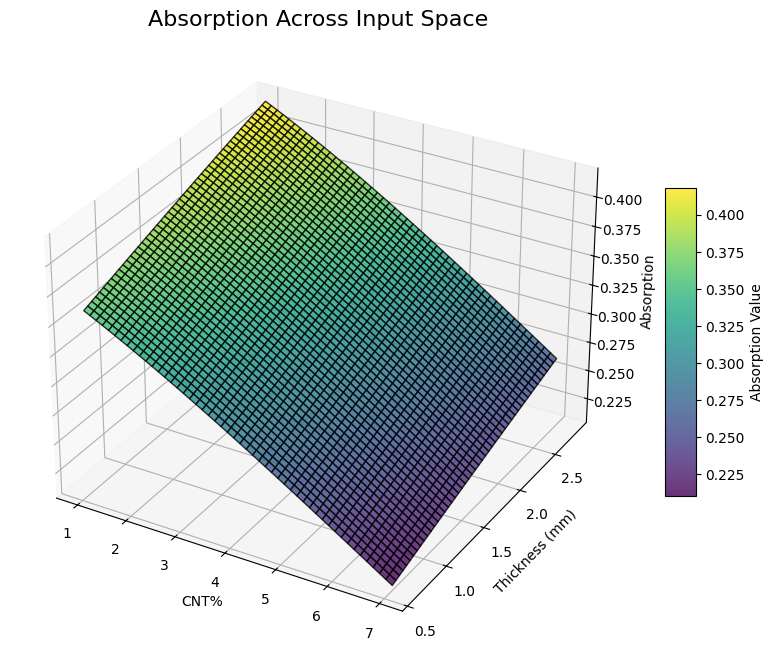

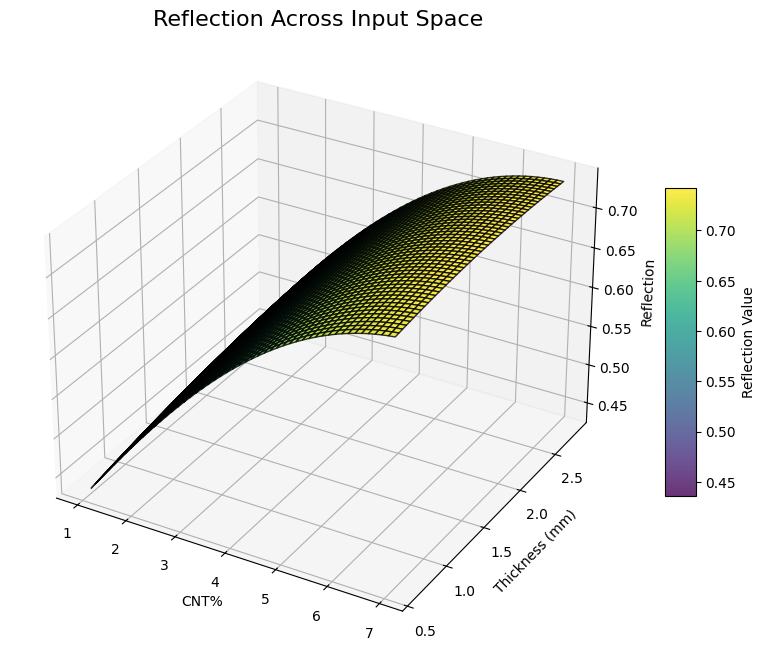

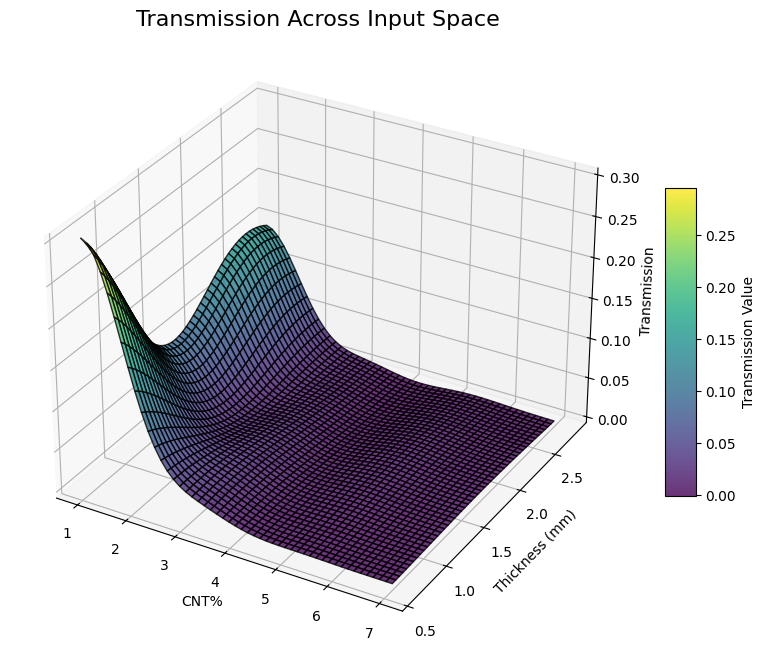

In [ ]:
def visualize_target_surface(gpr, title, X, Y, target_name):
    """
    Visualize the target variable as a 3D surface plot.

    Parameters:
    - gpr (GaussianProcessRegressor): Trained GPR model for the target.
    - title (str): Title for the plot.
    - X (np.ndarray): 2D array of CNT% values for the grid.
    - Y (np.ndarray): 2D array of Thickness values for the grid.
    - target_name (str): Name of the target variable being visualized.
    """
    # Create a meshgrid for CNT% and Thickness
    X_flat = X.ravel()
    Y_flat = Y.ravel()
    grid_points = np.vstack([X_flat, Y_flat]).T

    # Predict values for the grid
    Z_pred, Z_std = gpr.predict(grid_points, return_std=True)
    Z_pred = Z_pred.reshape(X.shape)

    # Plot the surface
    fig = plt.figure(figsize=(10, 8))
    ax = fig.add_subplot(111, projection='3d')
    surface = ax.plot_surface(X, Y, Z_pred, cmap='viridis', alpha=0.8, edgecolor='k')

    # Add color bar and labels
    fig.colorbar(surface, ax=ax, shrink=0.5, aspect=10, label=f"{target_name} Value")
    ax.set_title(title, fontsize=16)
    ax.set_xlabel("CNT%")
    ax.set_ylabel("Thickness (mm)")
    ax.set_zlabel(target_name)
    plt.show()

# Generate a grid of CNT% and Thickness
cnt_values = np.linspace(thesis_df['CNT%'].min(), thesis_df['CNT%'].max(), 50)
thickness_values = np.linspace(thesis_df['Thickness'].min(), thesis_df['Thickness'].max(), 50)
CNT_grid, Thickness_grid = np.meshgrid(cnt_values, thickness_values)

# Visualize each target variable
visualize_target_surface(gpr_absorption, "Absorption Across Input Space", CNT_grid, Thickness_grid, "Absorption")
visualize_target_surface(gpr_reflection, "Reflection Across Input Space", CNT_grid, Thickness_grid, "Reflection")
visualize_target_surface(gpr_transmission, "Transmission Across Input Space", CNT_grid, Thickness_grid, "Transmission")


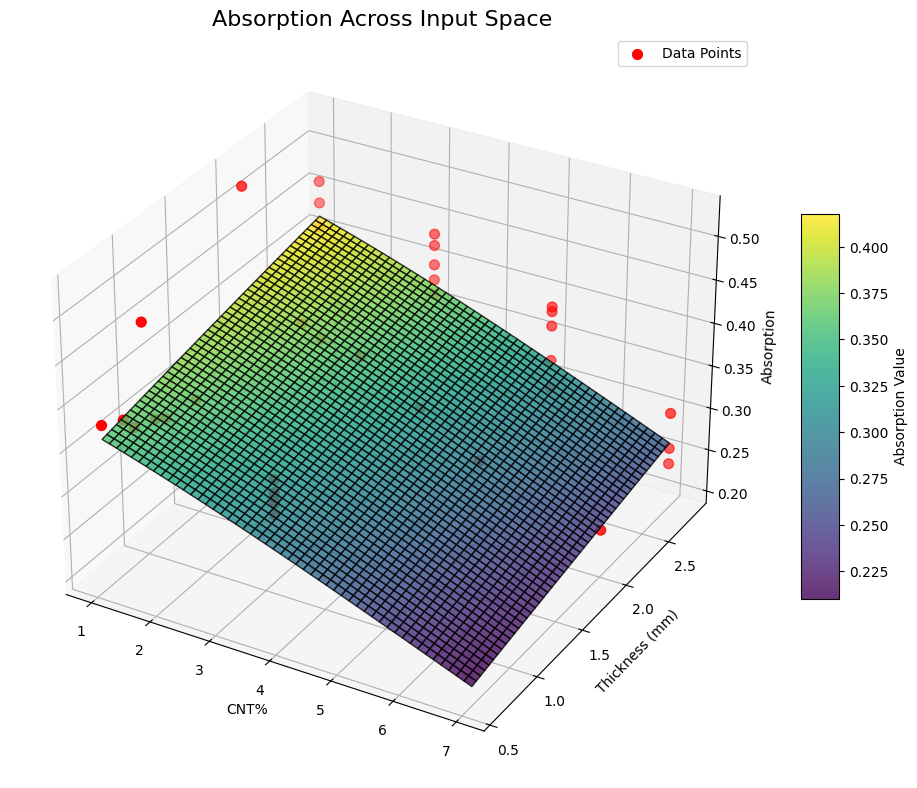

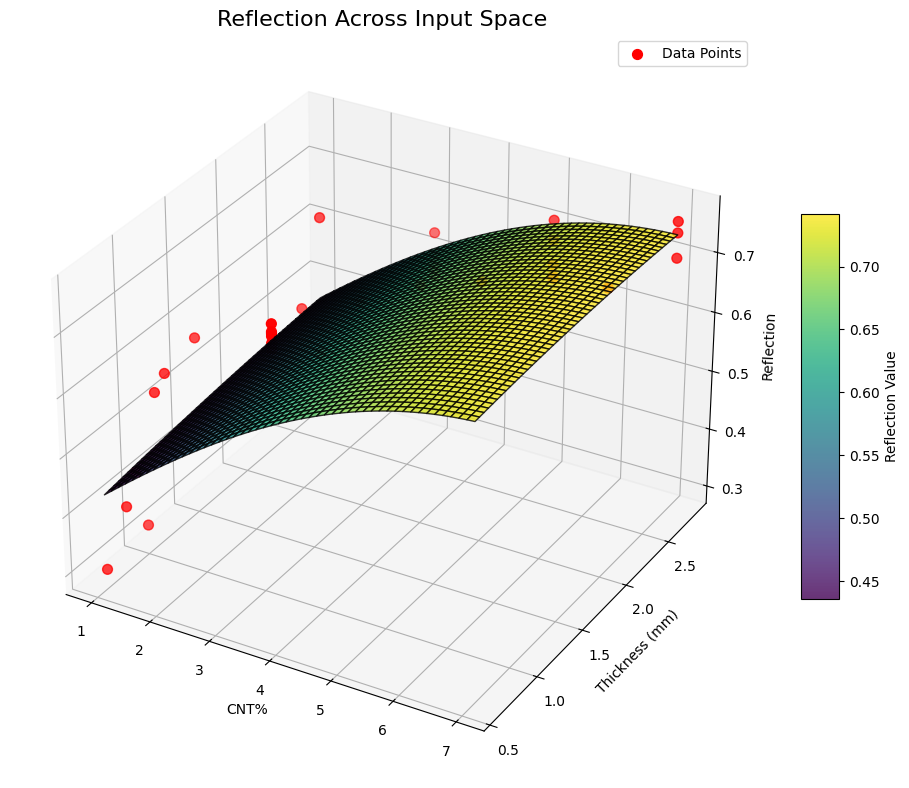

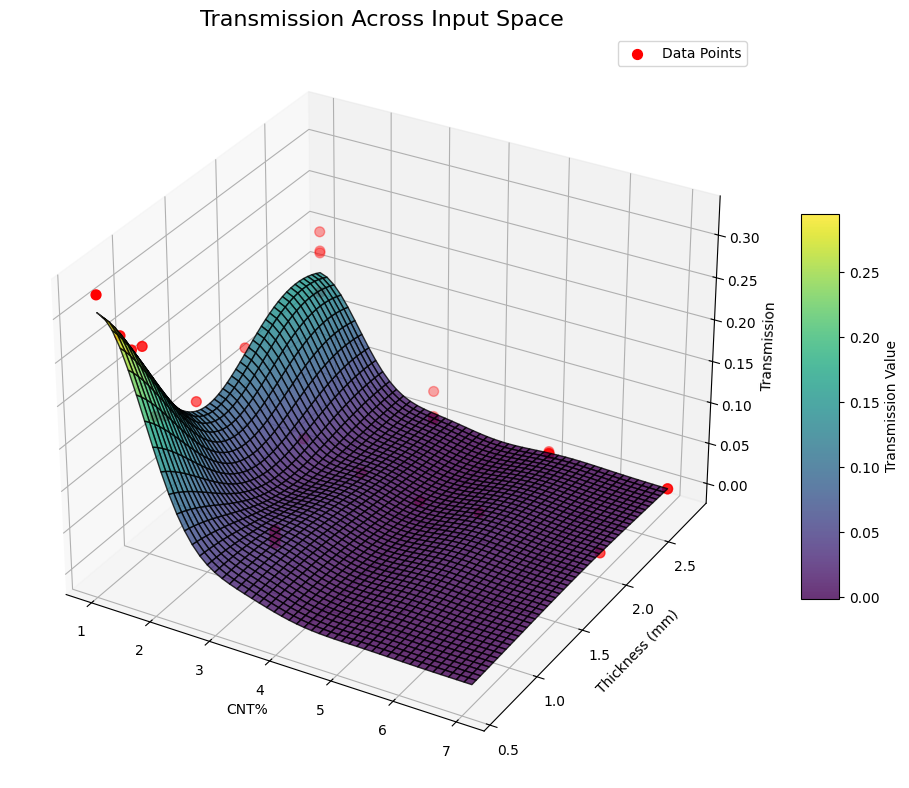

In [ ]:
def visualize_target_surface_with_points(gpr, title, X, Y, target_name, thesis_df, target_col, x_col="CNT%", y_col="Thickness"):
    """
    Visualize the target variable as a 3D surface plot with data points overlayed.

    Parameters:
    - gpr (GaussianProcessRegressor): Trained GPR model for the target.
    - title (str): Title for the plot.
    - X (np.ndarray): 2D array of CNT% values for the grid.
    - Y (np.ndarray): 2D array of Thickness values for the grid.
    - target_name (str): Name of the target variable being visualized.
    - thesis_df (pd.DataFrame): DataFrame containing the original data points.
    - target_col (str): Column name for the target variable in the DataFrame.
    - x_col (str): Column name for the x-axis variable (CNT%).
    - y_col (str): Column name for the y-axis variable (Thickness).
    """
    # Create a meshgrid for CNT% and Thickness
    X_flat = X.ravel()
    Y_flat = Y.ravel()
    grid_points = np.vstack([X_flat, Y_flat]).T

    # Predict values for the grid
    Z_pred, Z_std = gpr.predict(grid_points, return_std=True)
    Z_pred = Z_pred.reshape(X.shape)

    # Plot the surface
    fig = plt.figure(figsize=(12, 10))
    ax = fig.add_subplot(111, projection='3d')
    surface = ax.plot_surface(X, Y, Z_pred, cmap='viridis', alpha=0.8, edgecolor='k')

    # Add the actual data points as scatter points
    ax.scatter(thesis_df[x_col], thesis_df[y_col], thesis_df[target_col], color='r', s=50, label="Data Points")

    # Add color bar and labels
    fig.colorbar(surface, ax=ax, shrink=0.5, aspect=10, label=f"{target_name} Value")
    ax.set_title(title, fontsize=16)
    ax.set_xlabel("CNT%")
    ax.set_ylabel("Thickness (mm)")
    ax.set_zlabel(target_name)
    ax.legend()
    plt.show()

# Visualize with the actual data points overlayed
visualize_target_surface_with_points(
    gpr_absorption, "Absorption Across Input Space", CNT_grid, Thickness_grid,
    "Absorption", thesis_df, "mean_a", "CNT%", "Thickness"
)

visualize_target_surface_with_points(
    gpr_reflection, "Reflection Across Input Space", CNT_grid, Thickness_grid,
    "Reflection", thesis_df, "mean_r", "CNT%", "Thickness"
)

visualize_target_surface_with_points(
    gpr_transmission, "Transmission Across Input Space", CNT_grid, Thickness_grid,
    "Transmission", thesis_df, "mean_t", "CNT%", "Thickness"
)


Removing white noise smoothing function

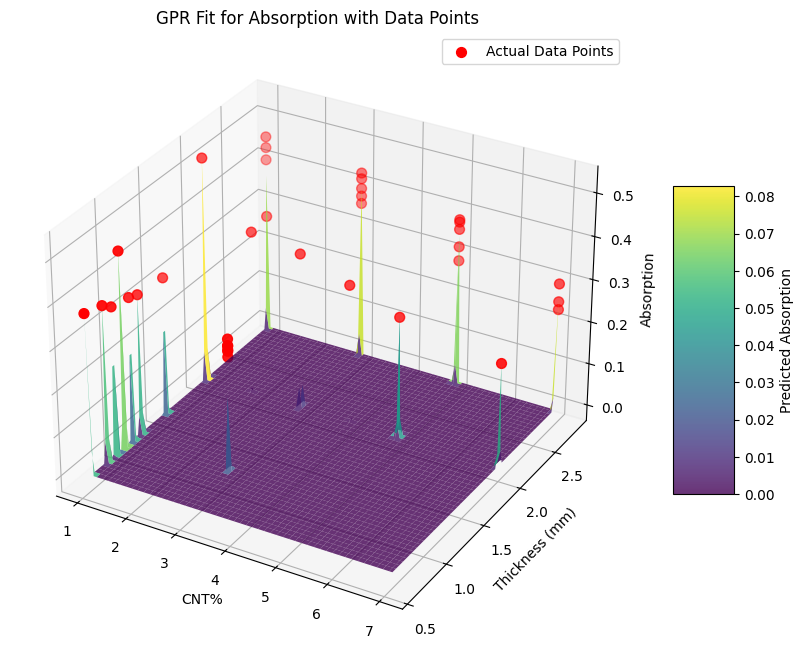

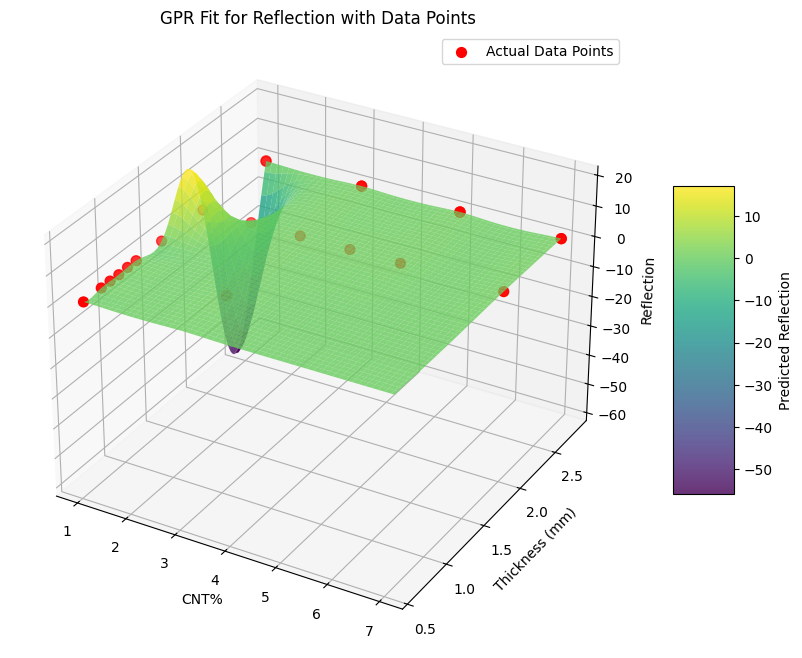

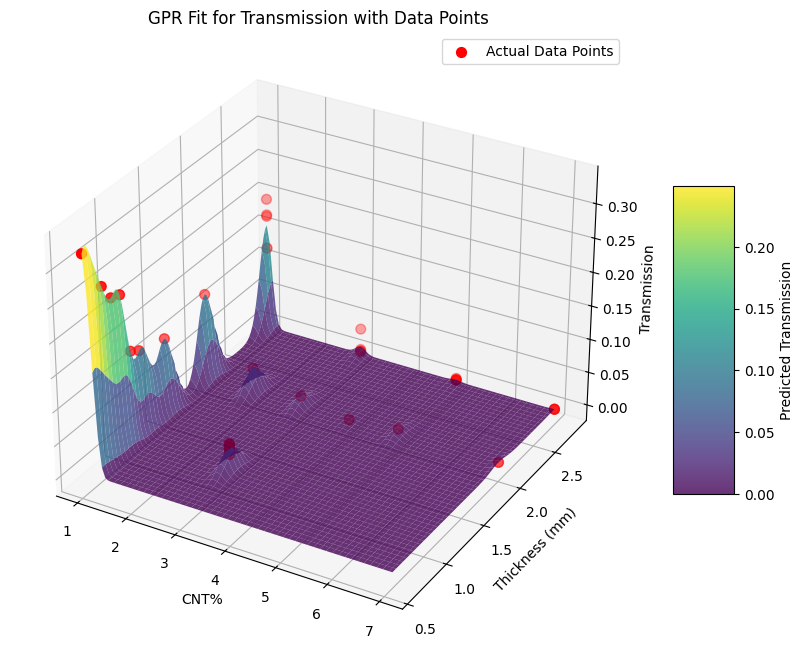

In [ ]:
def create_train_visualize_gpr_custom(thesis_df, target, grid_resolution=100):
    """
    Train a GPR model with target-specific kernel configurations and visualize the fit.

    Parameters:
    - thesis_df (pd.DataFrame): The dataset containing input features and targets.
    - target (str): The target variable to predict ('absorption', 'reflection', or 'transmission').
    - grid_resolution (int): Resolution for the prediction grid.

    Returns:
    - gpr_model (GaussianProcessRegressor): Trained GPR model.
    """
    # Extract features and target from thesis_df
    X = thesis_df[['cnt_pct', 'thickness']].values
    y = thesis_df[f'mean_{target[0].lower()}'].values  # mean_a, mean_r, or mean_t

    # Define custom kernel configurations based on the target variable
    if target == "absorption":
        kernel = C(1.0, (1e-1, 1e3)) * RBF(length_scale=0.5, length_scale_bounds=(1e-2, 1e1))
    elif target in ["reflection", "transmission"]:
        kernel = C(1.0, (1e-2, 1e3)) * RBF(length_scale=2.0, length_scale_bounds=(1e-1, 1e2))
    else:
        raise ValueError(f"Unknown target: {target}. Choose from 'absorption', 'reflection', or 'transmission'.")

    # Train the Gaussian Process Regressor
    gpr_model = GaussianProcessRegressor(kernel=kernel, alpha=1e-10, n_restarts_optimizer=10)
    gpr_model.fit(X, y)

    # Generate grid for predictions
    CNT_grid = np.linspace(thesis_df['CNT%'].min(), thesis_df['CNT%'].max(), grid_resolution)
    Thickness_grid = np.linspace(thesis_df['Thickness'].min(), thesis_df['Thickness'].max(), grid_resolution)
    CNT_grid, Thickness_grid = np.meshgrid(CNT_grid, Thickness_grid)
    X_pred = np.c_[CNT_grid.ravel(), Thickness_grid.ravel()]

    # Make predictions
    y_pred, y_std = gpr_model.predict(X_pred, return_std=True)
    y_pred = y_pred.reshape(CNT_grid.shape)

    # Plot the surface and overlay data points
    fig = plt.figure(figsize=(12, 8))
    ax = fig.add_subplot(111, projection='3d')
    surf = ax.plot_surface(CNT_grid, Thickness_grid, y_pred, cmap='viridis', alpha=0.8)
    fig.colorbar(surf, shrink=0.5, aspect=5, label=f'Predicted {target.capitalize()}')

    # Overlay the actual data points
    ax.scatter(
        thesis_df['CNT%'], thesis_df['Thickness'], thesis_df[f'mean_{target[0].lower()}'],
        c='red', label='Actual Data Points', s=50
    )

    # Labels and title
    ax.set_xlabel('CNT%')
    ax.set_ylabel('Thickness (mm)')
    ax.set_zlabel(f'{target.capitalize()}')
    ax.set_title(f'GPR Fit for {target.capitalize()} with Data Points')
    ax.legend()
    plt.show()

    return gpr_model

# Example usage for each target:
gpr_model_absorption = create_train_visualize_gpr_custom(thesis_df, target="absorption")
gpr_model_reflection = create_train_visualize_gpr_custom(thesis_df, target="reflection")
gpr_model_transmission = create_train_visualize_gpr_custom(thesis_df, target="transmission")


In [ ]:
thesis_df

,filename,cnt_pct,material,thickness,mean_a,max_a,std_a,range_a,weighted_mean_a,mean_r,...,gradient_a,gradient_r,gradient_t,performance_score,PCA1,PCA2,tSNE1,tSNE2,CNT%,Thickness
0,4%/PBT/4%-PBT-2.0mm.csv,4,PBT,2.0,0.322400,0.366000,0.032448,0.120000,0.325429,0.675710,...,0.001260,-0.001250,-1.000000e-05,-0.041117,0.115240,0.018058,-2.347158,3.230204,4.0,2.0
1,5%/PBT/5%-PBT-2.8mm-B.csv,5,PBT,2.8,0.290490,0.340000,0.031941,0.109000,0.293846,0.708940,...,0.001065,-0.001055,0.000000e+00,-0.067237,0.152722,-0.007661,-2.502394,3.452564,5.0,2.8
2,5%/PBT/5%-PBT-2.0mm.csv,5,PBT,2.0,0.280870,0.308000,0.024239,0.087000,0.282945,0.709060,...,0.000950,-0.000915,-3.000000e-05,-0.070281,0.151723,-0.023353,-2.637094,3.431880,5.0,2.0
3,5%/PBT/5%-PBT-2.8mm-A.csv,5,PBT,2.8,0.381270,0.428000,0.032487,0.121000,0.384122,0.614710,...,0.001225,-0.001235,0.000000e+00,0.007022,0.046279,0.065039,-2.109944,2.785143,5.0,2.8
4,5%/ABS/5%-ABS-2.8mm-C.csv,5,ABS,2.8,0.323394,0.378991,0.037225,0.151901,0.327121,0.675066,...,0.001591,-0.001586,-5.277696e-06,-0.040515,0.114426,0.020920,-2.339236,3.226514,5.0,2.8
5,5%/ABS/5%-ABS-2.8mm-B.csv,5,ABS,2.8,0.386848,0.447619,0.041150,0.165001,0.391030,0.610900,...,0.001709,-0.001698,-1.075371e-05,0.010605,0.041934,0.073774,-2.074533,2.766482,5.0,2.8
6,5%/ABS/5%-ABS-2.8mm-A.csv,5,ABS,2.8,0.364283,0.420302,0.037661,0.154790,0.368035,0.634600,...,0.001598,-0.001592,-6.100656e-06,-0.008015,0.068948,0.054678,-2.168010,2.940428,5.0,2.8
7,3%/ABS/3%-ABS-1.1mm-B-ambient.csv,3,ABS,1.1,0.277968,0.336482,0.037138,0.145670,0.281689,0.682892,...,0.001491,-0.001586,9.488576e-05,-0.058055,0.116387,-0.035871,-2.899476,3.093035,3.0,1.1
8,3%/ABS/3%-ABS-2.8mm-C.csv,3,ABS,2.8,0.398753,0.453739,0.037528,0.153152,0.402528,0.597885,...,0.001552,-0.001541,-1.118723e-05,0.020684,0.027240,0.081528,-2.035055,2.672850,3.0,2.8
9,3%/ABS/3%-ABS-1.1mm-A-ambient.csv,3,ABS,1.1,0.264837,0.319390,0.035780,0.132930,0.268387,0.703096,...,0.001321,-0.001426,1.044107e-04,-0.072097,0.140426,-0.043300,-2.945905,3.247687,3.0,1.1


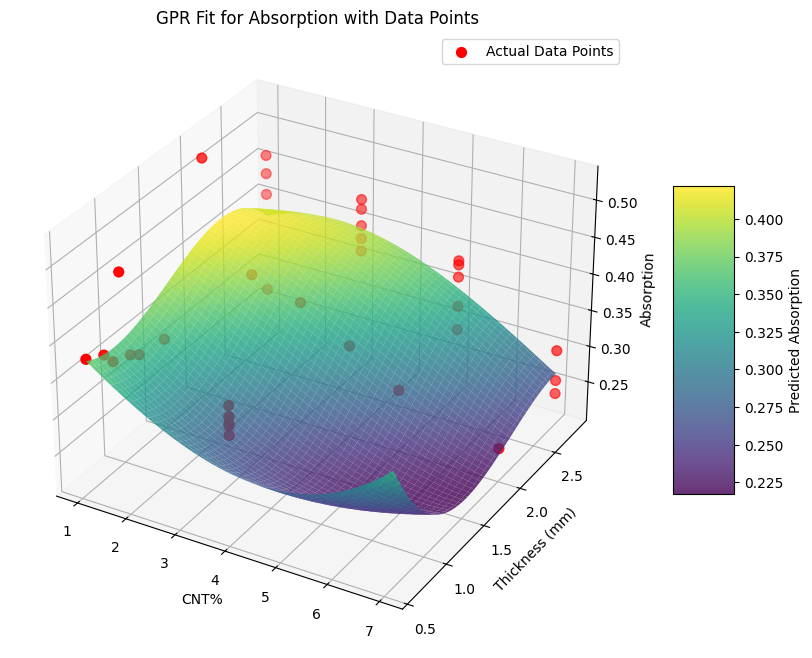

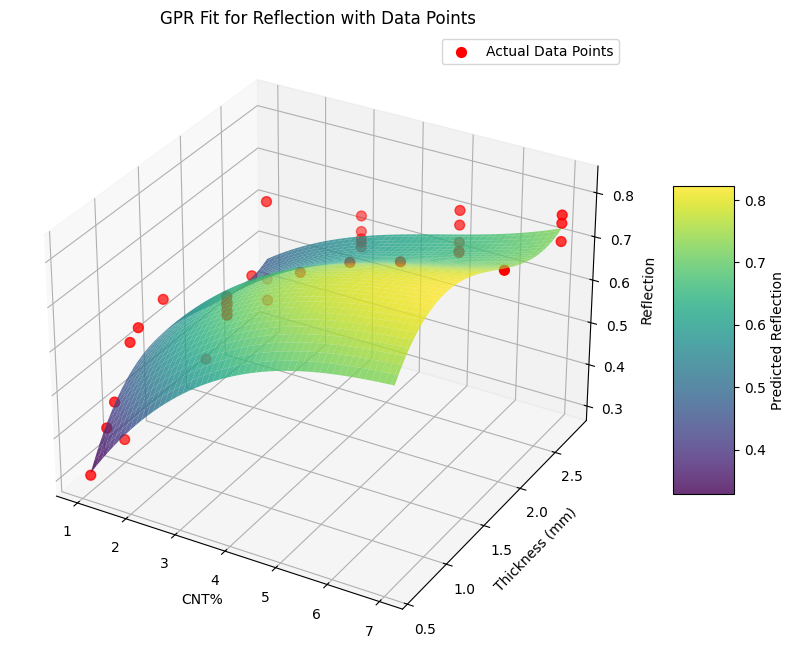

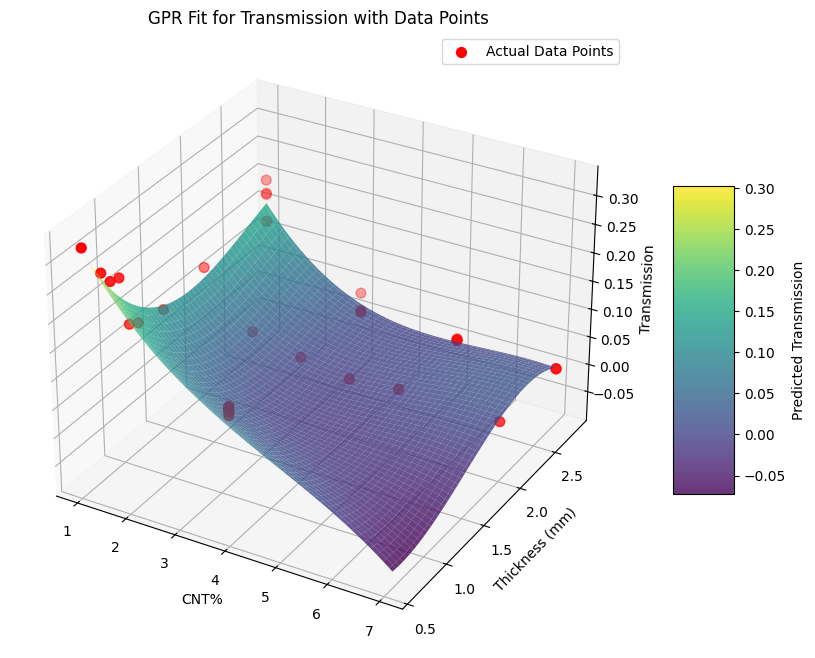

In [ ]:
def create_train_visualize_gpr_custom_normalized(thesis_df, target, grid_resolution=100):
    """
    Train a GPR model with target-specific kernel configurations and visualize the fit,
    with normalization of input features.

    Parameters:
    - thesis_df (pd.DataFrame): The dataset containing input features and targets.
    - target (str): The target variable to predict ('absorption', 'reflection', or 'transmission').
    - grid_resolution (int): Resolution for the prediction grid.

    Returns:
    - gpr_model (GaussianProcessRegressor): Trained GPR model.
    """
    # Extract features and target from thesis_df
    features = thesis_df[['cnt_pct', 'thickness']].values
    targets = thesis_df[f'mean_{target[0].lower()}'].values

    # Normalize the features
    scaler = MinMaxScaler()
    features_scaled = scaler.fit_transform(features)

    # Define custom kernel configurations based on the target variable
    if target == "absorption":
        kernel = C(1.0, (1e-1, 1e3)) * RBF(length_scale=0.5, length_scale_bounds=(1e1, 1e3))
    elif target in ["reflection", "transmission"]:
        kernel = C(1.0, (1e-2, 1e3)) * RBF(length_scale=2.0, length_scale_bounds=(1e1, 1e3))
    else:
        raise ValueError(f"Unknown target: {target}. Choose from 'absorption', 'reflection', or 'transmission'.")

    # Train the Gaussian Process Regressor
    gpr_model = GaussianProcessRegressor(kernel=kernel, alpha=1e-6, n_restarts_optimizer=10)
    gpr_model.fit(features_scaled, targets)

    # Generate grid for predictions
    CNT_grid = np.linspace(thesis_df['CNT%'].min(), thesis_df['CNT%'].max(), grid_resolution)
    Thickness_grid = np.linspace(thesis_df['Thickness'].min(), thesis_df['Thickness'].max(), grid_resolution)
    CNT_grid, Thickness_grid = np.meshgrid(CNT_grid, Thickness_grid)
    X_pred = np.c_[CNT_grid.ravel(), Thickness_grid.ravel()]
    X_pred_scaled = scaler.transform(X_pred)

    # Make predictions
    y_pred, y_std = gpr_model.predict(X_pred_scaled, return_std=True)
    y_pred = y_pred.reshape(CNT_grid.shape)

    # Plot the surface and overlay data points
    fig = plt.figure(figsize=(12, 8))
    ax = fig.add_subplot(111, projection='3d')
    surf = ax.plot_surface(CNT_grid, Thickness_grid, y_pred, cmap='viridis', alpha=0.8)
    fig.colorbar(surf, shrink=0.5, aspect=5, label=f'Predicted {target.capitalize()}')

    # Overlay the actual data points
    ax.scatter(
        thesis_df['CNT%'], thesis_df['Thickness'], thesis_df[f'mean_{target[0].lower()}'],
        c='red', label='Actual Data Points', s=50
    )

    # Labels and title
    ax.set_xlabel('CNT%')
    ax.set_ylabel('Thickness (mm)')
    ax.set_zlabel(f'{target.capitalize()}')
    ax.set_title(f'GPR Fit for {target.capitalize()} with Data Points')
    ax.legend()
    plt.show()

    return gpr_model

# Example usage for each target:
gpr_model_absorption = create_train_visualize_gpr_custom_normalized(thesis_df, target="absorption")
gpr_model_reflection = create_train_visualize_gpr_custom_normalized(thesis_df, target="reflection")
gpr_model_transmission = create_train_visualize_gpr_custom_normalized(thesis_df, target="transmission")


Optimization

In [51]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import joblib
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.gaussian_process.kernels import RBF, ConstantKernel as C
from sklearn.model_selection import train_test_split

def test_and_save_models(thesis_df, target_params_dict, base_path):
    """
    Test GPR models using optimal parameters for each target, plot the results, and save the models.

    Parameters:
    - thesis_df (pd.DataFrame): Dataset with features and target variables.
    - target_params_dict (dict): Optimal hyperparameters for each target.
    - base_path (str): Google Drive path to save the trained models.

    Returns:
    - models_dict (dict): Dictionary of trained GPR models.
    """
    models_dict = {}

    for target, params in target_params_dict.items():
        print(f"Training and testing model for: {target.capitalize()}")

        # Features and Target
        X = thesis_df[['cnt_pct', 'thickness']].values
        y = thesis_df[f'mean_{target[0].lower()}'].values

        # Train/Validation Split
        X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=42)

        # Define Kernel
        kernel = C(params['constant'], (1e-3, 1e3)) * RBF(length_scale=params['length_scale'],
                                                           length_scale_bounds=params['length_scale_bounds'])

        # Define & Train Model
        gpr = GaussianProcessRegressor(kernel=kernel, alpha=params['alpha'], n_restarts_optimizer=10)
        gpr.fit(X_train, y_train)

        # Save Model
        model_path = f"{base_path}/{target}_gpr_model.pkl"
        joblib.dump(gpr, model_path)
        print(f"Model saved to: {model_path}")

        models_dict[target] = gpr

        # Prediction Grid
        CNT_grid = np.linspace(thesis_df['cnt_pct'].min(), thesis_df['cnt_pct'].max(), 100)
        Thickness_grid = np.linspace(thesis_df['thickness'].min(), thesis_df['thickness'].max(), 100)
        CNT_grid, Thickness_grid = np.meshgrid(CNT_grid, Thickness_grid)
        X_pred = np.c_[CNT_grid.ravel(), Thickness_grid.ravel()]

        # Predict
        y_pred, y_std = gpr.predict(X_pred, return_std=True)
        y_pred = y_pred.reshape(CNT_grid.shape)

        # Plot
        fig = plt.figure(figsize=(12, 8))
        ax = fig.add_subplot(111, projection='3d')
        surf = ax.plot_surface(CNT_grid, Thickness_grid, y_pred, cmap='viridis', alpha=0.8)
        fig.colorbar(surf, shrink=0.5, aspect=5, label=f'Predicted {target.capitalize()}')

        ax.scatter(thesis_df['cnt_pct'], thesis_df['thickness'], y,
                   c='red', label='Actual Data', s=50)

        ax.set_xlabel('CNT%')
        ax.set_ylabel('Thickness (mm)')
        ax.set_zlabel(f'{target.capitalize()}')
        ax.set_title(f'Optimized RBF Fit for {target.capitalize()}')
        ax.legend()
        plt.show()

    print("All models trained, tested, and saved successfully.")
    return models_dict


Training and testing model for: Absorption
Model saved to: /content/drive/MyDrive/Thesis_Updated/Models/absorption_gpr_model.pkl


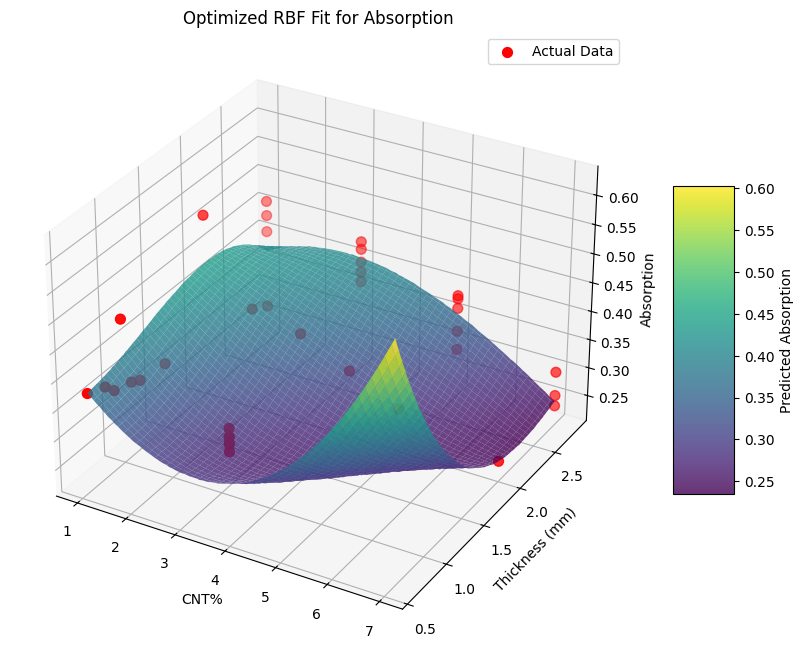

Training and testing model for: Reflection
Model saved to: /content/drive/MyDrive/Thesis_Updated/Models/reflection_gpr_model.pkl


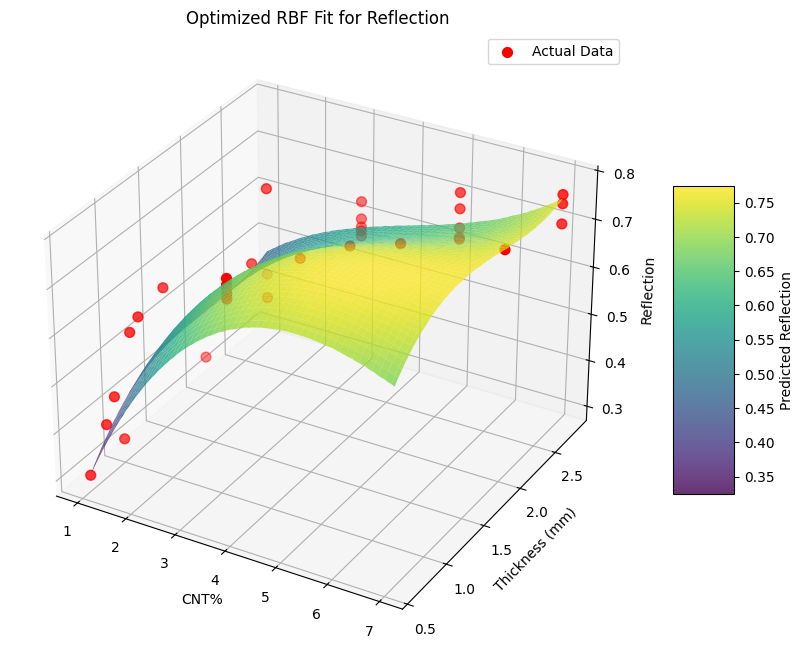

Training and testing model for: Transmission
Model saved to: /content/drive/MyDrive/Thesis_Updated/Models/transmission_gpr_model.pkl


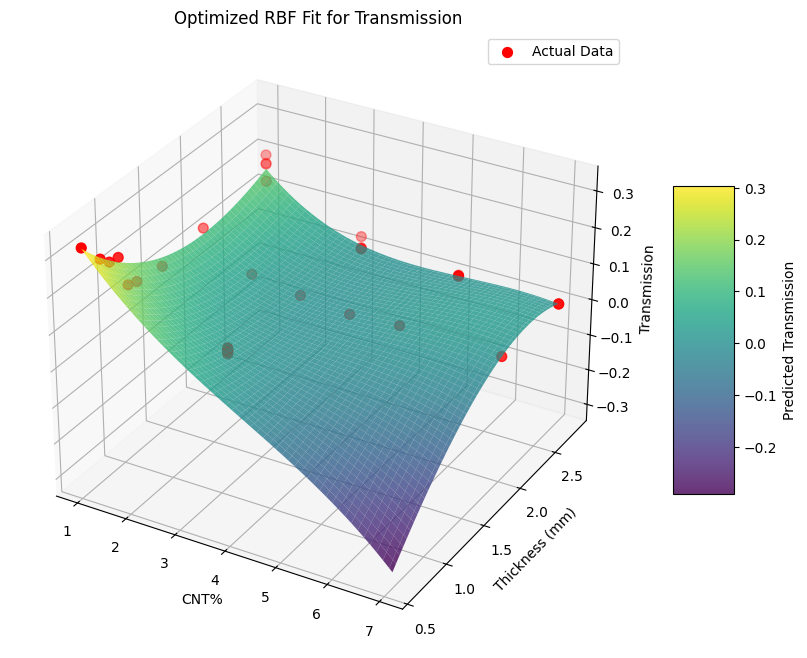

All models trained, tested, and saved successfully.


In [52]:
target_params_dict = {
    "absorption": {
        "length_scale": 0.1,
        "length_scale_bounds": (100.0, 10000.0),
        "constant": 1.0,
        "alpha": 1e-10,
        "loss": 0.012156219302128853
    },
    "reflection": {
        "length_scale": 0.1,
        "length_scale_bounds": (100.0, 10000.0),
        "constant": 1.0,
        "alpha": 1e-10,
        "loss": 0.015020231354209282
    },
    "transmission": {
        "length_scale": 0.1,
        "length_scale_bounds": (100.0, 10000.0),
        "constant": 1.0,
        "alpha": 1e-10,
        "loss": 0.010796799076837634
    }
}
base_path = '/content/drive/MyDrive/Thesis_Updated/Models'
# Assuming you've already defined `test_and_save_models()` from the previous code I gave you.

# Call it!
models_dict = test_and_save_models(thesis_df, target_params_dict, base_path)


In [45]:
import numpy as np

def compute_average_uncertainty(gpr_model, thesis_df, physical_bounds, extended_bounds, resolution=400):
    """
    Compute the average uncertainty over a specified region for a trained GPR model.

    Parameters:
    - gpr_model (GaussianProcessRegressor): Trained GPR model.
    - thesis_df (pd.DataFrame): Dataset for feature range reference.
    - physical_bounds (tuple): ((cnt_min, cnt_max), (thickness_min, thickness_max)) for the physical region.
    - extended_bounds (tuple): ((cnt_min, cnt_max), (thickness_min, thickness_max)) for the extended region.
    - resolution (int): Number of points in each dimension for the grid.

    Returns:
    - dict: Mean uncertainties for physical and extended regions.
    """
    def get_mean_uncertainty(bounds):
        (cnt_min, cnt_max), (th_min, th_max) = bounds
        CNT_grid = np.linspace(cnt_min, cnt_max, resolution)
        Thickness_grid = np.linspace(th_min, th_max, resolution)
        CNT_grid, Thickness_grid = np.meshgrid(CNT_grid, Thickness_grid)
        X_pred = np.c_[CNT_grid.ravel(), Thickness_grid.ravel()]

        # Predict standard deviation
        _, y_std = gpr_model.predict(X_pred, return_std=True)

        return np.mean(y_std)

    results = {
        "mean_uncertainty_physical_region": get_mean_uncertainty(physical_bounds),
        "mean_uncertainty_extended_region": get_mean_uncertainty(extended_bounds)
    }

    return results

# Define your regions:
physical_bounds = ((1.0, 7.0), (0.6, 2.8))     # CNT%, Thickness for Physical Region
extended_bounds = ((0.0, 30.0), (0.0, 10.0))    # CNT%, Thickness for Extended Region

# Example for Absorption model:
uncertainty_absorption_rbf = compute_average_uncertainty(models_dict['absorption'], thesis_df, physical_bounds, extended_bounds)

print("Absorption Model Uncertainty:", uncertainty_absorption_rbf)

# Repeat for Reflection / Transmission:
uncertainty_reflection_rbf = compute_average_uncertainty(models_dict['reflection'], thesis_df, physical_bounds, extended_bounds)
uncertainty_transmission_rbf = compute_average_uncertainty(models_dict['transmission'], thesis_df, physical_bounds, extended_bounds)
print("Absorption Model Uncertainty:", uncertainty_reflection_rbf)
print("Absorption Model Uncertainty:", uncertainty_transmission_rbf)

Absorption Model Uncertainty: {'mean_uncertainty_physical_region': np.float64(1.2851067087535024e-05), 'mean_uncertainty_extended_region': np.float64(0.0061105874477005665)}
Absorption Model Uncertainty: {'mean_uncertainty_physical_region': np.float64(1.2851067087535024e-05), 'mean_uncertainty_extended_region': np.float64(0.0061105874477005665)}
Absorption Model Uncertainty: {'mean_uncertainty_physical_region': np.float64(1.2851067087535024e-05), 'mean_uncertainty_extended_region': np.float64(0.0061105874477005665)}


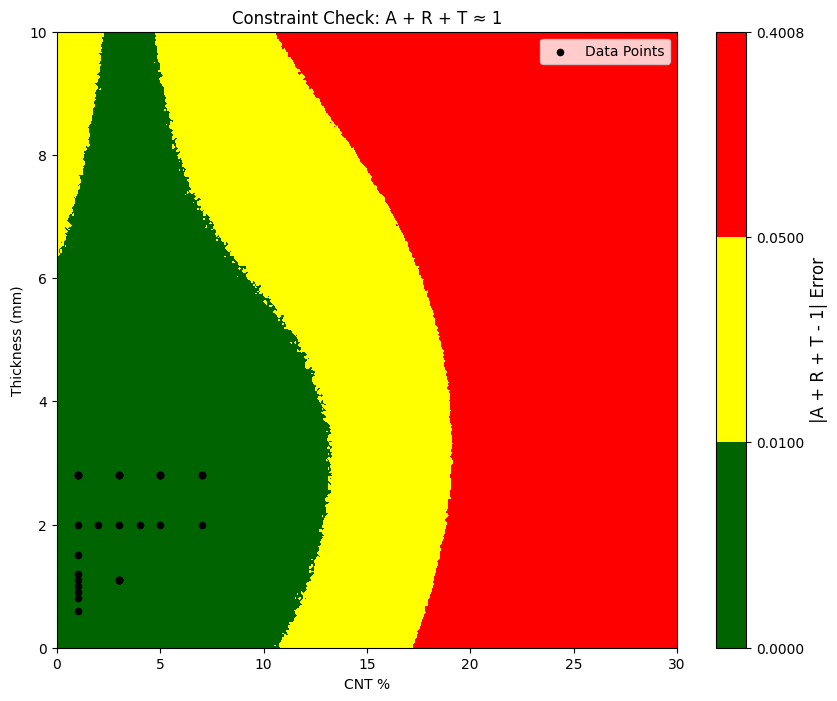

In [19]:
import numpy as np
import matplotlib.pyplot as plt

def plot_sum_constraint(models_dict, thesis_df, extended_bounds, resolution=300):
    import numpy as np
    import matplotlib.pyplot as plt

    (cnt_min, cnt_max), (th_min, th_max) = extended_bounds

    CNT_grid = np.linspace(cnt_min, cnt_max, resolution)
    Thickness_grid = np.linspace(th_min, th_max, resolution)
    CNT_grid, Thickness_grid = np.meshgrid(CNT_grid, Thickness_grid)
    X_pred = np.c_[CNT_grid.ravel(), Thickness_grid.ravel()]

    # Predict Absorption, Reflection, Transmission
    A_pred = models_dict['absorption'].predict(X_pred)
    R_pred = models_dict['reflection'].predict(X_pred)
    T_pred = models_dict['transmission'].predict(X_pred)

    Sum_pred = A_pred + R_pred + T_pred
    Sum_pred = Sum_pred.reshape(CNT_grid.shape)

    # Calculate Error from 1
    Error = np.abs(Sum_pred - 1)

    # Dynamically set contour levels
    max_error = Error.max()

    if max_error < 0.01:
        levels = [0, max_error * 0.33, max_error * 0.66, max_error]
        colors = ['darkgreen', 'yellow', 'red']
    else:
        levels = [0, 0.01, 0.05, max_error]
        colors = ['darkgreen', 'yellow', 'red']

    # Plot
    plt.figure(figsize=(10, 8))
    contour = plt.contourf(CNT_grid, Thickness_grid, Error, levels=levels, colors=colors)
    cbar = plt.colorbar(contour)
    cbar.set_label('|A + R + T - 1| Error', fontsize=12)

    plt.scatter(thesis_df['cnt_pct'], thesis_df['thickness'], c='black', s=20, label='Data Points')

    plt.xlabel('CNT %')
    plt.ylabel('Thickness (mm)')
    plt.title('Constraint Check: A + R + T ≈ 1')
    plt.legend()
    plt.show()

extended_bounds = ((0.0, 30.0), (0.0, 10.0))

plot_sum_constraint(models_dict, thesis_df, extended_bounds)


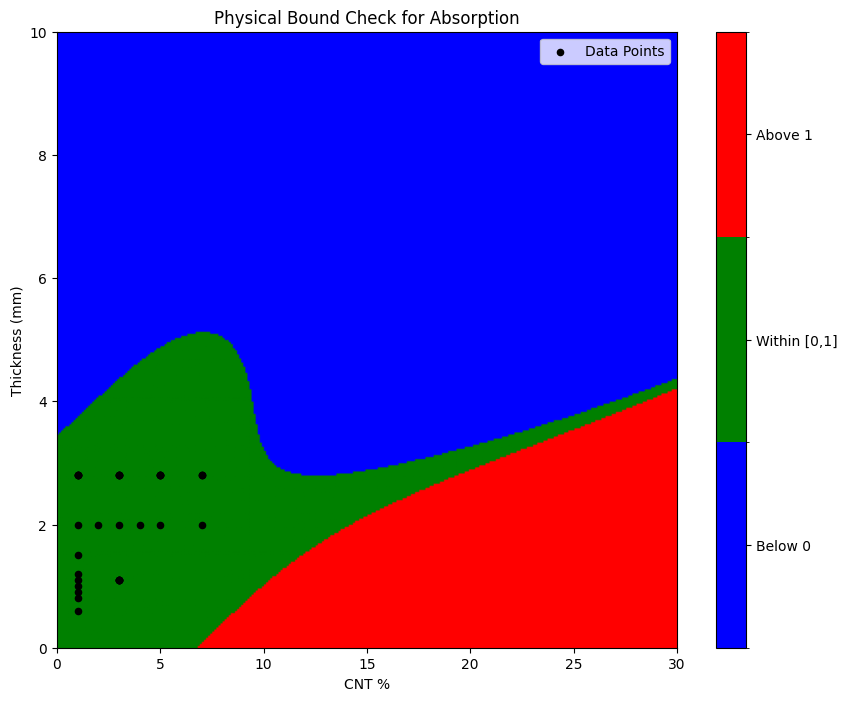

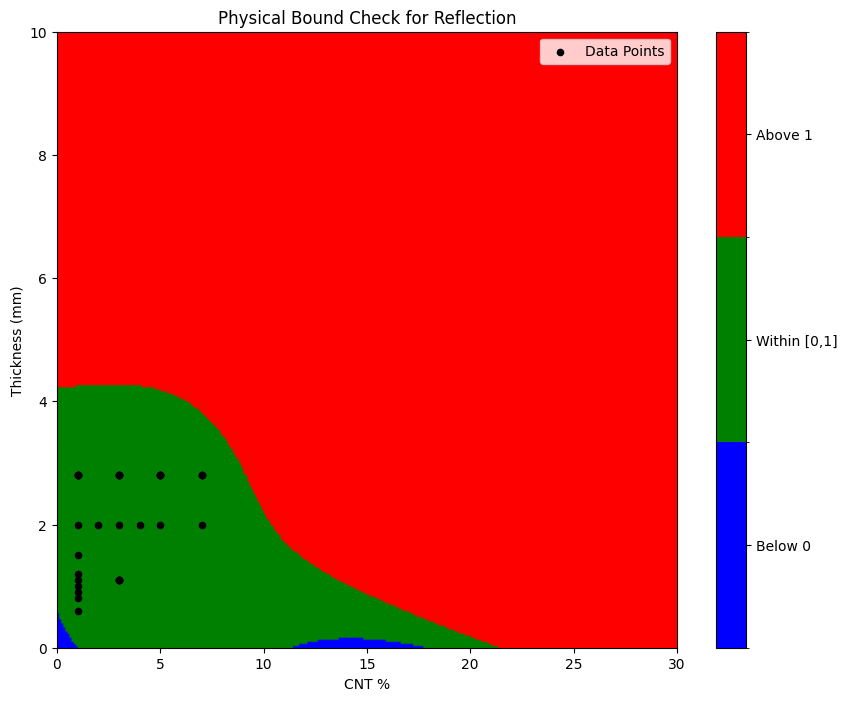

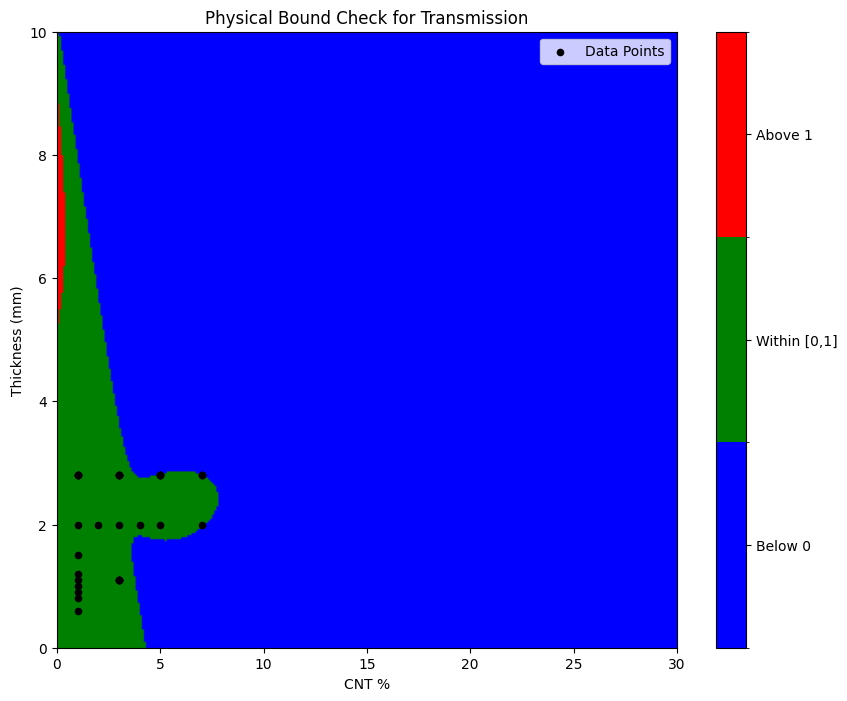

In [30]:
def plot_physical_bounds(models_dict, thesis_df, extended_bounds, resolution=300):
    """
    Plot where Absorption / Reflection / Transmission values are within [0, 1], below 0, or above 1.

    Parameters:
    - models_dict (dict): Trained models for absorption, reflection, transmission.
    - thesis_df (pd.DataFrame): Dataset for feature reference.
    - extended_bounds (tuple): ((cnt_min, cnt_max), (th_min, th_max)).
    - resolution (int): Grid resolution.

    Returns:
    - None (displays plots)
    """
    import numpy as np
    import matplotlib.pyplot as plt

    (cnt_min, cnt_max), (th_min, th_max) = extended_bounds

    CNT_grid = np.linspace(cnt_min, cnt_max, resolution)
    Thickness_grid = np.linspace(th_min, th_max, resolution)
    CNT_grid, Thickness_grid = np.meshgrid(CNT_grid, Thickness_grid)
    X_pred = np.c_[CNT_grid.ravel(), Thickness_grid.ravel()]

    for target in ['absorption', 'reflection', 'transmission']:
        y_pred = models_dict[target].predict(X_pred)
        y_pred = y_pred.reshape(CNT_grid.shape)

        # Classification based on range
        # 0 = Below 0, 1 = In [0,1], 2 = Above 1
        condition_map = np.zeros_like(y_pred)

        condition_map[(y_pred >= 0) & (y_pred <= 1)] = 1
        condition_map[y_pred > 1] = 2

        # Colors: Blue, Green, Red
        cmap = plt.matplotlib.colors.ListedColormap(['blue', 'green', 'red'])
        bounds = [-0.5, 0.5, 1.5, 2.5]
        norm = plt.matplotlib.colors.BoundaryNorm(bounds, cmap.N)

        plt.figure(figsize=(10, 8))
        plt.title(f'Physical Bound Check for {target.capitalize()}')
        plt.xlabel('CNT %')
        plt.ylabel('Thickness (mm)')
        plt.scatter(thesis_df['cnt_pct'], thesis_df['thickness'], c='black', s=20, label='Data Points')

        img = plt.imshow(condition_map, extent=(cnt_min, cnt_max, th_min, th_max),
                         origin='lower', cmap=cmap, norm=norm, aspect='auto')

        cbar = plt.colorbar(img, ticks=[0, 1, 2])
        cbar.ax.set_yticklabels(['Below 0', 'Within [0,1]', 'Above 1'])
        plt.legend()
        plt.show()
plot_physical_bounds(models_dict, thesis_df, extended_bounds)

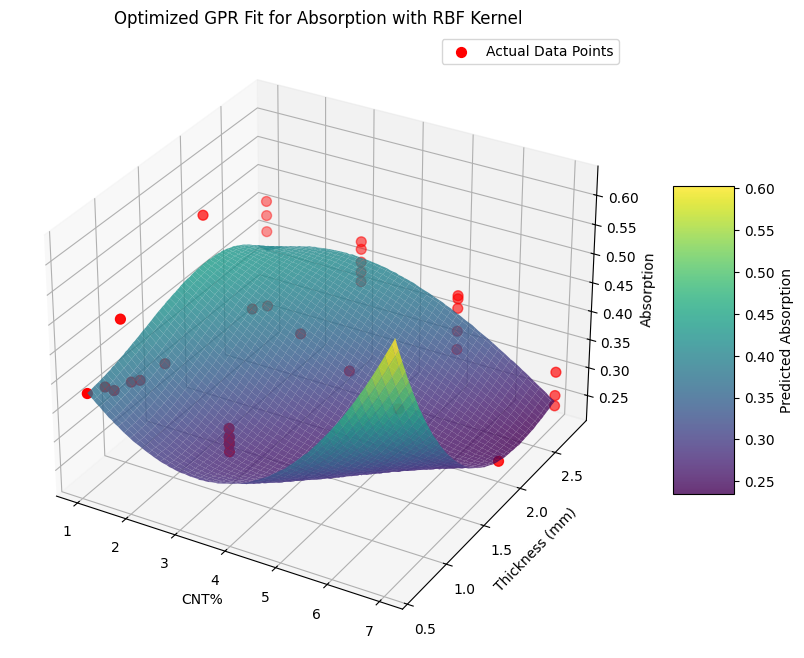

Best Absorption Model Parameters: {'length_scale': 0.1, 'length_scale_bounds': (100.0, 10000.0), 'constant': 1.0, 'alpha': 1e-10, 'loss': 0.012156219302128853}


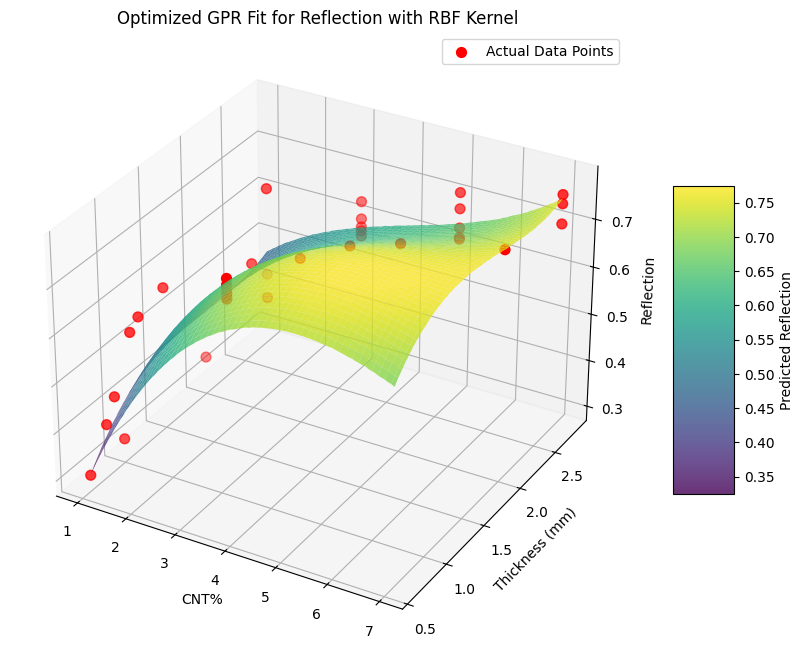

Best Reflection Model Parameters: {'length_scale': 0.1, 'length_scale_bounds': (100.0, 10000.0), 'constant': 1.0, 'alpha': 1e-10, 'loss': 0.015020231354209282}


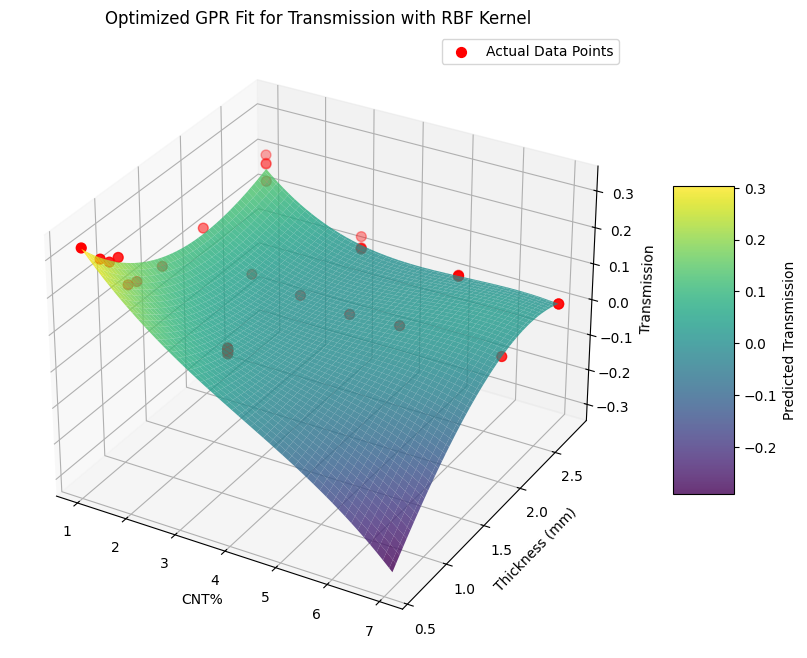

Best Transmission Model Parameters: {'length_scale': 0.1, 'length_scale_bounds': (100.0, 10000.0), 'constant': 1.0, 'alpha': 1e-10, 'loss': 0.010796799076837634}


In [ ]:
def custom_loss(y_true, y_pred, kernel):
    """
    Custom loss function to penalize spiky fits.
    Rewards smoother fits with larger length_scale values.

    Parameters:
    - y_true (array): True target values.
    - y_pred (array): Predicted target values.
    - kernel: The kernel of the GPR model.

    Returns:
    - float: Computed loss.
    """
    mse = np.mean((y_true - y_pred) ** 2)  # Mean Squared Error
    length_scale = kernel.k2.length_scale  # Extract RBF length scale
    penalty = 1 / (length_scale + 1e-6)  # Penalize small length_scale values
    return mse + penalty

def grid_search_rbf(thesis_df, target, grid_resolution=100):
    """
    Perform grid search to optimize hyperparameters of the RBF kernel.

    Parameters:
    - thesis_df (pd.DataFrame): The dataset containing input features and targets.
    - target (str): The target variable to predict ('absorption', 'reflection', or 'transmission').
    - grid_resolution (int): Resolution for the prediction grid.

    Returns:
    - best_model (GaussianProcessRegressor): Trained GPR model with the best RBF kernel.
    - best_params (dict): Optimal hyperparameters of the RBF kernel.
    """
    # Extract features and target
    X = thesis_df[['cnt_pct', 'thickness']].values
    y = thesis_df[f'mean_{target[0].lower()}'].values

    # Split into train and validation sets
    X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=42)

    # Hyperparameter grid
    length_scales = [0.1]
    length_scale_bounds = [(1e-2, 1e1), (1e-1, 1e2), (1e-1, 1e1), (1e0, 1e1), (1e0, 1e2), (1e1, 1e3), (1e2, 1e4),]
    constants = [1.0, 2.0]
    alphas = [1e-10]

    best_loss = float('inf')
    best_model = None
    best_params = None

    # Grid search
    for ls in length_scales:
        for lsb in length_scale_bounds:
            for c in constants:
                for alpha in alphas:
                    # Define kernel
                    kernel = C(c, (1e-3, 1e3)) * RBF(length_scale=ls, length_scale_bounds=lsb)
                    gpr = GaussianProcessRegressor(kernel=kernel, alpha=alpha, n_restarts_optimizer=10)
                    gpr.fit(X_train, y_train)
                    y_val_pred = gpr.predict(X_val)
                    loss = custom_loss(y_val, y_val_pred, gpr.kernel_)

                    # Update best model if lower loss is found
                    if loss < best_loss:
                        best_loss = loss
                        best_model = gpr
                        best_params = {
                            "length_scale": ls,
                            "length_scale_bounds": lsb,
                            "constant": c,
                            "alpha": alpha,
                            "loss": loss,
                        }

    # Generate grid for predictions
    CNT_grid = np.linspace(thesis_df['CNT%'].min(), thesis_df['CNT%'].max(), grid_resolution)
    Thickness_grid = np.linspace(thesis_df['Thickness'].min(), thesis_df['Thickness'].max(), grid_resolution)
    CNT_grid, Thickness_grid = np.meshgrid(CNT_grid, Thickness_grid)
    X_pred = np.c_[CNT_grid.ravel(), Thickness_grid.ravel()]

    # Make predictions
    y_pred, y_std = best_model.predict(X_pred, return_std=True)
    y_pred = y_pred.reshape(CNT_grid.shape)

    # Plot the results
    fig = plt.figure(figsize=(12, 8))
    ax = fig.add_subplot(111, projection='3d')
    surf = ax.plot_surface(CNT_grid, Thickness_grid, y_pred, cmap='viridis', alpha=0.8)
    fig.colorbar(surf, shrink=0.5, aspect=5, label=f'Predicted {target.capitalize()}')

    # Overlay the actual data points
    ax.scatter(
        thesis_df['CNT%'], thesis_df['Thickness'], thesis_df[f'mean_{target[0].lower()}'],
        c='red', label='Actual Data Points', s=50
    )

    # Labels and title
    ax.set_xlabel('CNT%')
    ax.set_ylabel('Thickness (mm)')
    ax.set_zlabel(f'{target.capitalize()}')
    ax.set_title(f'Optimized GPR Fit for {target.capitalize()} with RBF Kernel')
    ax.legend()
    plt.show()

    return best_model, best_params

# Example usage for each target:
gpr_model_absorption, best_params_absorption = grid_search_rbf(thesis_df, target="absorption")
print("Best Absorption Model Parameters:", best_params_absorption)

gpr_model_reflection, best_params_reflection = grid_search_rbf(thesis_df, target="reflection")
print("Best Reflection Model Parameters:", best_params_reflection)

gpr_model_transmission, best_params_transmission = grid_search_rbf(thesis_df, target="transmission")
print("Best Transmission Model Parameters:", best_params_transmission)


matern

In [53]:
def train_and_save_matern_models(thesis_df, target_params_dict, base_path):
    """
    Train and save GPR models with Matern kernel for each target.

    Parameters:
    - thesis_df (pd.DataFrame): Dataset with features and targets.
    - target_params_dict (dict): Optimal hyperparameters for each target.
    - base_path (str): Path to save the trained models.

    Returns:
    - models_dict (dict): Trained GPR models.
    """
    import numpy as np
    import joblib
    import matplotlib.pyplot as plt
    from sklearn.gaussian_process import GaussianProcessRegressor
    from sklearn.gaussian_process.kernels import Matern, ConstantKernel as C
    from sklearn.model_selection import train_test_split

    models_dict = {}

    for target, params in target_params_dict.items():
        print(f"Training and saving Matern model for: {target.capitalize()}")

        X = thesis_df[['cnt_pct', 'thickness']].values
        y = thesis_df[f'mean_{target[0].lower()}'].values

        X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=42)

        kernel = C(1.0, (1e-3, 1e3)) * Matern(length_scale=params['length_scale'],
                                              length_scale_bounds=params['length_scale_bounds'],
                                              nu=params['nu'])

        gpr = GaussianProcessRegressor(kernel=kernel, alpha=1e-10, n_restarts_optimizer=10)
        gpr.fit(X_train, y_train)

        model_path = f"{base_path}/{target}_gpr_model_matern.pkl"
        joblib.dump(gpr, model_path)
        print(f"Model saved to: {model_path}")

        models_dict[target] = gpr

    return models_dict
base_path = '/content/drive/MyDrive/Thesis_Updated/Models'
matern_target_params_dict = {
    "absorption": {
        "length_scale": 0.5,
        "length_scale_bounds": (10.0, 10000.0),
        "nu": 0.5,
        "loss": 0.003142718687877466
    },
    "reflection": {
        "length_scale": 0.5,
        "length_scale_bounds": (100.0, 100000.0),
        "nu": 0.5,
        "loss": 0.006943114373428717
    },
    "transmission": {
        "length_scale": 0.5,
        "length_scale_bounds": (10.0, 10000.0),
        "nu": 0.5,
        "loss": 0.0011041427657028989
    }
}
# uncertainty_absorption_rbf = compute_average_uncertainty(models_dict['absorption'], thesis_df, physical_bounds, extended_bounds)

models_dict_matern = train_and_save_matern_models(thesis_df, matern_target_params_dict, base_path)



Training and saving Matern model for: Absorption
Model saved to: /content/drive/MyDrive/Thesis_Updated/Models/absorption_gpr_model_matern.pkl
Training and saving Matern model for: Reflection
Model saved to: /content/drive/MyDrive/Thesis_Updated/Models/reflection_gpr_model_matern.pkl
Training and saving Matern model for: Transmission
Model saved to: /content/drive/MyDrive/Thesis_Updated/Models/transmission_gpr_model_matern.pkl


Absorption Model Uncertainty: {'mean_uncertainty_physical_region': np.float64(0.2668097551431102), 'mean_uncertainty_extended_region': np.float64(1.2853174167200416)}
Reflection Model Uncertainty: {'mean_uncertainty_physical_region': np.float64(0.09281901727344741), 'mean_uncertainty_extended_region': np.float64(0.4473944852737591)}
Transmission Model Uncertainty: {'mean_uncertainty_physical_region': np.float64(0.22414390771872345), 'mean_uncertainty_extended_region': np.float64(1.0798112320919555)}


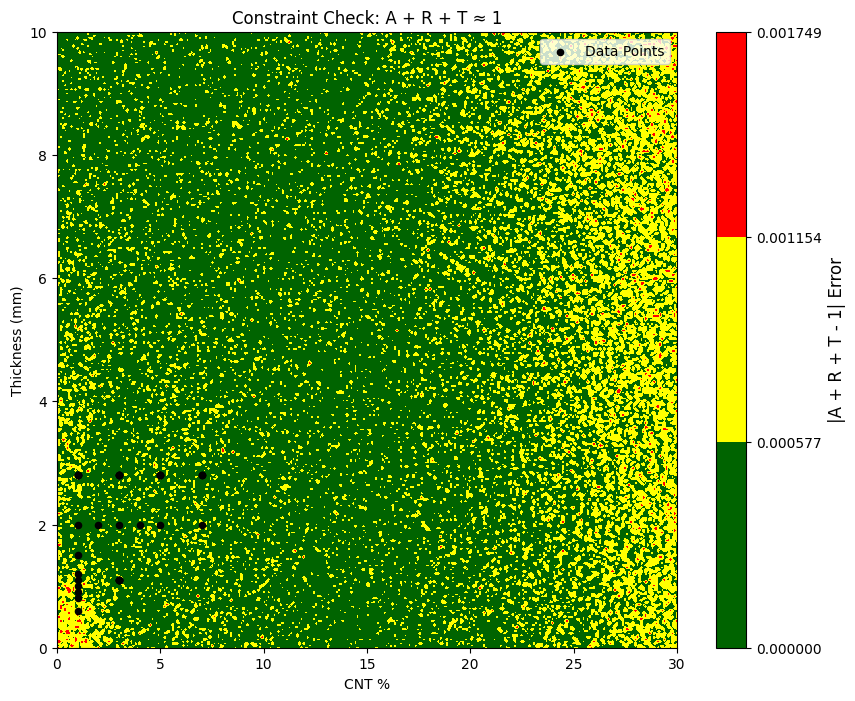

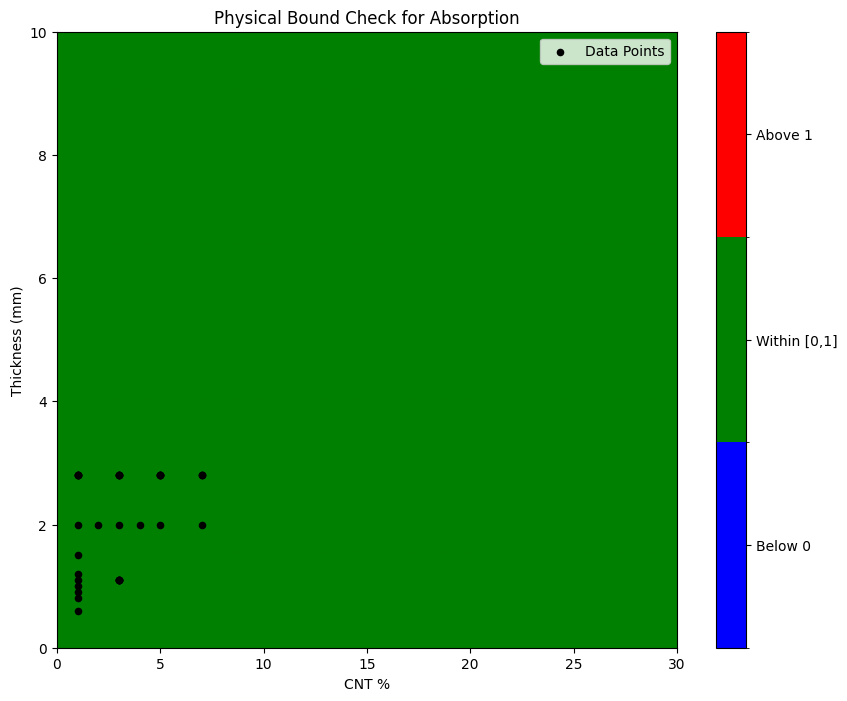

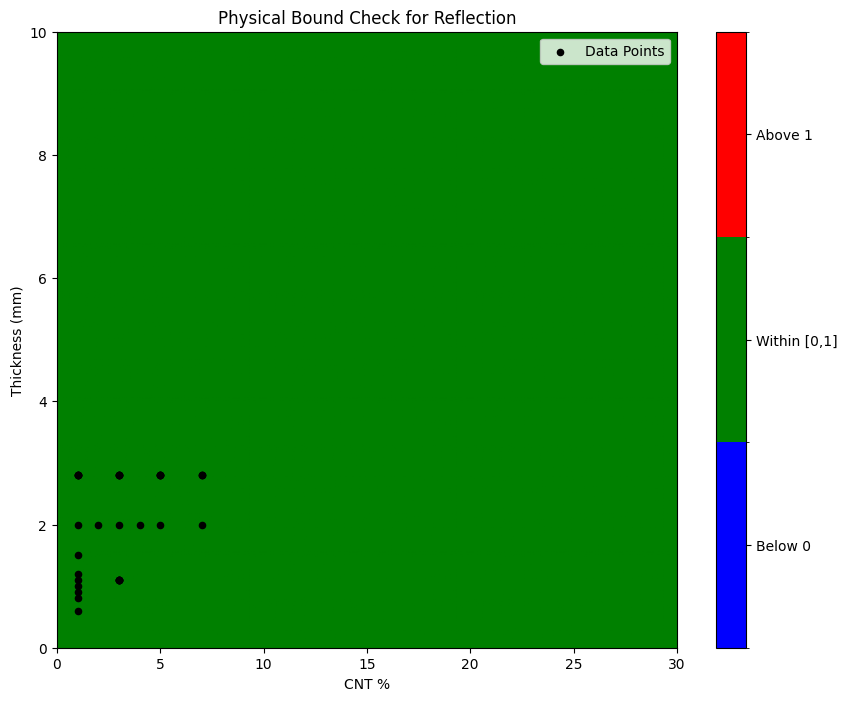

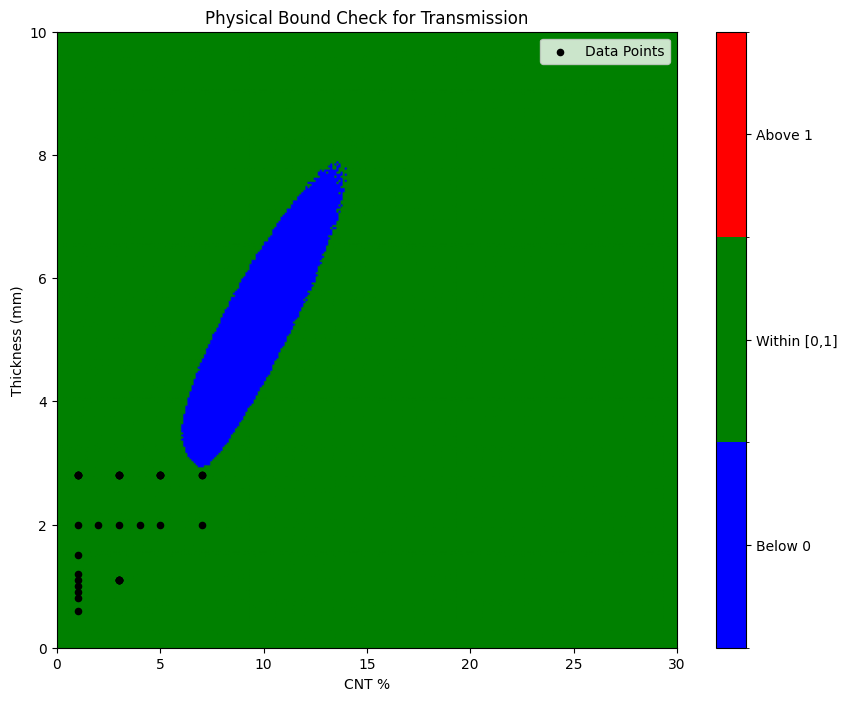

In [34]:
uncertainty_absorption_matern = compute_average_uncertainty(models_dict_matern['absorption'],thesis_df, physical_bounds, extended_bounds)
uncertainty_reflection_matern = compute_average_uncertainty(models_dict_matern['reflection'],thesis_df, physical_bounds, extended_bounds)
uncertainty_transmission_matern = compute_average_uncertainty(models_dict_matern['transmission'],thesis_df, physical_bounds, extended_bounds)
print("Absorption Model Uncertainty:", uncertainty_absorption_matern)
print("Reflection Model Uncertainty:", uncertainty_reflection_matern)
print("Transmission Model Uncertainty:", uncertainty_transmission_matern)

physical_bounds = ((1.0, 7.0), (0.6, 2.8))     # CNT%, Thickness for Physical Region
extended_bounds = ((0.0, 30.0), (0.0, 10.0))    # CNT%, Thickness for

plot_sum_constraint(models_dict_matern, thesis_df, extended_bounds)
plot_physical_bounds(models_dict_matern, thesis_df, extended_bounds)

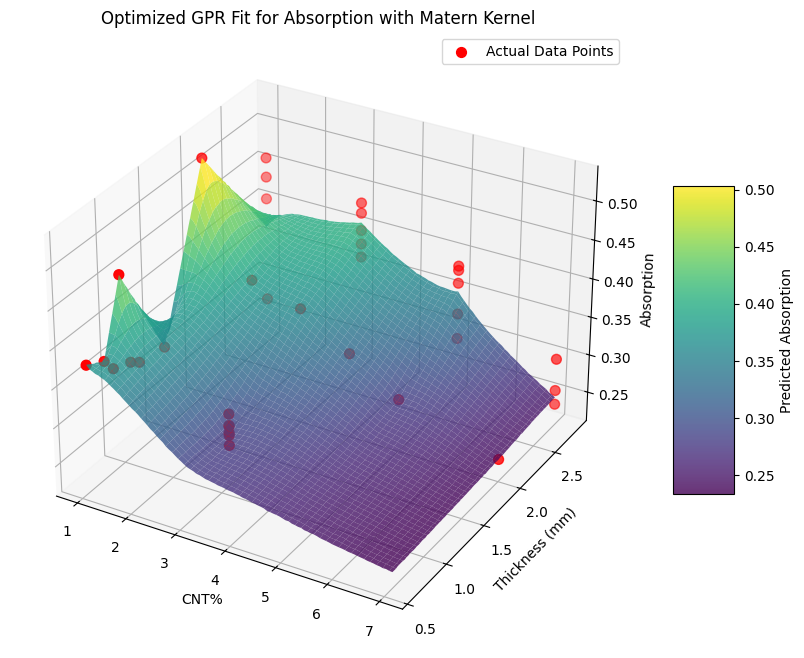

Best Absorption Model Parameters (Matern): {'length_scale': 0.5, 'length_scale_bounds': (10.0, 10000.0), 'nu': 0.5, 'loss': 0.003142718687877466}


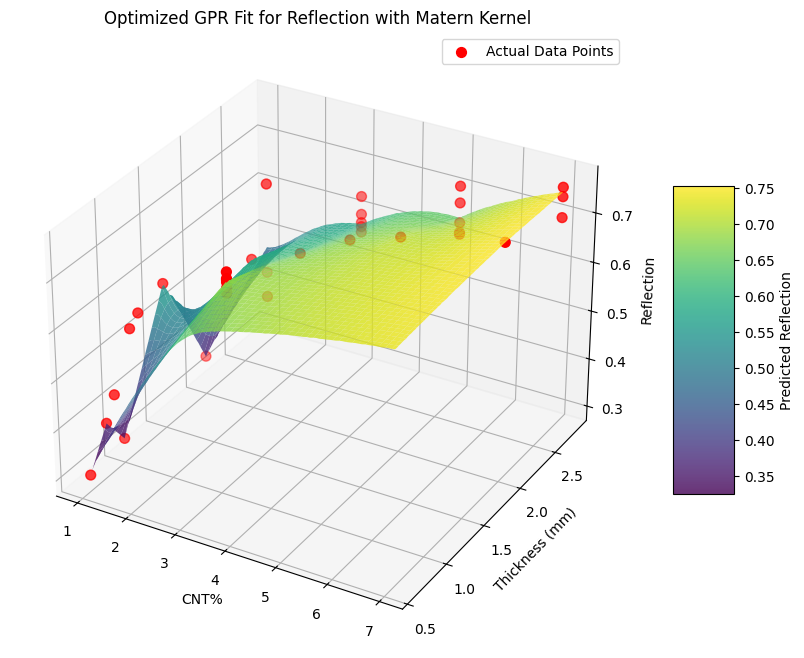

Best Reflection Model Parameters (Matern): {'length_scale': 0.5, 'length_scale_bounds': (100.0, 100000.0), 'nu': 0.5, 'loss': 0.006943114373428717}


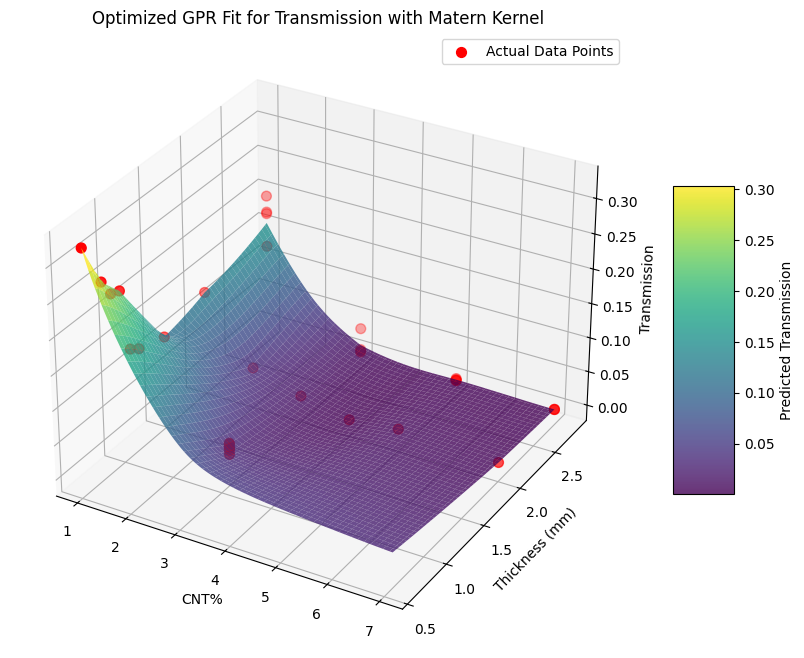

Best Transmission Model Parameters (Matern): {'length_scale': 0.5, 'length_scale_bounds': (10.0, 10000.0), 'nu': 0.5, 'loss': 0.0011041427657028989}


In [ ]:
def custom_loss_matern(y_true, y_pred, kernel):
    """
    Custom loss function to penalize spiky fits with Matern kernel.
    Rewards smoother fits with larger length_scale values.

    Parameters:
    - y_true (array): True target values.
    - y_pred (array): Predicted target values.
    - kernel: The kernel of the GPR model.

    Returns:
    - float: Computed loss.
    """
    mse = np.mean((y_true - y_pred) ** 2)  # Mean Squared Error
    length_scale = kernel.k2.length_scale  # Extract Matern length scale
    penalty = 1 / (length_scale + 1e-6)  # Penalize small length_scale values
    return mse + penalty

def grid_search_matern(thesis_df, target, grid_resolution=100):
    """
    Perform grid search to optimize hyperparameters of the Matern kernel.

    Parameters:
    - thesis_df (pd.DataFrame): The dataset containing input features and targets.
    - target (str): The target variable to predict ('absorption', 'reflection', or 'transmission').
    - grid_resolution (int): Resolution for the prediction grid.

    Returns:
    - best_model (GaussianProcessRegressor): Trained GPR model with the best Matern kernel.
    - best_params (dict): Optimal hyperparameters of the Matern kernel.
    """
    # Extract features and target
    X = thesis_df[['cnt_pct', 'thickness']].values
    y = thesis_df[f'mean_{target[0].lower()}'].values

    # Split into train and validation sets
    X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=42)

    # Hyperparameter grid
    length_scales = [0.1, 0.5, 1.0]
    length_scale_bounds = [(1e-2, 1e1), (1e-1, 1e2), (1e0, 1e3), (1e1, 1e4), (1e2, 1e5)]
    nus = [0.5, 1.5, 2.5]

    best_loss = float('inf')
    best_model = None
    best_params = None

    # Grid search
    for ls in length_scales:
        for lsb in length_scale_bounds:
            for nu in nus:
                # Define kernel
                kernel = C(1.0, (1e-3, 1e3)) * Matern(length_scale=ls, length_scale_bounds=lsb, nu=nu)
                gpr = GaussianProcessRegressor(kernel=kernel, alpha=1e-10, n_restarts_optimizer=10)
                gpr.fit(X_train, y_train)
                y_val_pred = gpr.predict(X_val)
                loss = custom_loss_matern(y_val, y_val_pred, gpr.kernel_)

                # Update best model if lower loss is found
                if loss < best_loss:
                    best_loss = loss
                    best_model = gpr
                    best_params = {
                        "length_scale": ls,
                        "length_scale_bounds": lsb,
                        "nu": nu,
                        "loss": loss,
                    }

    # Generate grid for predictions
    CNT_grid = np.linspace(thesis_df['CNT%'].min(), thesis_df['CNT%'].max(), grid_resolution)
    Thickness_grid = np.linspace(thesis_df['Thickness'].min(), thesis_df['Thickness'].max(), grid_resolution)
    CNT_grid, Thickness_grid = np.meshgrid(CNT_grid, Thickness_grid)
    X_pred = np.c_[CNT_grid.ravel(), Thickness_grid.ravel()]

    # Make predictions
    y_pred, y_std = best_model.predict(X_pred, return_std=True)
    y_pred = y_pred.reshape(CNT_grid.shape)

    # Plot the results
    fig = plt.figure(figsize=(12, 8))
    ax = fig.add_subplot(111, projection='3d')
    surf = ax.plot_surface(CNT_grid, Thickness_grid, y_pred, cmap='viridis', alpha=0.8)
    fig.colorbar(surf, shrink=0.5, aspect=5, label=f'Predicted {target.capitalize()}')

    # Overlay the actual data points
    ax.scatter(
        thesis_df['CNT%'], thesis_df['Thickness'], thesis_df[f'mean_{target[0].lower()}'],
        c='red', label='Actual Data Points', s=50
    )

    # Labels and title
    ax.set_xlabel('CNT%')
    ax.set_ylabel('Thickness (mm)')
    ax.set_zlabel(f'{target.capitalize()}')
    ax.set_title(f'Optimized GPR Fit for {target.capitalize()} with Matern Kernel')
    ax.legend()
    plt.show()

    return best_model, best_params

# Example usage for each target:
gpr_model_absorption_matern, best_params_absorption_matern = grid_search_matern(thesis_df, target="absorption")
print("Best Absorption Model Parameters (Matern):", best_params_absorption_matern)

gpr_model_reflection_matern, best_params_reflection_matern = grid_search_matern(thesis_df, target="reflection")
print("Best Reflection Model Parameters (Matern):", best_params_reflection_matern)

gpr_model_transmission_matern, best_params_transmission_matern = grid_search_matern(thesis_df, target="transmission")
print("Best Transmission Model Parameters (Matern):", best_params_transmission_matern)


Periodic + RBF

In [ ]:

def custom_loss_periodic_rbf(y_true, y_pred, kernel):
    """
    Custom loss function to penalize spiky fits with Periodic + RBF kernel.
    Rewards smoother fits with larger length_scale values.

    Parameters:
    - y_true (array): True target values.
    - y_pred (array): Predicted target values.
    - kernel: The kernel of the GPR model.

    Returns:
    - float: Computed loss.
    """
    mse = np.mean((y_true - y_pred) ** 2)  # Mean Squared Error
    length_scale_rbf = kernel.k2.k1.length_scale  # Extract RBF length scale
    periodic_length_scale = kernel.k2.k2.length_scale  # Periodic kernel length scale
    penalty = 1 / (length_scale_rbf + periodic_length_scale + 1e-6)  # Penalize small length scales
    return mse + penalty

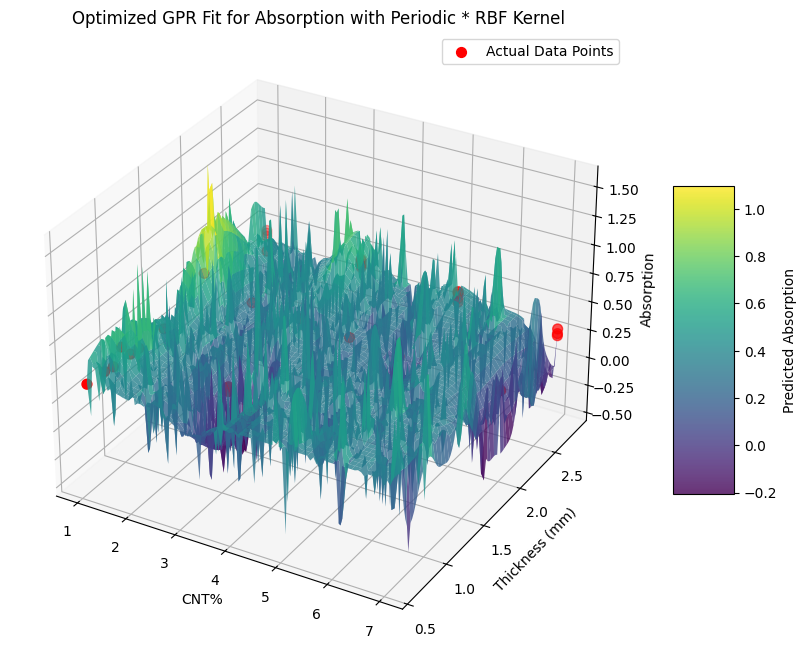

Best Absorption Model Parameters (Periodic + RBF): {'rbf_length_scale': 5.0, 'periodic_length_scale': 1.0, 'periodicity': 2.0, 'length_scale_bounds': (0.01, 100000.0), 'periodicity_bounds': (1.0, 1000.0), 'alpha': 0.01, 'loss': 0.1729945835942913}


KeyboardInterrupt: 

In [ ]:
def custom_loss_periodic_rbf(y_true, y_pred, kernel):
    residual = np.mean((y_true - y_pred) ** 2)
    # Extract kernel hyperparameters
    rbf_ls = kernel.k2.k1.length_scale  # RBF length_scale
    #periodic_ls = kernel.k2.k2.length_scale  # Periodic length_scale
    #periodicity = kernel.k2.k2.periodicity
    # Add regularization to penalize small length_scale and periodicity
    #regularization = 1 / rbf_ls  + 1 / periodicity
    return residual


def grid_search_periodic_rbf_refined(thesis_df, target, grid_resolution=100):
    """
    Perform grid search to optimize hyperparameters of the Periodic * RBF kernel with improved loss and bounds.

    Parameters:
    - thesis_df (pd.DataFrame): The dataset containing input features and targets.
    - target (str): The target variable to predict ('absorption', 'reflection', or 'transmission').
    - grid_resolution (int): Resolution for the prediction grid.

    Returns:
    - best_model (GaussianProcessRegressor): Trained GPR model with the best kernel.
    - best_params (dict): Optimal hyperparameters of the Periodic * RBF kernel.
    """
    # Extract features and target
    X = thesis_df[['cnt_pct', 'thickness']].values
    y = thesis_df[f'mean_{target[0].lower()}'].values

    # Normalize target
    y_mean, y_std = y.mean(), y.std()
    y_normalized = (y - y_mean) / y_std

    # Split into train and validation sets
    X_train, X_val, y_train, y_val = train_test_split(X, y_normalized, test_size=0.1, random_state=42)

    # Hyperparameter grid
    rbf_length_scales = [0.1, 0.5, 1.0, 2.0, 5.0]
    periodic_length_scales = [0.1, 0.5, 1.0, 2.0]
    periodic_periodicities = [0.1, 0.5, 1.0, 2.0]
    length_scale_bounds_options = [(1e-2, 1e5)]   # increase lower bound
    periodicity_bounds_options = [(1.0, 1e3)]
    alpha_values = [1e-3, 1e-2]

    best_loss = float('inf')
    best_model = None
    best_params = None

    # Grid search
    for rbf_ls in rbf_length_scales:
        for periodic_ls in periodic_length_scales:
            for periodicity in periodic_periodicities:
                for length_scale_bounds in length_scale_bounds_options:
                    for periodicity_bounds in periodicity_bounds_options:
                        for alpha in alpha_values:
                            # Define kernel
                            kernel = C(1.0, (1e-2, 1e3)) * (
                                RBF(length_scale=rbf_ls, length_scale_bounds=length_scale_bounds)
                                + ExpSineSquared(length_scale=periodic_ls, periodicity=periodicity,
                                                 length_scale_bounds=length_scale_bounds,
                                                 periodicity_bounds=periodicity_bounds)
                            )
                            gpr = GaussianProcessRegressor(kernel=kernel, alpha=alpha, n_restarts_optimizer=10)
                            gpr.fit(X_train, y_train)
                            y_val_pred = gpr.predict(X_val)
                            loss = custom_loss_periodic_rbf(y_val, y_val_pred, gpr.kernel_)

                            # Update best model
                            if loss < best_loss:
                                best_loss = loss
                                best_model = gpr
                                best_params = {
                                    "rbf_length_scale": rbf_ls,
                                    "periodic_length_scale": periodic_ls,
                                    "periodicity": periodicity,
                                    "length_scale_bounds": length_scale_bounds,
                                    "periodicity_bounds": periodicity_bounds,
                                    "alpha": alpha,
                                    "loss": loss,
                                }

    # Visualization (same as previous)
    # Generate grid for predictions
    CNT_grid = np.linspace(thesis_df['CNT%'].min(), thesis_df['CNT%'].max(), grid_resolution)
    Thickness_grid = np.linspace(thesis_df['Thickness'].min(), thesis_df['Thickness'].max(), grid_resolution)
    CNT_grid, Thickness_grid = np.meshgrid(CNT_grid, Thickness_grid)
    X_pred = np.c_[CNT_grid.ravel(), Thickness_grid.ravel()]

    # Make predictions
    y_pred, y_std = best_model.predict(X_pred, return_std=True)

    # Reshape both predictions and standard deviations to match the grid
    y_pred = y_pred.reshape(CNT_grid.shape)
    y_std = y_std.reshape(CNT_grid.shape)

    # Plot results
    fig = plt.figure(figsize=(12, 8))
    ax = fig.add_subplot(111, projection='3d')

    # Adjust plotting to include predictions and uncertainty
    surf = ax.plot_surface(
        CNT_grid, Thickness_grid, y_pred * y_std + y_mean, cmap='viridis', alpha=0.8
    )
    fig.colorbar(surf, shrink=0.5, aspect=5, label=f'Predicted {target.capitalize()}')

    # Overlay the actual data points
    ax.scatter(
        thesis_df['CNT%'], thesis_df['Thickness'], thesis_df[f'mean_{target[0].lower()}'],
        c='red', label='Actual Data Points', s=50
    )

    # Labels and title
    ax.set_xlabel('CNT%')
    ax.set_ylabel('Thickness (mm)')
    ax.set_zlabel(f'{target.capitalize()}')
    ax.set_title(f'Optimized GPR Fit for {target.capitalize()} with Periodic * RBF Kernel')
    ax.legend()
    plt.show()


    return best_model, best_params

# Example usage for each target:
gpr_model_absorption_prbf, best_params_absorption_prbf = grid_search_periodic_rbf_refined(thesis_df, target="absorption")
print("Best Absorption Model Parameters (Periodic + RBF):", best_params_absorption_prbf)

gpr_model_reflection_prbf, best_params_reflection_prbf = grid_search_periodic_rbf_refined(thesis_df, target="reflection")
print("Best Reflection Model Parameters (Periodic + RBF):", best_params_reflection_prbf)

gpr_model_transmission_prbf, best_params_transmission_prbf = grid_search_periodic_rbf_refined(thesis_df, target="transmission")
print("Best Transmission Model Parameters (Periodic + RBF):", best_params_transmission_prbf)


RBF + Periodic

Training and saving RBF + Periodic model for: Absorption
Model saved to: /content/drive/MyDrive/Thesis_Updated/Models/absorption_gpr_model_rbf_plus_periodic.pkl


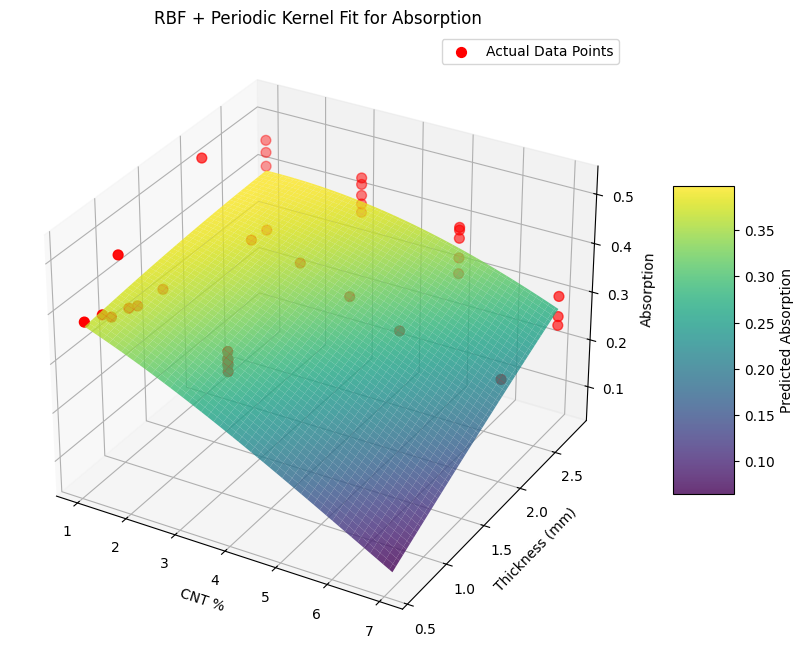

Training and saving RBF + Periodic model for: Reflection
Model saved to: /content/drive/MyDrive/Thesis_Updated/Models/reflection_gpr_model_rbf_plus_periodic.pkl


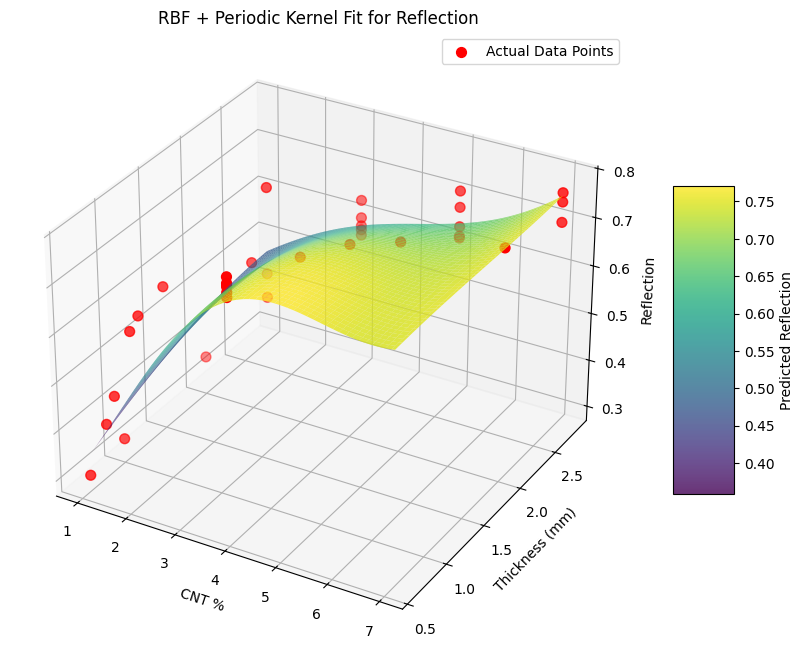

Training and saving RBF + Periodic model for: Transmission
Model saved to: /content/drive/MyDrive/Thesis_Updated/Models/transmission_gpr_model_rbf_plus_periodic.pkl


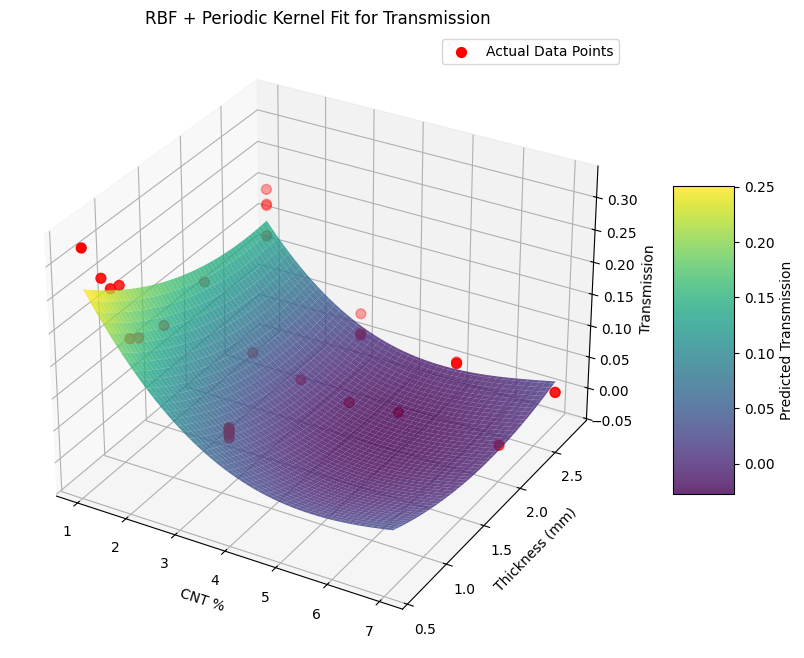

Absorption Model Uncertainty: {'mean_uncertainty_physical_region': np.float64(0.015166896492901373), 'mean_uncertainty_extended_region': np.float64(0.45147397670044637)}
Reflection Model Uncertainty: {'mean_uncertainty_physical_region': np.float64(0.024487684777188642), 'mean_uncertainty_extended_region': np.float64(0.41464930539682127)}
Transmission Model Uncertainty: {'mean_uncertainty_physical_region': np.float64(0.018498287844242407), 'mean_uncertainty_extended_region': np.float64(1.0294099696792658)}


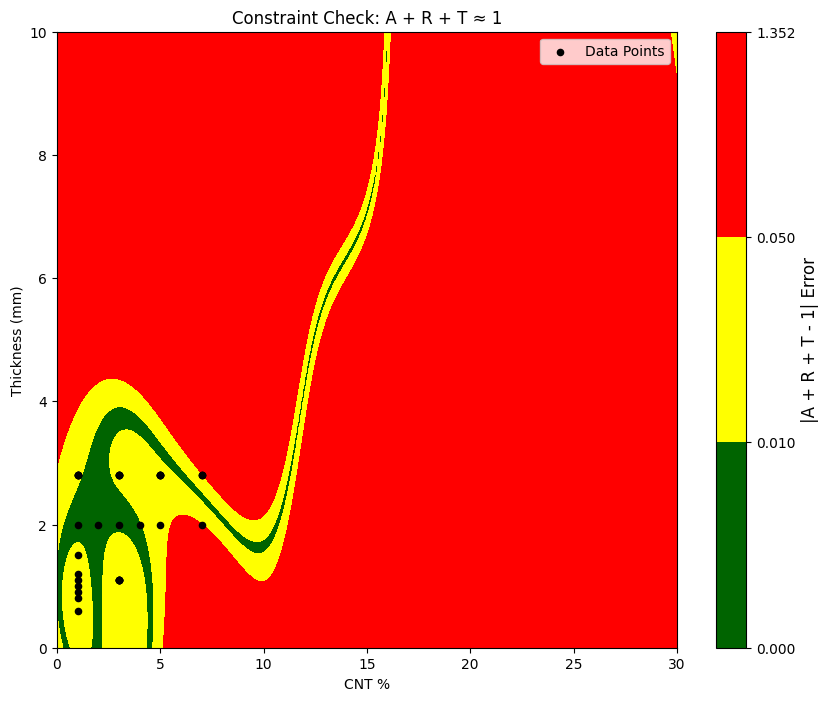

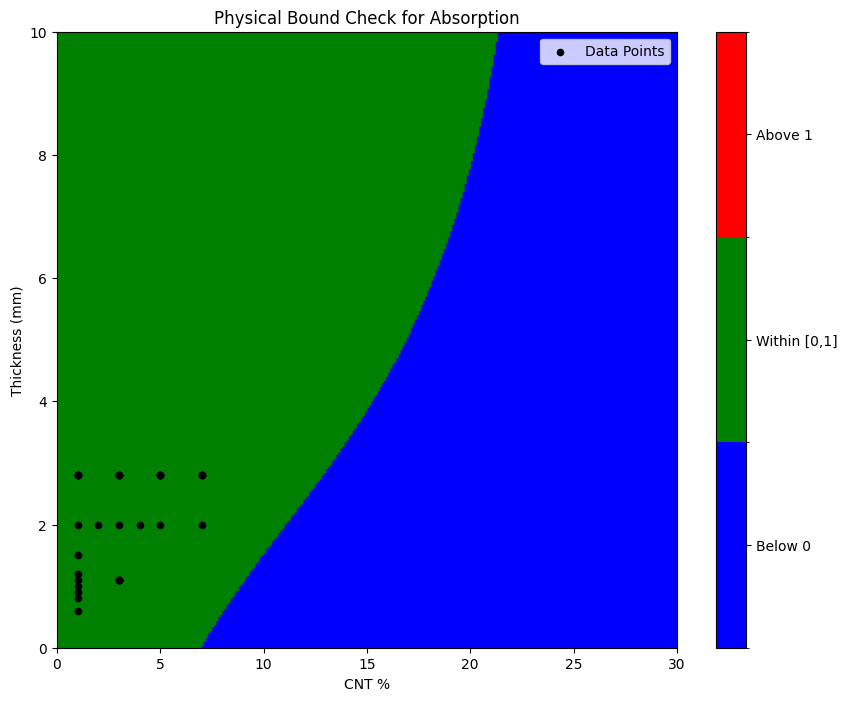

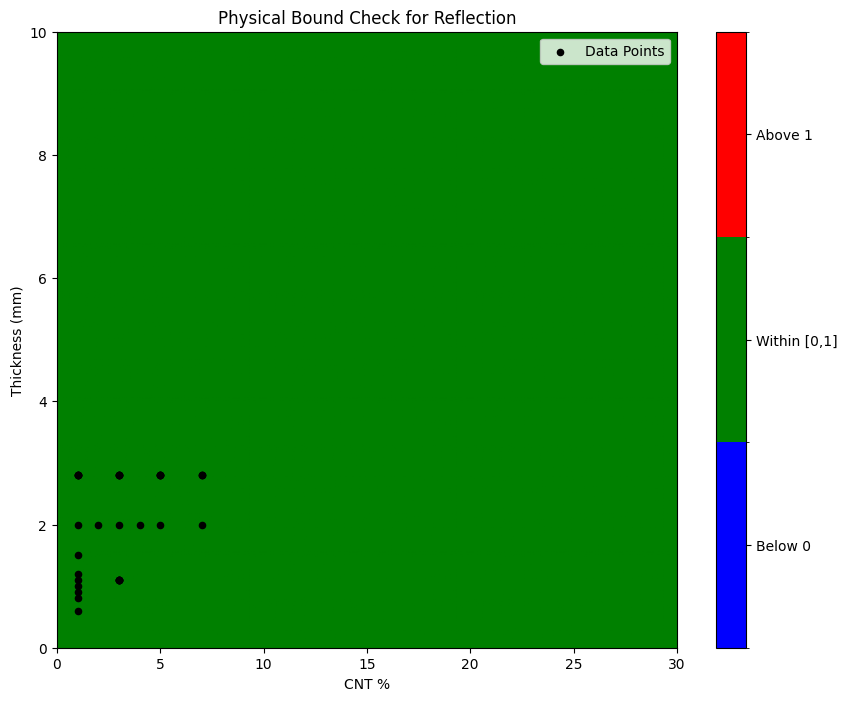

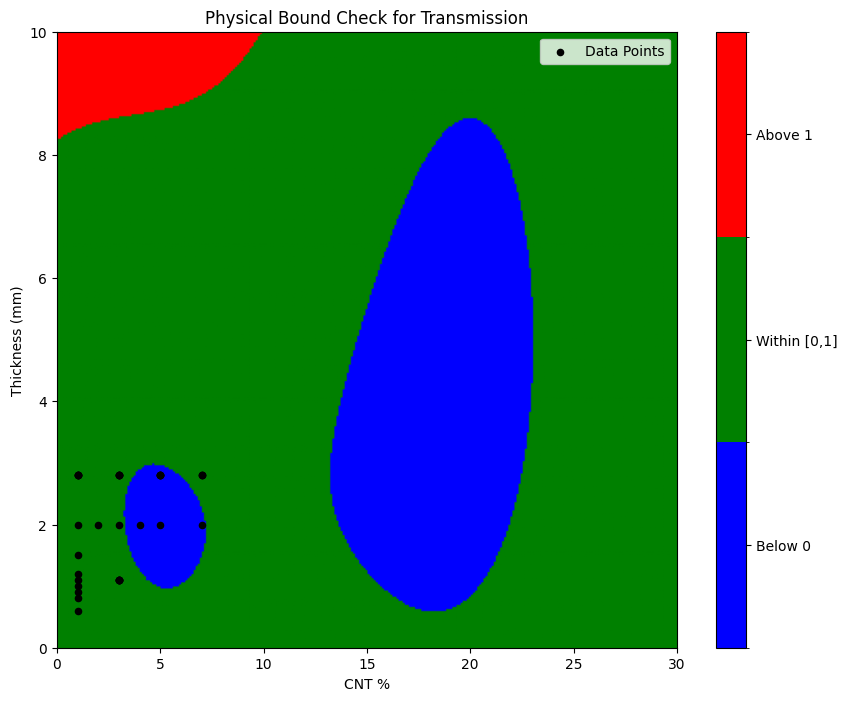

In [42]:
def train_and_save_rbf_plus_periodic_models(thesis_df, target_params_dict, base_path):
    """
    Train, plot, and save GPR models with RBF + Periodic kernel for each target.

    Parameters:
    - thesis_df (pd.DataFrame): Dataset with features and targets.
    - target_params_dict (dict): Optimal hyperparameters for each target.
    - base_path (str): Path to save the trained models.

    Returns:
    - models_dict (dict): Trained GPR models.
    """
    import numpy as np
    import joblib
    import matplotlib.pyplot as plt
    from sklearn.gaussian_process import GaussianProcessRegressor
    from sklearn.gaussian_process.kernels import RBF, ExpSineSquared, ConstantKernel as C
    from sklearn.model_selection import train_test_split

    models_dict = {}

    for target, params in target_params_dict.items():
        print(f"Training and saving RBF + Periodic model for: {target.capitalize()}")

        X = thesis_df[['cnt_pct', 'thickness']].values
        y = thesis_df[f'mean_{target[0].lower()}'].values

        X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=42)

        kernel = C(1.0, (1e-2, 1e3)) * (
            RBF(length_scale=params['rbf_length_scale'], length_scale_bounds=params['length_scale_bounds'])
            + ExpSineSquared(length_scale=params['periodic_length_scale'],
                             periodicity=params['periodicity'],
                             length_scale_bounds=params['length_scale_bounds'],
                             periodicity_bounds=params['periodicity_bounds'])
        )

        gpr = GaussianProcessRegressor(kernel=kernel, alpha=params['alpha'], n_restarts_optimizer=10)
        gpr.fit(X_train, y_train)

        model_path = f"{base_path}/{target}_gpr_model_rbf_plus_periodic.pkl"
        joblib.dump(gpr, model_path)
        print(f"Model saved to: {model_path}")

        models_dict[target] = gpr

        # Plot Prediction Surface
        CNT_grid = np.linspace(thesis_df['cnt_pct'].min(), thesis_df['cnt_pct'].max(), 100)
        Thickness_grid = np.linspace(thesis_df['thickness'].min(), thesis_df['thickness'].max(), 100)
        CNT_grid, Thickness_grid = np.meshgrid(CNT_grid, Thickness_grid)
        X_pred = np.c_[CNT_grid.ravel(), Thickness_grid.ravel()]
        y_pred = gpr.predict(X_pred).reshape(CNT_grid.shape)

        fig = plt.figure(figsize=(12, 8))
        ax = fig.add_subplot(111, projection='3d')
        surf = ax.plot_surface(CNT_grid, Thickness_grid, y_pred, cmap='viridis', alpha=0.8)
        fig.colorbar(surf, shrink=0.5, aspect=5, label=f'Predicted {target.capitalize()}')

        ax.scatter(thesis_df['cnt_pct'], thesis_df['thickness'], y, c='red', label='Actual Data Points', s=50)
        ax.set_xlabel('CNT %')
        ax.set_ylabel('Thickness (mm)')
        ax.set_zlabel(target.capitalize())
        ax.set_title(f'RBF + Periodic Kernel Fit for {target.capitalize()}')
        ax.legend()
        plt.show()

    return models_dict
rbf_plus_periodic_target_params_dict = {
    "absorption": {
        "rbf_length_scale": 0.1,
        "periodic_length_scale": 0.1,
        "periodicity": 5.0,
        "length_scale_bounds": (10.0, 100000.0),
        "periodicity_bounds": (1.0, 1000.0),
        "alpha": 0.001,
        "loss": 0.1717547030139136
    },
    "reflection": {
        "rbf_length_scale": 5.0,
        "periodic_length_scale": 2.0,
        "periodicity": 5.0,
        "length_scale_bounds": (10.0, 100000.0),
        "periodicity_bounds": (1.0, 1000.0),
        "alpha": 0.001,
        "loss": 0.08517931731321356
    },
    "transmission": {
        "rbf_length_scale": 5.0,
        "periodic_length_scale": 2.0,
        "periodicity": 1.0,
        "length_scale_bounds": (10.0, 100000.0),
        "periodicity_bounds": (1.0, 1000.0),
        "alpha": 0.001,
        "loss": 0.0206196547721341
    }
}
base_path = '/content/drive/MyDrive/Thesis_Updated/Models'

models_dict_rbf_plus_periodic = train_and_save_rbf_plus_periodic_models(thesis_df, rbf_plus_periodic_target_params_dict, base_path)

physical_bounds = ((1.0, 7.0), (0.6, 2.8))
extended_bounds = ((0.0, 30.0), (0.0, 10.0))

uncertainty_absorption_rbf_plus_periodic = compute_average_uncertainty(models_dict_rbf_plus_periodic['absorption'], thesis_df, physical_bounds, extended_bounds)
uncertainty_reflection_rbf_plus_periodic = compute_average_uncertainty(models_dict_rbf_plus_periodic['reflection'], thesis_df,physical_bounds, extended_bounds)
uncertainty_transmission_rbf_plus_periodic = compute_average_uncertainty(models_dict_rbf_plus_periodic['transmission'], thesis_df,physical_bounds, extended_bounds)

print("Absorption Model Uncertainty:", uncertainty_absorption_rbf_plus_periodic)
print("Reflection Model Uncertainty:", uncertainty_reflection_rbf_plus_periodic)
print("Transmission Model Uncertainty:", uncertainty_transmission_rbf_plus_periodic)

plot_sum_constraint(models_dict_rbf_plus_periodic, thesis_df, extended_bounds)
plot_physical_bounds(models_dict_rbf_plus_periodic, thesis_df, extended_bounds)



Training and saving Periodic * RBF model for: Absorption
Model saved to: /content/drive/MyDrive/Thesis_Updated/Models/absorption_gpr_model_prbf.pkl


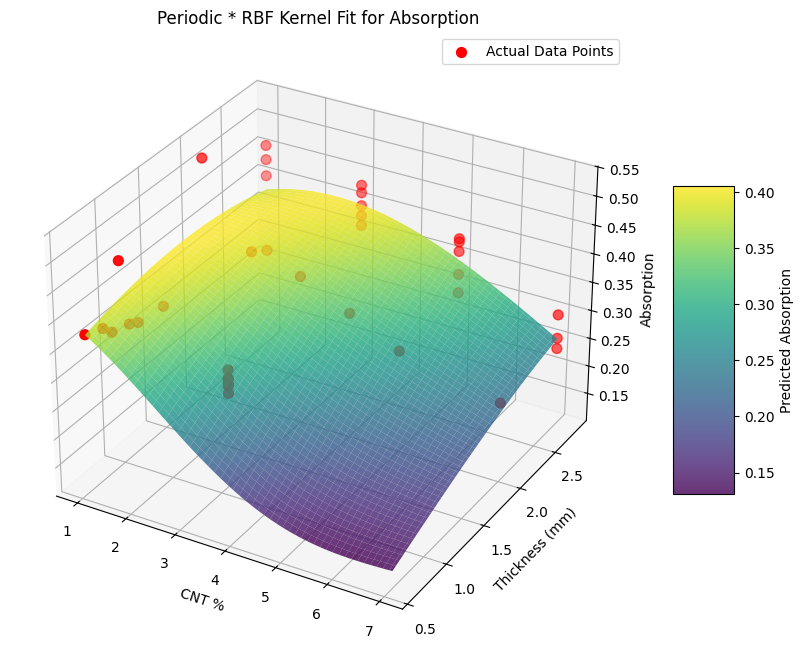

Training and saving Periodic * RBF model for: Reflection
Model saved to: /content/drive/MyDrive/Thesis_Updated/Models/reflection_gpr_model_prbf.pkl


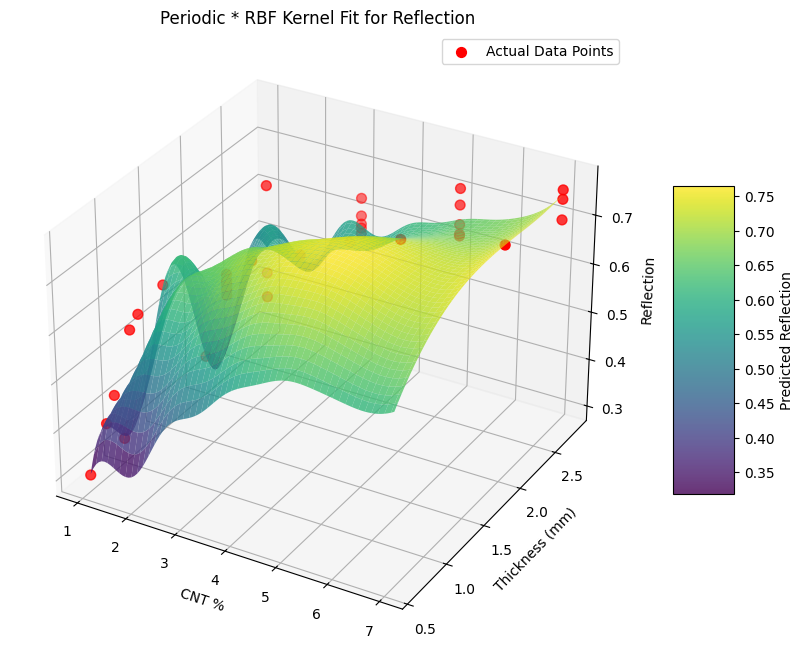

Training and saving Periodic * RBF model for: Transmission
Model saved to: /content/drive/MyDrive/Thesis_Updated/Models/transmission_gpr_model_prbf.pkl


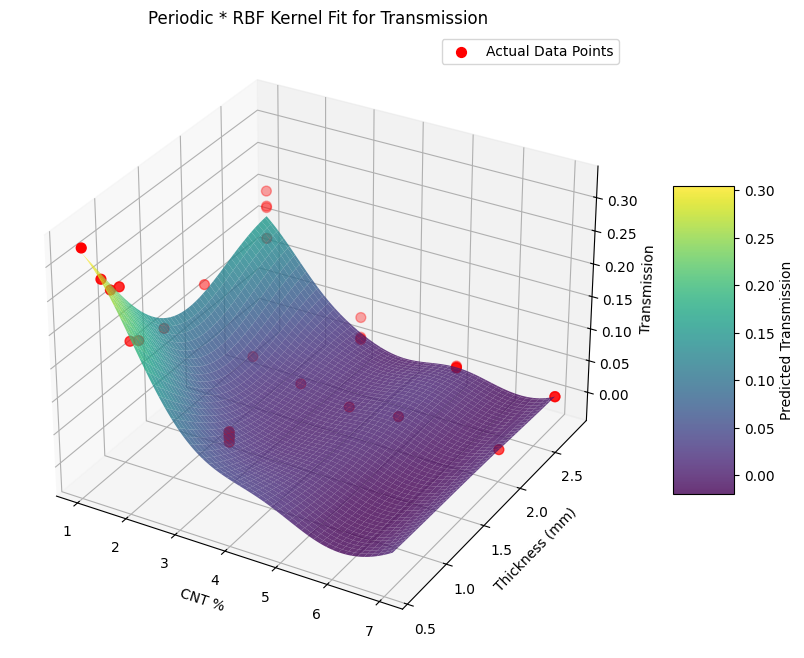

Absorption Model Uncertainty: {'mean_uncertainty_physical_region': np.float64(0.020705196858133348), 'mean_uncertainty_extended_region': np.float64(0.21376868974199756)}
Reflection Model Uncertainty: {'mean_uncertainty_physical_region': np.float64(0.7720266316984555), 'mean_uncertainty_extended_region': np.float64(46.362316560890946)}
Transmission Model Uncertainty: {'mean_uncertainty_physical_region': np.float64(0.03254611901612486), 'mean_uncertainty_extended_region': np.float64(0.19370231627488804)}


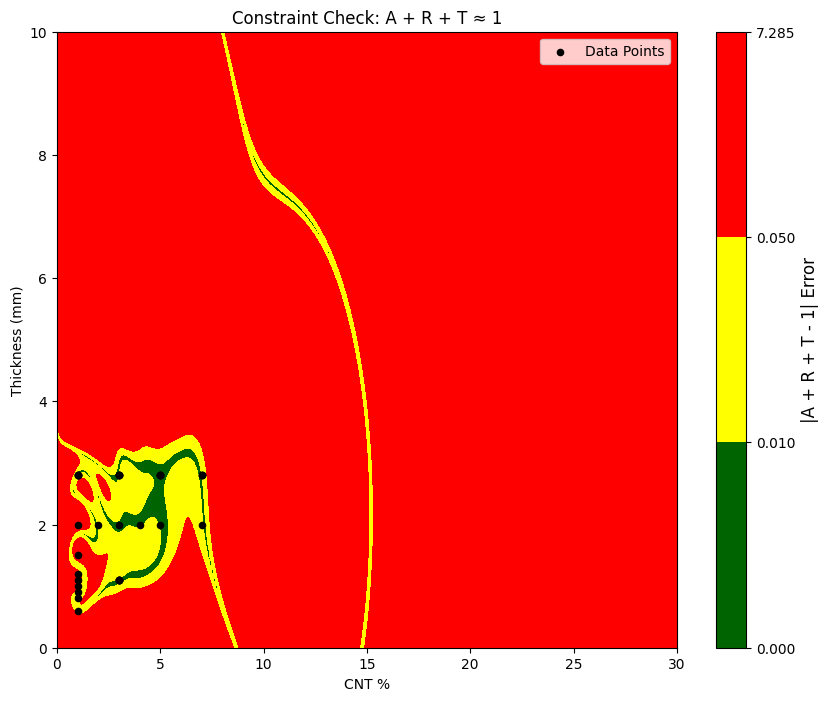

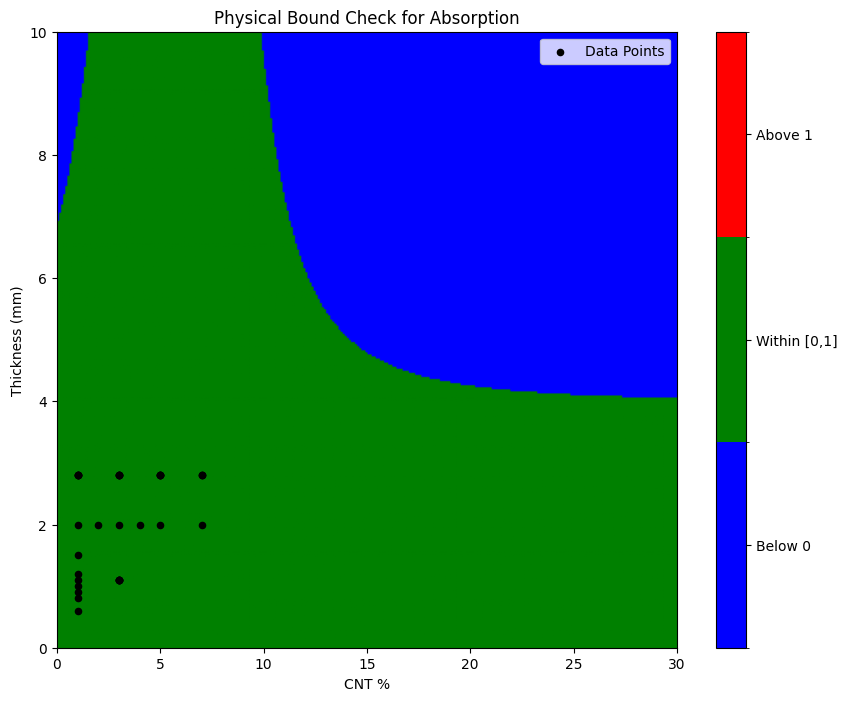

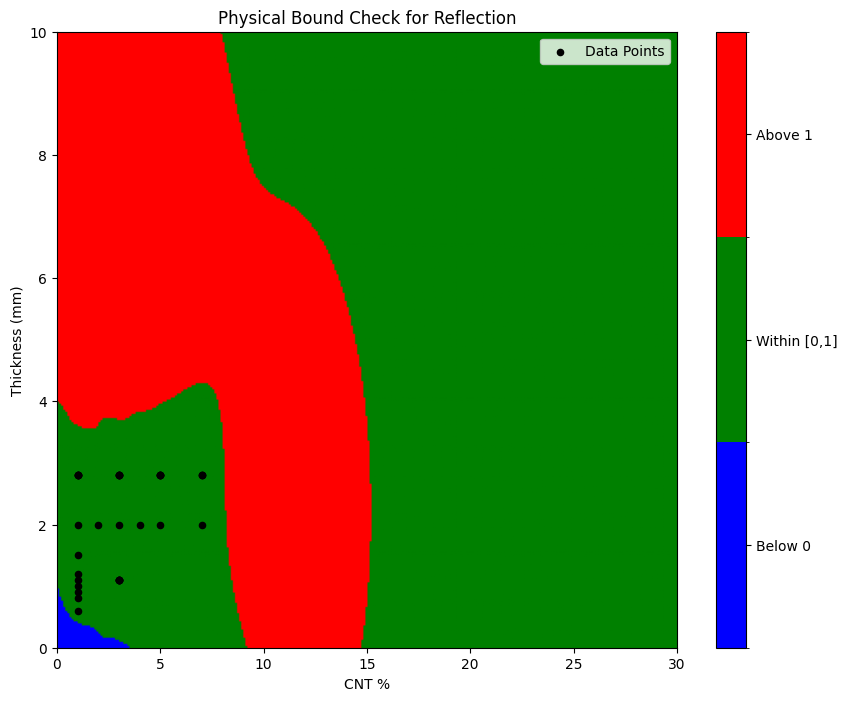

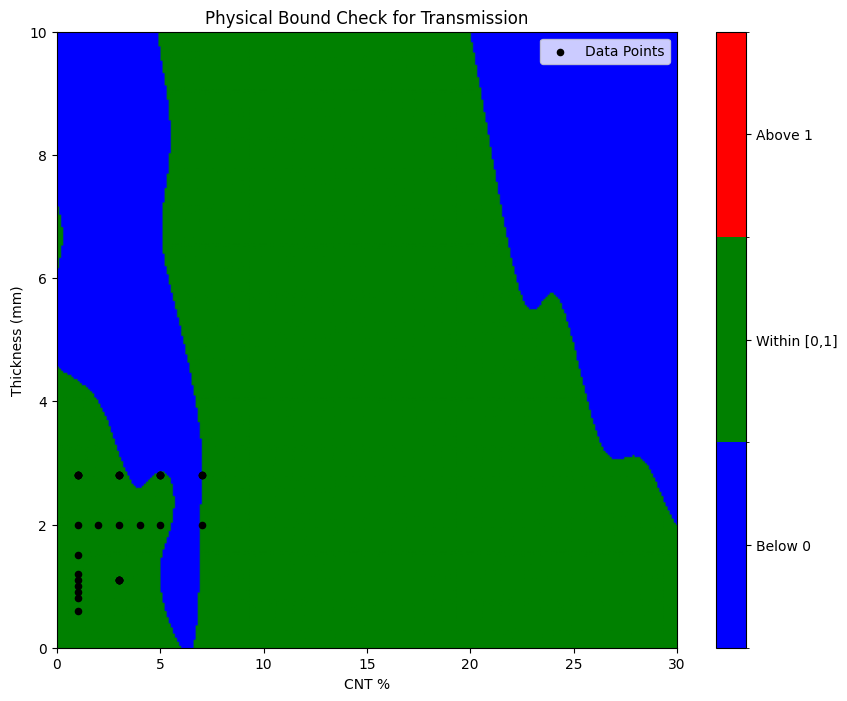

In [40]:
def train_and_save_periodic_rbf_models(thesis_df, target_params_dict, base_path):
    """
    Train, plot, and save GPR models with Periodic * RBF kernel for each target.

    Parameters:
    - thesis_df (pd.DataFrame): Dataset with features and targets.
    - target_params_dict (dict): Optimal hyperparameters for each target.
    - base_path (str): Path to save the trained models.

    Returns:
    - models_dict (dict): Trained GPR models.
    """
    import numpy as np
    import joblib
    import matplotlib.pyplot as plt
    from sklearn.gaussian_process import GaussianProcessRegressor
    from sklearn.gaussian_process.kernels import RBF, ExpSineSquared, ConstantKernel as C
    from sklearn.model_selection import train_test_split

    models_dict = {}

    for target, params in target_params_dict.items():
        print(f"Training and saving Periodic * RBF model for: {target.capitalize()}")

        X = thesis_df[['cnt_pct', 'thickness']].values
        y = thesis_df[f'mean_{target[0].lower()}'].values

        X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=42)

        kernel = C(1.0, (1e-5, 1e5)) * (
            RBF(length_scale=params['rbf_length_scale'], length_scale_bounds=params['length_scale_bounds'])
            * ExpSineSquared(length_scale=params['periodic_length_scale'],
                             periodicity=params['periodicity'],
                             length_scale_bounds=params['length_scale_bounds'],
                             periodicity_bounds=params['periodicity_bounds'])
        )

        gpr = GaussianProcessRegressor(kernel=kernel, alpha=params['alpha'], n_restarts_optimizer=10)
        gpr.fit(X_train, y_train)

        model_path = f"{base_path}/{target}_gpr_model_prbf.pkl"
        joblib.dump(gpr, model_path)
        print(f"Model saved to: {model_path}")

        models_dict[target] = gpr

        # Plot Prediction Surface
        CNT_grid = np.linspace(thesis_df['cnt_pct'].min(), thesis_df['cnt_pct'].max(), 100)
        Thickness_grid = np.linspace(thesis_df['thickness'].min(), thesis_df['thickness'].max(), 100)
        CNT_grid, Thickness_grid = np.meshgrid(CNT_grid, Thickness_grid)
        X_pred = np.c_[CNT_grid.ravel(), Thickness_grid.ravel()]
        y_pred = gpr.predict(X_pred).reshape(CNT_grid.shape)

        fig = plt.figure(figsize=(12, 8))
        ax = fig.add_subplot(111, projection='3d')
        surf = ax.plot_surface(CNT_grid, Thickness_grid, y_pred, cmap='viridis', alpha=0.8)
        fig.colorbar(surf, shrink=0.5, aspect=5, label=f'Predicted {target.capitalize()}')

        ax.scatter(thesis_df['cnt_pct'], thesis_df['thickness'], y, c='red', label='Actual Data Points', s=50)
        ax.set_xlabel('CNT %')
        ax.set_ylabel('Thickness (mm)')
        ax.set_zlabel(target.capitalize())
        ax.set_title(f'Periodic * RBF Kernel Fit for {target.capitalize()}')
        ax.legend()
        plt.show()

    return models_dict

periodic_rbf_target_params_dict = {
    "absorption": {
        "rbf_length_scale": 0.1,
        "periodic_length_scale": 0.5,
        "periodicity": 0.5,
        "length_scale_bounds": (3.5, 100000.0),
        "periodicity_bounds": (0.1, 1000.0),
        "alpha": 0.001,
        "loss": 0.47171290341044714
    },
    "reflection": {
        "rbf_length_scale": 0.1,
        "periodic_length_scale": 0.1,
        "periodicity": 2.0,
        "length_scale_bounds": (3.5, 100000.0),
        "periodicity_bounds": (0.1, 1000.0),
        "alpha": 0.0001,
        "loss": 0.37175888022321746
    },
    "transmission": {
        "rbf_length_scale": 0.5,
        "periodic_length_scale": 0.5,
        "periodicity": 5.0,
        "length_scale_bounds": (3.5, 100000.0),
        "periodicity_bounds": (0.1, 1000.0),
        "alpha": 0.0001,
        "loss": 0.30483412820648936
    }
}

base_path = '/content/drive/MyDrive/Thesis_Updated/Models'

models_dict_prbf = train_and_save_periodic_rbf_models(thesis_df, periodic_rbf_target_params_dict, base_path)

physical_bounds = ((1.0, 7.0), (0.6, 2.8))
extended_bounds = ((0.0, 30.0), (0.0, 10.0))

uncertainty_absorption_prbf = compute_average_uncertainty(models_dict_prbf['absorption'], thesis_df, physical_bounds, extended_bounds)
uncertainty_reflection_prbf = compute_average_uncertainty(models_dict_prbf['reflection'], thesis_df,physical_bounds, extended_bounds)
uncertainty_transmission_prbf = compute_average_uncertainty(models_dict_prbf['transmission'], thesis_df,physical_bounds, extended_bounds)

print("Absorption Model Uncertainty:", uncertainty_absorption_prbf)
print("Reflection Model Uncertainty:", uncertainty_reflection_prbf)
print("Transmission Model Uncertainty:", uncertainty_transmission_prbf)

plot_sum_constraint(models_dict_prbf, thesis_df, extended_bounds)
plot_physical_bounds(models_dict_prbf, thesis_df, extended_bounds)


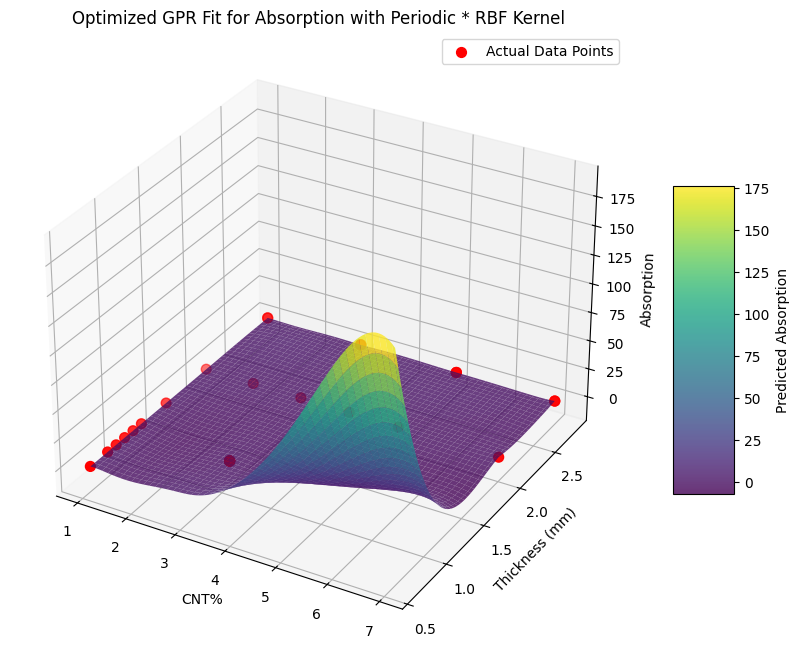

Best Absorption Model Parameters (Periodic + RBF): {'rbf_length_scale': 0.1, 'periodic_length_scale': 0.5, 'periodicity': 0.5, 'length_scale_bounds': (3.5, 100000.0), 'periodicity_bounds': (0.1, 1000.0), 'alpha': 0.001, 'loss': 0.47171290341044714}


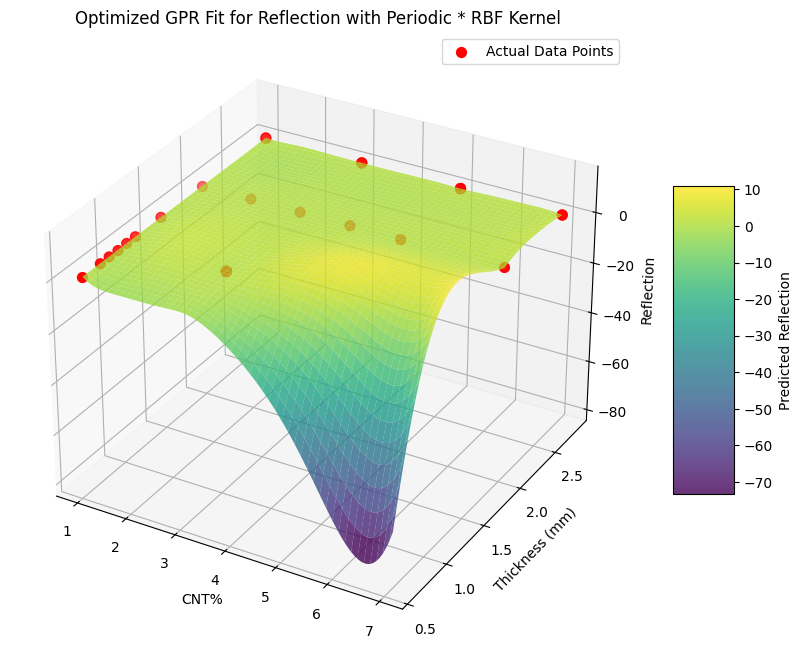

Best Reflection Model Parameters (Periodic + RBF): {'rbf_length_scale': 0.1, 'periodic_length_scale': 0.1, 'periodicity': 2.0, 'length_scale_bounds': (3.5, 100000.0), 'periodicity_bounds': (0.1, 1000.0), 'alpha': 0.0001, 'loss': 0.37175888022321746}


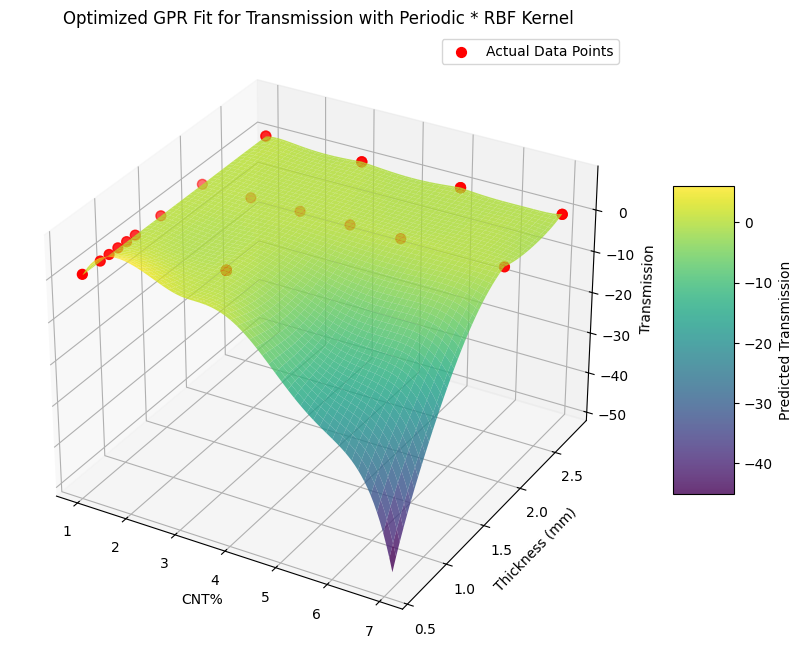

Best Transmission Model Parameters (Periodic + RBF): {'rbf_length_scale': 0.5, 'periodic_length_scale': 0.5, 'periodicity': 5.0, 'length_scale_bounds': (3.5, 100000.0), 'periodicity_bounds': (0.1, 1000.0), 'alpha': 0.0001, 'loss': 0.30483412820648936}


In [ ]:
def custom_loss_periodic_rbf(y_true, y_pred, kernel):
    residual = np.mean((y_true - y_pred) ** 2)
    # Extract kernel hyperparameters
    rbf_ls = kernel.k2.k1.length_scale  # RBF length_scale
    periodic_ls = kernel.k2.k2.length_scale  # Periodic length_scale
    periodicity = kernel.k2.k2.periodicity
    # Add regularization to penalize small length_scale and periodicity
    regularization = 1 / rbf_ls + 1 / periodic_ls + 1 / periodicity
    return residual + regularization


def grid_search_periodic_rbf_refined(thesis_df, target, grid_resolution=100):
    """
    Perform grid search to optimize hyperparameters of the Periodic * RBF kernel with improved loss and bounds.

    Parameters:
    - thesis_df (pd.DataFrame): The dataset containing input features and targets.
    - target (str): The target variable to predict ('absorption', 'reflection', or 'transmission').
    - grid_resolution (int): Resolution for the prediction grid.

    Returns:
    - best_model (GaussianProcessRegressor): Trained GPR model with the best kernel.
    - best_params (dict): Optimal hyperparameters of the Periodic * RBF kernel.
    """
    # Extract features and target
    X = thesis_df[['cnt_pct', 'thickness']].values
    y = thesis_df[f'mean_{target[0].lower()}'].values

    # Normalize target
    y_mean, y_std = y.mean(), y.std()
    y_normalized = (y - y_mean) / y_std

    # Split into train and validation sets
    X_train, X_val, y_train, y_val = train_test_split(X, y_normalized, test_size=0.1, random_state=42)

    # Hyperparameter grid
    rbf_length_scales = [0.1, 0.2,0.5]
    periodic_length_scales = [0.1, 0.5, 1.0]
    periodic_periodicities = [0.1, 0.5, 1.0, 2.0, 5.0]
    length_scale_bounds_options = [(2.5, 1e5)]
    periodicity_bounds_options = [(1e-1, 1e3)]
    alpha_values = [1e-3, 1e-4]

    best_loss = float('inf')
    best_model = None
    best_params = None

    # Grid search
    for rbf_ls in rbf_length_scales:
        for periodic_ls in periodic_length_scales:
            for periodicity in periodic_periodicities:
                for length_scale_bounds in length_scale_bounds_options:
                    for periodicity_bounds in periodicity_bounds_options:
                        for alpha in alpha_values:
                            # Define kernel
                            kernel = C(1.0, (1e-5, 1e5)) * (
                                RBF(length_scale=rbf_ls, length_scale_bounds=length_scale_bounds)
                                * ExpSineSquared(length_scale=periodic_ls, periodicity=periodicity,
                                                 length_scale_bounds=length_scale_bounds,
                                                 periodicity_bounds=periodicity_bounds)
                            )
                            gpr = GaussianProcessRegressor(kernel=kernel, alpha=alpha, n_restarts_optimizer=10)
                            gpr.fit(X_train, y_train)
                            y_val_pred = gpr.predict(X_val)
                            loss = custom_loss_periodic_rbf(y_val, y_val_pred, gpr.kernel_)

                            # Update best model
                            if loss < best_loss:
                                best_loss = loss
                                best_model = gpr
                                best_params = {
                                    "rbf_length_scale": rbf_ls,
                                    "periodic_length_scale": periodic_ls,
                                    "periodicity": periodicity,
                                    "length_scale_bounds": length_scale_bounds,
                                    "periodicity_bounds": periodicity_bounds,
                                    "alpha": alpha,
                                    "loss": loss,
                                }

    # Visualization (same as previous)
    # Generate grid for predictions
    CNT_grid = np.linspace(thesis_df['CNT%'].min(), thesis_df['CNT%'].max(), grid_resolution)
    Thickness_grid = np.linspace(thesis_df['Thickness'].min(), thesis_df['Thickness'].max(), grid_resolution)
    CNT_grid, Thickness_grid = np.meshgrid(CNT_grid, Thickness_grid)
    X_pred = np.c_[CNT_grid.ravel(), Thickness_grid.ravel()]

    # Make predictions
    y_pred, y_std = best_model.predict(X_pred, return_std=True)

    # Reshape both predictions and standard deviations to match the grid
    y_pred = y_pred.reshape(CNT_grid.shape)
    y_std = y_std.reshape(CNT_grid.shape)

    # Plot results
    fig = plt.figure(figsize=(12, 8))
    ax = fig.add_subplot(111, projection='3d')

    # Adjust plotting to include predictions and uncertainty
    surf = ax.plot_surface(
        CNT_grid, Thickness_grid, y_pred * y_std + y_mean, cmap='viridis', alpha=0.8
    )
    fig.colorbar(surf, shrink=0.5, aspect=5, label=f'Predicted {target.capitalize()}')

    # Overlay the actual data points
    ax.scatter(
        thesis_df['CNT%'], thesis_df['Thickness'], thesis_df[f'mean_{target[0].lower()}'],
        c='red', label='Actual Data Points', s=50
    )

    # Labels and title
    ax.set_xlabel('CNT%')
    ax.set_ylabel('Thickness (mm)')
    ax.set_zlabel(f'{target.capitalize()}')
    ax.set_title(f'Optimized GPR Fit for {target.capitalize()} with Periodic * RBF Kernel')
    ax.legend()
    plt.show()


    return best_model, best_params

# Example usage for each target:
gpr_model_absorption_prbf, best_params_absorption_prbf = grid_search_periodic_rbf_refined(thesis_df, target="absorption")
print("Best Absorption Model Parameters (Periodic + RBF):", best_params_absorption_prbf)

gpr_model_reflection_prbf, best_params_reflection_prbf = grid_search_periodic_rbf_refined(thesis_df, target="reflection")
print("Best Reflection Model Parameters (Periodic + RBF):", best_params_reflection_prbf)

gpr_model_transmission_prbf, best_params_transmission_prbf = grid_search_periodic_rbf_refined(thesis_df, target="transmission")
print("Best Transmission Model Parameters (Periodic + RBF):", best_params_transmission_prbf)


Periodic

Training and saving Periodic model for: Absorption
Model saved to: /content/drive/MyDrive/Thesis_Updated/Models/absorption_gpr_model_periodic.pkl
Training and saving Periodic model for: Reflection
Model saved to: /content/drive/MyDrive/Thesis_Updated/Models/reflection_gpr_model_periodic.pkl
Training and saving Periodic model for: Transmission
Model saved to: /content/drive/MyDrive/Thesis_Updated/Models/transmission_gpr_model_periodic.pkl
Absorption Model Uncertainty: {'mean_uncertainty_physical_region': np.float64(0.021411653274582054), 'mean_uncertainty_extended_region': np.float64(0.25214764148474356)}
Reflection Model Uncertainty: {'mean_uncertainty_physical_region': np.float64(0.034873554647471515), 'mean_uncertainty_extended_region': np.float64(0.02461224858655747)}
Transmission Model Uncertainty: {'mean_uncertainty_physical_region': np.float64(0.027964375843216482), 'mean_uncertainty_extended_region': np.float64(0.09577423348086446)}


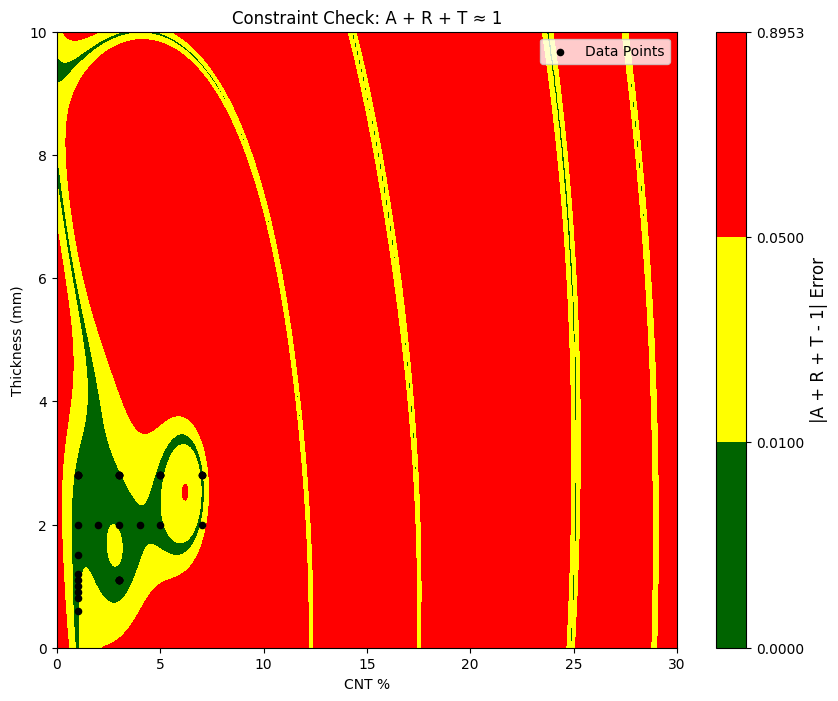

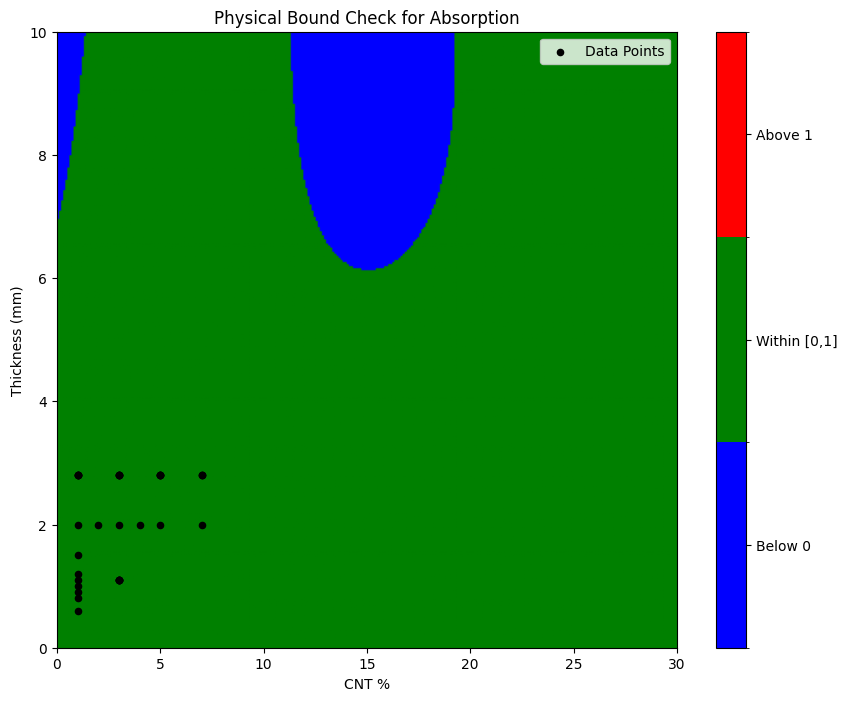

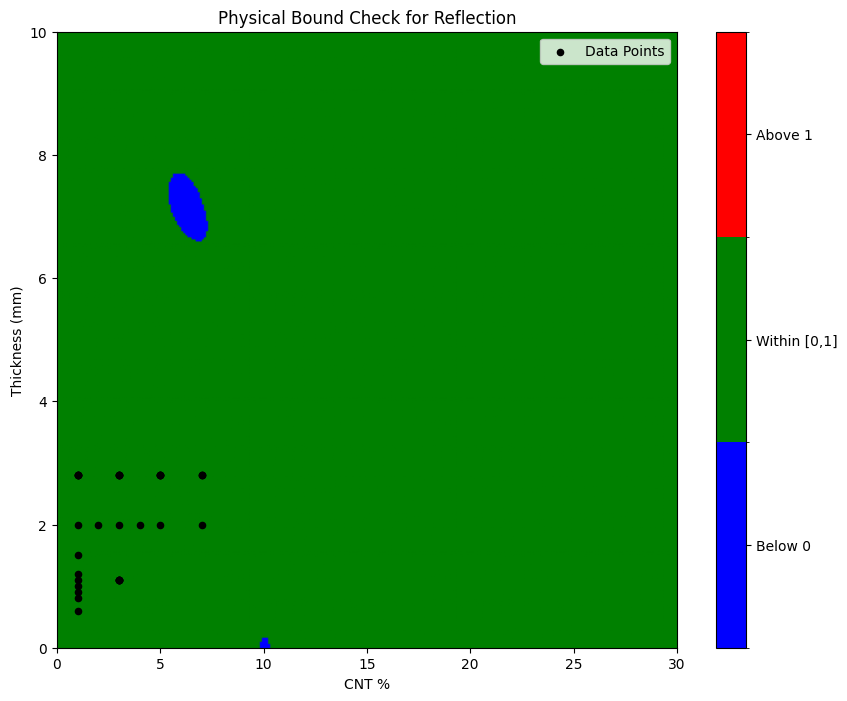

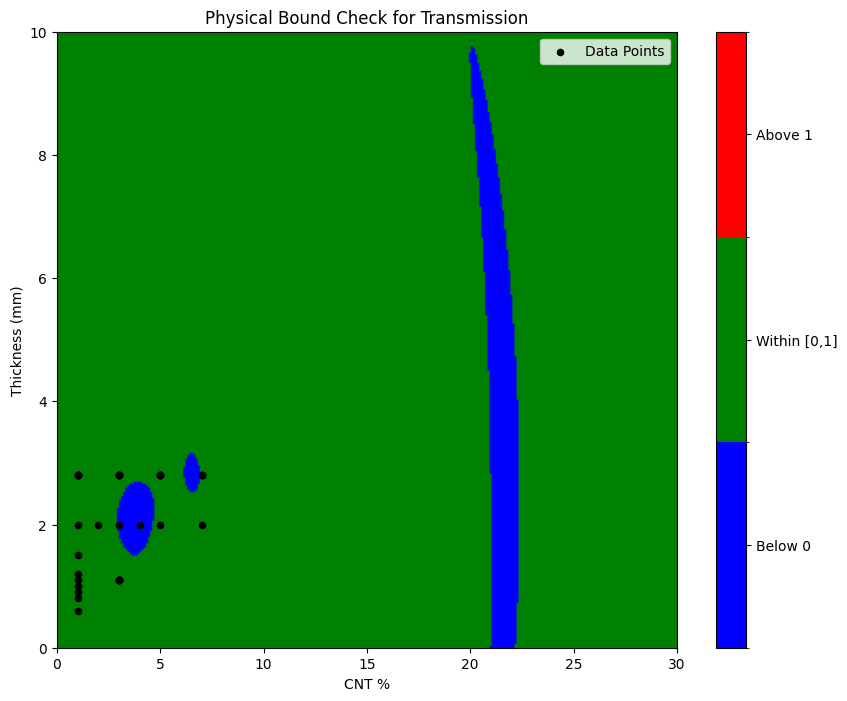

In [37]:
def train_and_save_periodic_models(thesis_df, target_params_dict, base_path):
    """
    Train and save GPR models with Periodic (ExpSineSquared) kernel for each target.

    Parameters:
    - thesis_df (pd.DataFrame): Dataset with features and targets.
    - target_params_dict (dict): Optimal hyperparameters for each target.
    - base_path (str): Path to save the trained models.

    Returns:
    - models_dict (dict): Trained GPR models.
    """
    import numpy as np
    import joblib
    from sklearn.gaussian_process import GaussianProcessRegressor
    from sklearn.gaussian_process.kernels import ExpSineSquared, ConstantKernel as C
    from sklearn.model_selection import train_test_split

    models_dict = {}

    for target, params in target_params_dict.items():
        print(f"Training and saving Periodic model for: {target.capitalize()}")

        X = thesis_df[['cnt_pct', 'thickness']].values
        y = thesis_df[f'mean_{target[0].lower()}'].values

        X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=42)

        kernel = C(1.0, (1e-1, 1e3)) * ExpSineSquared(
            length_scale=params['periodic_length_scale'],
            periodicity=params['periodicity'],
            periodicity_bounds=params['periodicity_bounds']
        )

        gpr = GaussianProcessRegressor(kernel=kernel, alpha=params['alpha'], n_restarts_optimizer=10)
        gpr.fit(X_train, y_train)

        model_path = f"{base_path}/{target}_gpr_model_periodic.pkl"
        joblib.dump(gpr, model_path)
        print(f"Model saved to: {model_path}")

        models_dict[target] = gpr

    return models_dict

periodic_target_params_dict = {
    "absorption": {
        "periodic_length_scale": 0.1,
        "periodicity": 1.0,
        "periodicity_bounds": (1.0, 1000.0),
        "alpha": 0.001,
        "loss": 0.0007669401090836764
    },
    "reflection": {
        "periodic_length_scale": 2.0,
        "periodicity": 0.5,
        "periodicity_bounds": (1.0, 10.0),
        "alpha": 0.001,
        "loss": 0.003167601777730428
    },
    "transmission": {
        "periodic_length_scale": 0.1,
        "periodicity": 5.0,
        "periodicity_bounds": (1.0, 1000.0),
        "alpha": 0.001,
        "loss": 0.000923614905671021
    }
}
# Define save path
base_path = '/content/drive/MyDrive/Thesis_Updated/Models'

# Train and save periodic models
models_dict_periodic = train_and_save_periodic_models(thesis_df, periodic_target_params_dict, base_path)

# Compute uncertainty
physical_bounds = ((1.0, 7.0), (0.6, 2.8))
extended_bounds = ((0.0, 30.0), (0.0, 10.0))

#uncertainty_absorption_matern = compute_average_uncertainty(models_dict_matern['absorption'],thesis_df, physical_bounds, extended_bounds)

uncertainty_absorption_periodic = compute_average_uncertainty(models_dict_periodic['absorption'],thesis_df, physical_bounds, extended_bounds)
uncertainty_reflection_periodic = compute_average_uncertainty(models_dict_periodic['reflection'],thesis_df, physical_bounds, extended_bounds)
uncertainty_transmission_periodic = compute_average_uncertainty(models_dict_periodic['transmission'],thesis_df, physical_bounds, extended_bounds)

print("Absorption Model Uncertainty:", uncertainty_absorption_periodic)
print("Reflection Model Uncertainty:", uncertainty_reflection_periodic)
print("Transmission Model Uncertainty:", uncertainty_transmission_periodic)

# Plot constraint checks
plot_sum_constraint(models_dict_periodic, thesis_df, extended_bounds)
plot_physical_bounds(models_dict_periodic, thesis_df, extended_bounds)


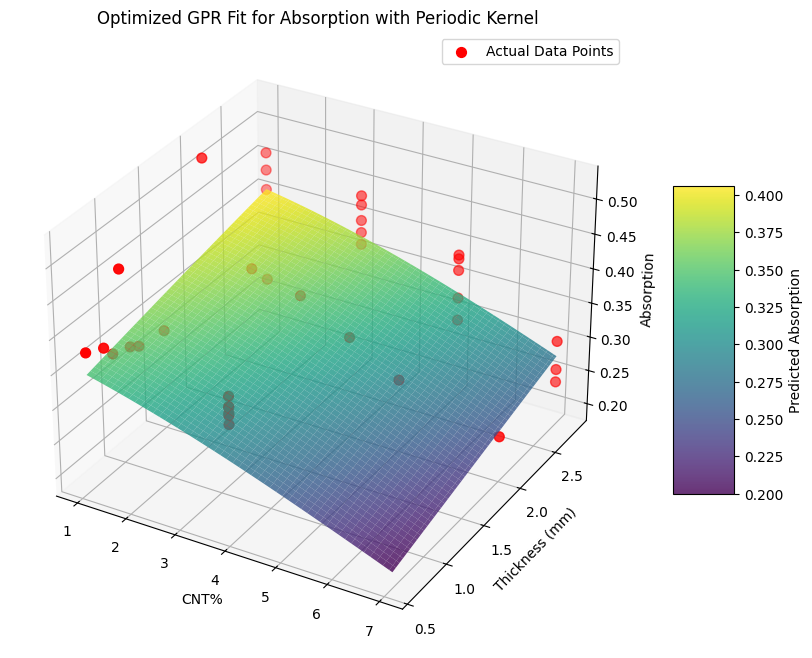

Best Absorption Model Parameters (Periodic Kernel): {'periodic_length_scale': 0.1, 'periodicity': 1.0, 'periodicity_bounds': (1.0, 1000.0), 'alpha': 0.001, 'loss': 0.0007669401090836764}


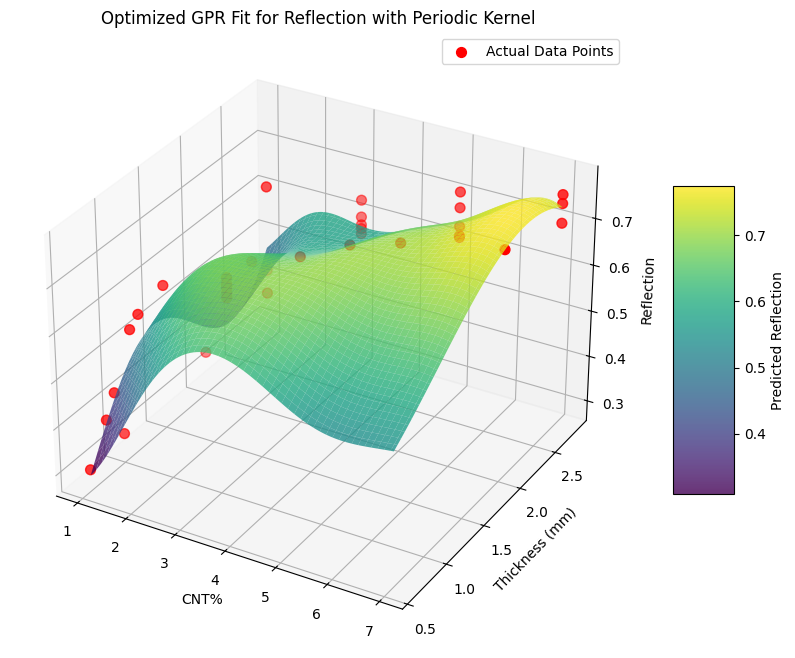

Best Reflection Model Parameters (Periodic Kernel): {'periodic_length_scale': 2.0, 'periodicity': 0.5, 'periodicity_bounds': (1.0, 10.0), 'alpha': 0.001, 'loss': 0.003167601777730428}


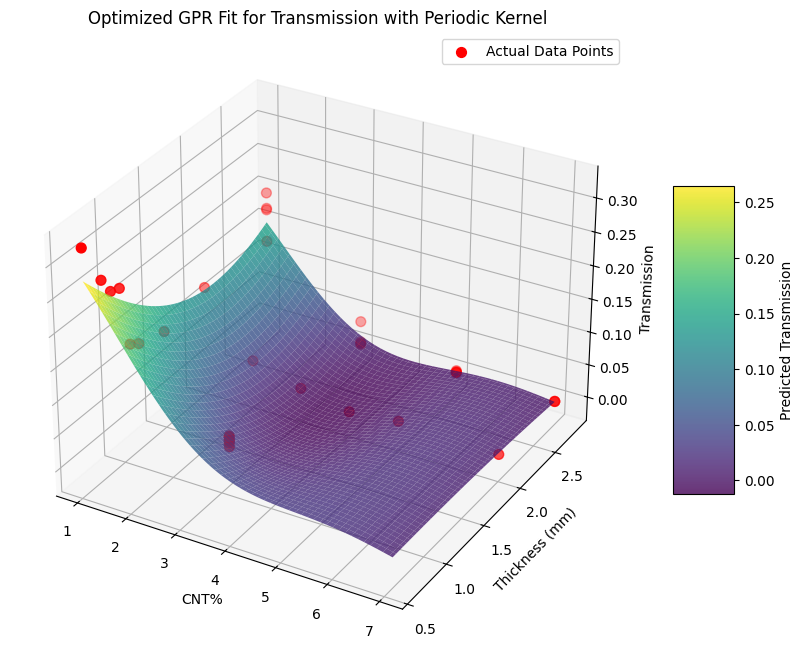

Best Transmission Model Parameters (Periodic Kernel): {'periodic_length_scale': 0.1, 'periodicity': 5.0, 'periodicity_bounds': (1.0, 1000.0), 'alpha': 0.001, 'loss': 0.000923614905671021}


In [ ]:
def custom_loss_periodic(y_true, y_pred, kernel):
    """
    Custom loss function for GPR with a periodic kernel.

    Parameters:
    - y_true: True target values.
    - y_pred: Predicted target values.
    - kernel: The GPR kernel used for predictions.

    Returns:
    - Loss: Weighted sum of MSE and periodicity penalty.
    """
    # Accuracy: Mean Squared Error
    mse_loss = np.mean((y_true - y_pred) ** 2)

    # Smoothness penalty based on kernel periodicity
    periodicity_penalty = 1 / kernel.k2.periodicity  # Penalize shorter periodicity

    # Total loss
    return mse_loss + 0.01 * periodicity_penalty  # Adjust weight as needed

def grid_search_periodic_kernel(thesis_df, target, grid_resolution=100):
    """
    Perform grid search to optimize hyperparameters of the periodic kernel.

    Parameters:
    - thesis_df (pd.DataFrame): The dataset containing input features and targets.
    - target (str): The target variable to predict ('absorption', 'reflection', or 'transmission').
    - grid_resolution (int): Resolution for the prediction grid.

    Returns:
    - best_model (GaussianProcessRegressor): Trained GPR model with the best periodic kernel.
    - best_params (dict): Optimal hyperparameters of the periodic kernel.
    """
    # Extract features and target
    X = thesis_df[['cnt_pct', 'thickness']].values
    y = thesis_df[f'mean_{target[0].lower()}'].values

    # Split into train and validation sets
    X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.1, random_state=42)

    # Hyperparameter grid
    periodic_length_scales = [0.01, 0.05, 0.1, 0.5, 1.0, 2.0]
    periodic_periodicities = [0.5, 1.0, 2.0, 5.0, 10.0]
    periodicity_bounds_options = [(1.0, 10.0), (1.0, 100.0), (1.0, 1000.0)]
    alpha_values = [1e-3]

    best_loss = float('inf')
    best_model = None
    best_params = None

    # Grid search
    for periodic_ls in periodic_length_scales:
        for periodicity in periodic_periodicities:
            for periodicity_bounds in periodicity_bounds_options:
                for alpha in alpha_values:
                    # Define kernel
                    kernel = C(1.0, (1e-1, 1e3)) * ExpSineSquared(
                        length_scale=periodic_ls,
                        periodicity=periodicity,
                        periodicity_bounds=periodicity_bounds,
                    )
                    gpr = GaussianProcessRegressor(kernel=kernel, alpha=alpha, n_restarts_optimizer=10)
                    gpr.fit(X_train, y_train)
                    y_val_pred = gpr.predict(X_val)
                    loss = custom_loss_periodic(y_val, y_val_pred, gpr.kernel_)

                    # Update best model if lower loss is found
                    if loss < best_loss:
                        best_loss = loss
                        best_model = gpr
                        best_params = {
                            "periodic_length_scale": periodic_ls,
                            "periodicity": periodicity,
                            "periodicity_bounds": periodicity_bounds,
                            "alpha": alpha,
                            "loss": loss,
                        }

    # Generate grid for predictions
    CNT_grid = np.linspace(thesis_df['CNT%'].min(), thesis_df['CNT%'].max(), grid_resolution)
    Thickness_grid = np.linspace(thesis_df['Thickness'].min(), thesis_df['Thickness'].max(), grid_resolution)
    CNT_grid, Thickness_grid = np.meshgrid(CNT_grid, Thickness_grid)
    X_pred = np.c_[CNT_grid.ravel(), Thickness_grid.ravel()]

    # Make predictions
    y_pred, y_std = best_model.predict(X_pred, return_std=True)
    y_pred = y_pred.reshape(CNT_grid.shape)

    # Plot the results
    fig = plt.figure(figsize=(12, 8))
    ax = fig.add_subplot(111, projection='3d')
    surf = ax.plot_surface(CNT_grid, Thickness_grid, y_pred, cmap='viridis', alpha=0.8)
    fig.colorbar(surf, shrink=0.5, aspect=5, label=f'Predicted {target.capitalize()}')

    # Overlay the actual data points
    ax.scatter(
        thesis_df['CNT%'], thesis_df['Thickness'], thesis_df[f'mean_{target[0].lower()}'],
        c='red', label='Actual Data Points', s=50
    )

    # Labels and title
    ax.set_xlabel('CNT%')
    ax.set_ylabel('Thickness (mm)')
    ax.set_zlabel(f'{target.capitalize()}')
    ax.set_title(f'Optimized GPR Fit for {target.capitalize()} with Periodic Kernel')
    ax.legend()
    plt.show()

    return best_model, best_params

# Example usage for each target:
gpr_model_absorption_periodic, best_params_absorption_periodic = grid_search_periodic_kernel(thesis_df, target="absorption")
print("Best Absorption Model Parameters (Periodic Kernel):", best_params_absorption_periodic)

gpr_model_reflection_periodic, best_params_reflection_periodic = grid_search_periodic_kernel(thesis_df, target="reflection")
print("Best Reflection Model Parameters (Periodic Kernel):", best_params_reflection_periodic)

gpr_model_transmission_periodic, best_params_transmission_periodic = grid_search_periodic_kernel(thesis_df, target="transmission")
print("Best Transmission Model Parameters (Periodic Kernel):", best_params_transmission_periodic)


Rational Quadratic

Training and saving Rational Quadratic model for: Absorption
Model saved to: /content/drive/MyDrive/Thesis_Updated/Models/absorption_gpr_model_rq.pkl


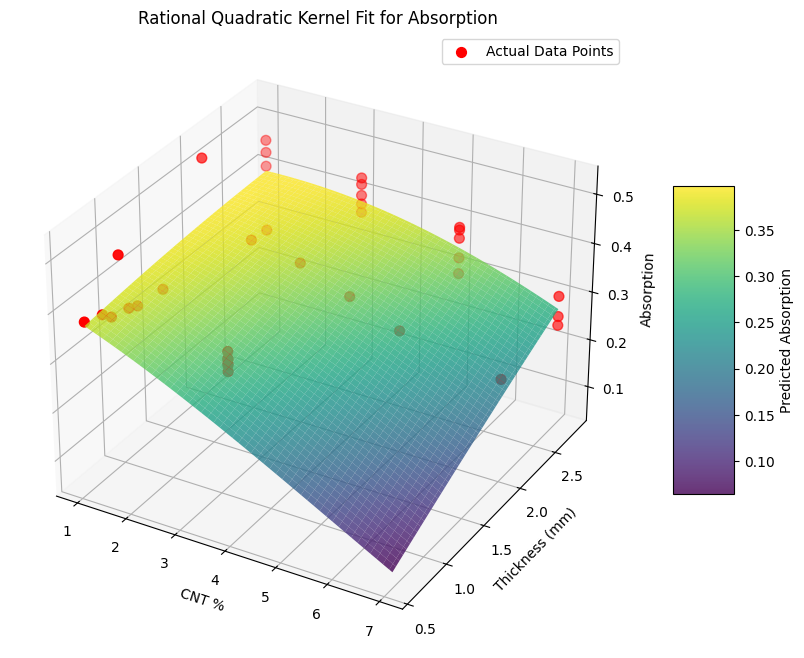

Training and saving Rational Quadratic model for: Reflection
Model saved to: /content/drive/MyDrive/Thesis_Updated/Models/reflection_gpr_model_rq.pkl


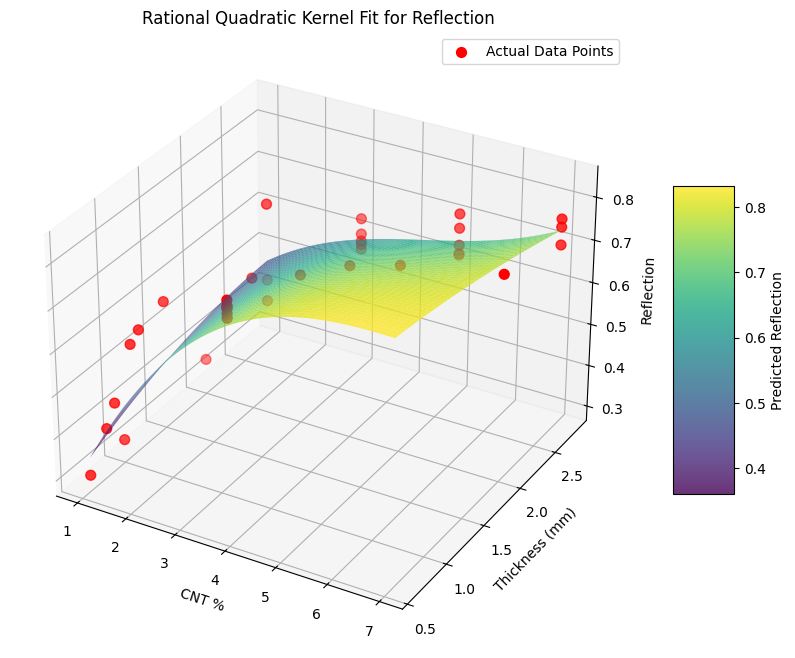

Training and saving Rational Quadratic model for: Transmission
Model saved to: /content/drive/MyDrive/Thesis_Updated/Models/transmission_gpr_model_rq.pkl


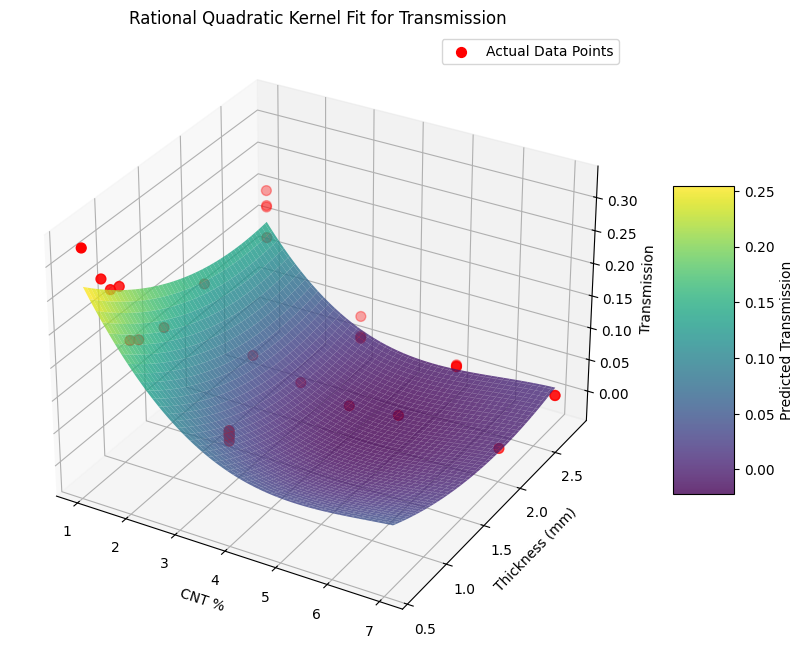

Absorption Model Uncertainty: {'mean_uncertainty_physical_region': np.float64(0.01534366468459857), 'mean_uncertainty_extended_region': np.float64(0.42856725631466136)}
Reflection Model Uncertainty: {'mean_uncertainty_physical_region': np.float64(0.02200796784613183), 'mean_uncertainty_extended_region': np.float64(1.8407094692617352)}
Transmission Model Uncertainty: {'mean_uncertainty_physical_region': np.float64(0.01944293718817298), 'mean_uncertainty_extended_region': np.float64(1.1058589018629683)}


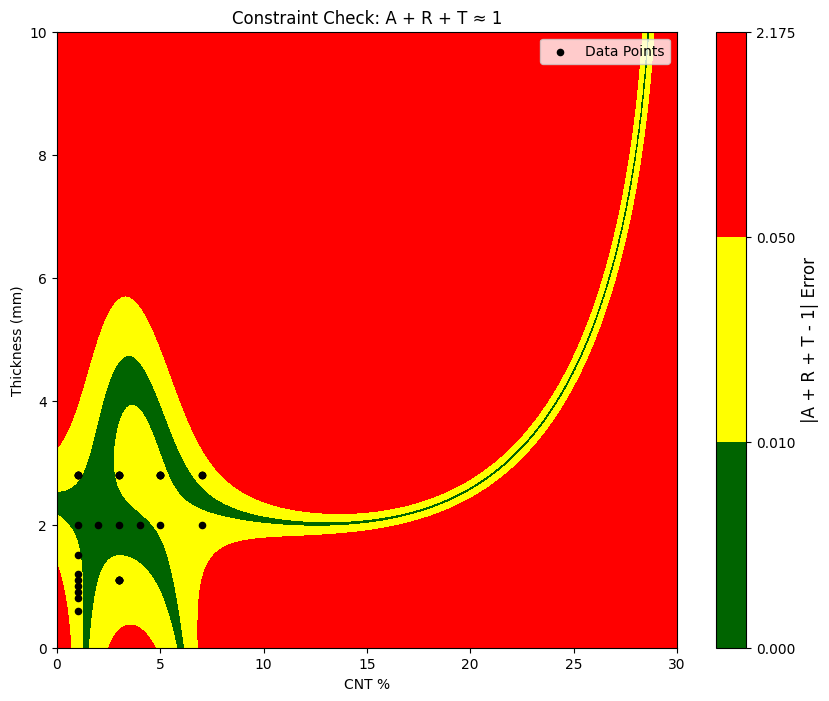

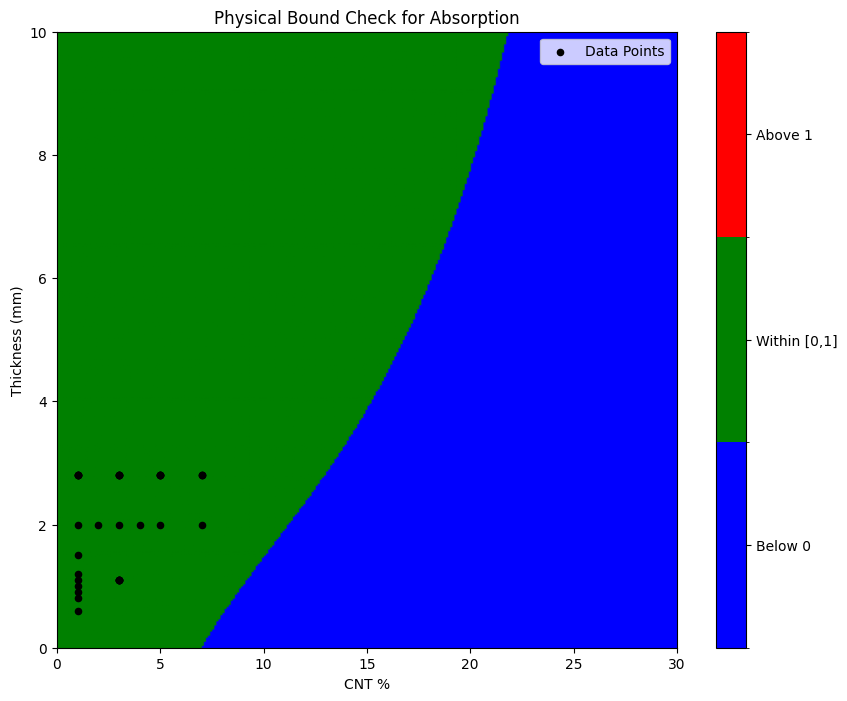

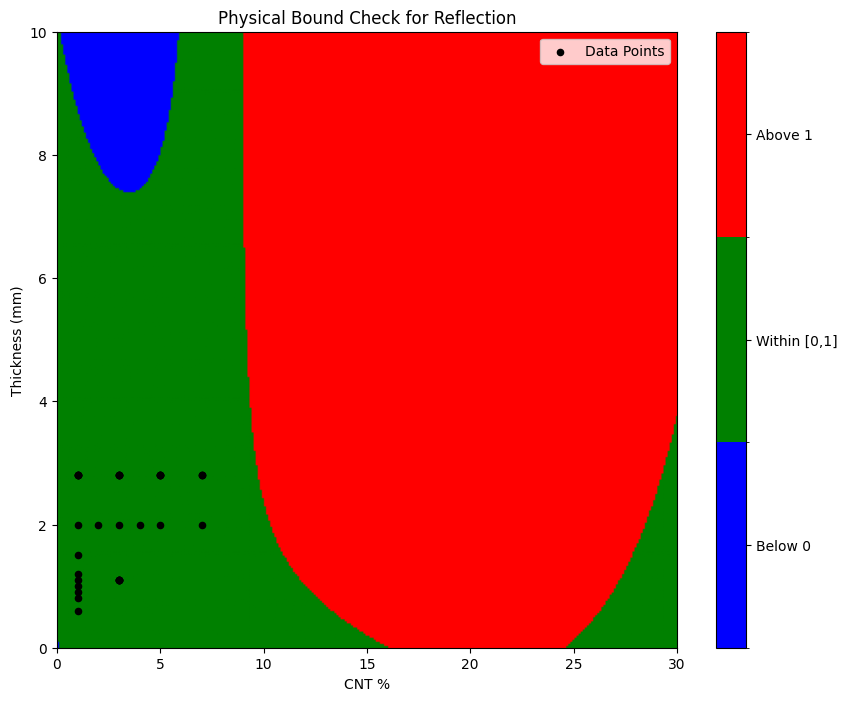

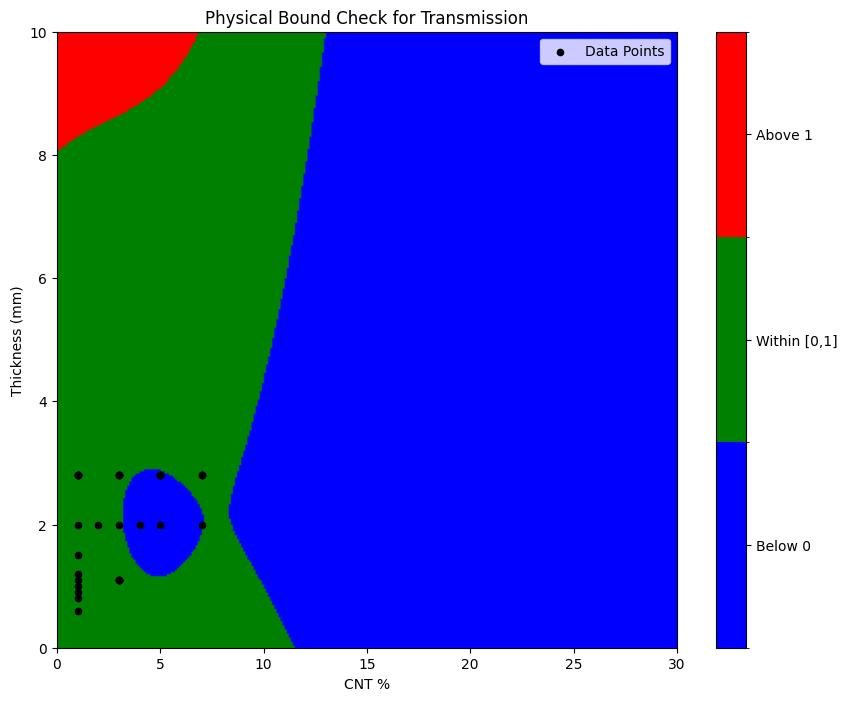

In [39]:
def train_and_save_rational_quadratic_models(thesis_df, target_params_dict, base_path):
    """
    Train and save GPR models with Rational Quadratic kernel for each target.

    Parameters:
    - thesis_df (pd.DataFrame): Dataset with features and targets.
    - target_params_dict (dict): Optimal hyperparameters for each target.
    - base_path (str): Path to save the trained models.

    Returns:
    - models_dict (dict): Trained GPR models.
    """
    import numpy as np
    import joblib
    from sklearn.gaussian_process import GaussianProcessRegressor
    from sklearn.gaussian_process.kernels import RationalQuadratic, ConstantKernel as C
    from sklearn.model_selection import train_test_split

    models_dict = {}

    for target, params in target_params_dict.items():
        print(f"Training and saving Rational Quadratic model for: {target.capitalize()}")

        X = thesis_df[['cnt_pct', 'thickness']].values
        y = thesis_df[f'mean_{target[0].lower()}'].values

        X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=42)

        kernel = C(1.0, (1e-1, 1e3)) * RationalQuadratic(
            length_scale=params['length_scale'],
            alpha=params['alpha'],
            length_scale_bounds=params['length_scale_bounds'],
            alpha_bounds=params['alpha_bounds']
        )

        gpr = GaussianProcessRegressor(kernel=kernel, alpha=params['noise_alpha'], n_restarts_optimizer=10)
        gpr.fit(X_train, y_train)

        model_path = f"{base_path}/{target}_gpr_model_rq.pkl"
        joblib.dump(gpr, model_path)
        print(f"Model saved to: {model_path}")

        models_dict[target] = gpr

        # Plot the Model Prediction Surface
        CNT_grid = np.linspace(thesis_df['cnt_pct'].min(), thesis_df['cnt_pct'].max(), 100)
        Thickness_grid = np.linspace(thesis_df['thickness'].min(), thesis_df['thickness'].max(), 100)
        CNT_grid, Thickness_grid = np.meshgrid(CNT_grid, Thickness_grid)
        X_pred = np.c_[CNT_grid.ravel(), Thickness_grid.ravel()]
        y_pred = gpr.predict(X_pred)
        y_pred = y_pred.reshape(CNT_grid.shape)

        fig = plt.figure(figsize=(12, 8))
        ax = fig.add_subplot(111, projection='3d')
        surf = ax.plot_surface(CNT_grid, Thickness_grid, y_pred, cmap='viridis', alpha=0.8)
        fig.colorbar(surf, shrink=0.5, aspect=5, label=f'Predicted {target.capitalize()}')

        ax.scatter(thesis_df['cnt_pct'], thesis_df['thickness'], y, c='red', label='Actual Data Points', s=50)
        ax.set_xlabel('CNT %')
        ax.set_ylabel('Thickness (mm)')
        ax.set_zlabel(target.capitalize())
        ax.set_title(f'Rational Quadratic Kernel Fit for {target.capitalize()}')
        ax.legend()
        plt.show()


    return models_dict

rational_quadratic_target_params_dict = {
    "absorption": {
        "length_scale": 1.0,
        "alpha": 1.0,
        "length_scale_bounds": (10, 1000),
        "alpha_bounds": (10, 1000),
        "noise_alpha": 1e-3,
        "loss": 0.0028434461947780126
    },
    "reflection": {
        "length_scale": 5.0,
        "alpha": 0.5,
        "length_scale_bounds": (10, 1e3),
        "alpha_bounds": (10, 1e3),
        "noise_alpha": 1e-3,
        "loss": 0.006579988214921874
    },
    "transmission": {
        "length_scale": 0.5,
        "alpha": 1.0,
        "length_scale_bounds": (1e1, 1e3),
        "alpha_bounds": (1e1, 1e3),
        "noise_alpha": 1e-3,
        "loss": 0.0031250557671261203
    }
}
base_path = '/content/drive/MyDrive/Thesis_Updated/Models'

# Train and save models
models_dict_rq = train_and_save_rational_quadratic_models(thesis_df, rational_quadratic_target_params_dict, base_path)

# Define Bounds
physical_bounds = ((1.0, 7.0), (0.6, 2.8))
extended_bounds = ((0.0, 30.0), (0.0, 10.0))

# Calculate Uncertainties
uncertainty_absorption_rq = compute_average_uncertainty(models_dict_rq['absorption'], thesis_df, physical_bounds, extended_bounds)
uncertainty_reflection_rq = compute_average_uncertainty(models_dict_rq['reflection'], thesis_df, physical_bounds, extended_bounds)
uncertainty_transmission_rq = compute_average_uncertainty(models_dict_rq['transmission'], thesis_df, physical_bounds, extended_bounds)

print("Absorption Model Uncertainty:", uncertainty_absorption_rq)
print("Reflection Model Uncertainty:", uncertainty_reflection_rq)
print("Transmission Model Uncertainty:", uncertainty_transmission_rq)

# Plot Sum Constraint
plot_sum_constraint(models_dict_rq, thesis_df, extended_bounds)

# Plot Bound Constraint
plot_physical_bounds(models_dict_rq, thesis_df, extended_bounds)


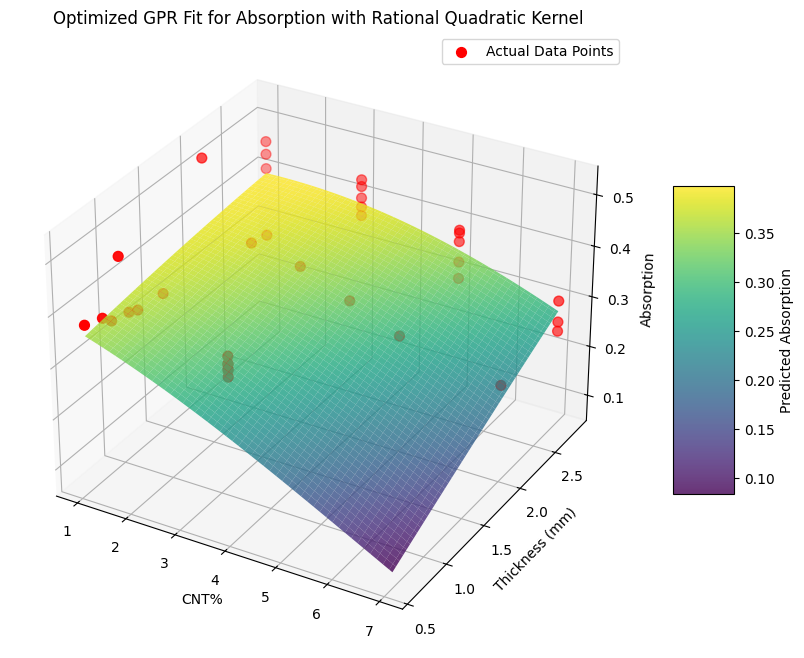

Best Absorption Model Parameters (Rational Quadratic): {'length_scale': 1.0, 'alpha': 1.0, 'length_scale_bounds': (10.0, 1000.0), 'alpha_bounds': (10.0, 1000.0), 'noise_alpha': 0.001, 'loss': 0.0028434461947780126}


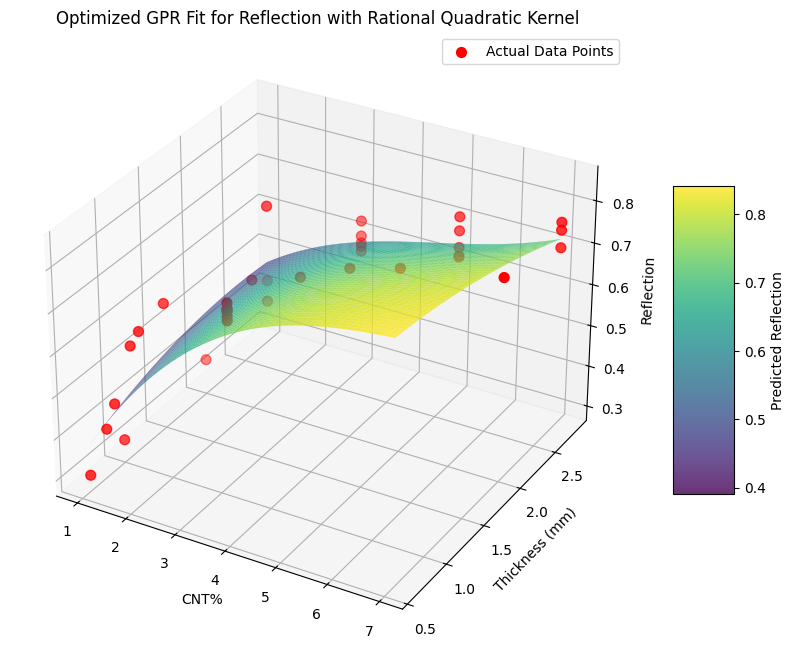

Best Reflection Model Parameters (Rational Quadratic): {'length_scale': 5.0, 'alpha': 0.5, 'length_scale_bounds': (10.0, 1000.0), 'alpha_bounds': (10.0, 1000.0), 'noise_alpha': 0.001, 'loss': 0.006579988214921874}


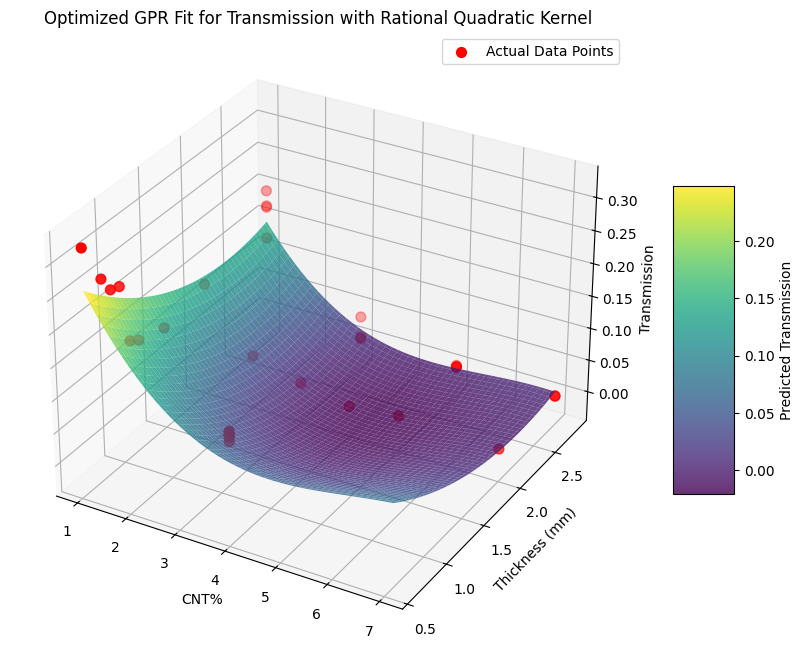

Best Transmission Model Parameters (Rational Quadratic): {'length_scale': 0.5, 'alpha': 1.0, 'length_scale_bounds': (10.0, 1000.0), 'alpha_bounds': (10.0, 1000.0), 'noise_alpha': 0.001, 'loss': 0.0031250557671261203}


In [ ]:
def custom_loss_rational_quadratic(y_true, y_pred, kernel):
    """
    Custom loss function for GPR with Rational Quadratic kernel.

    Parameters:
    - y_true: True target values.
    - y_pred: Predicted target values.
    - kernel: The GPR kernel used for predictions.

    Returns:
    - Loss: Weighted sum of MSE and kernel-based penalties.
    """
    # Mean Squared Error
    mse_loss = np.mean((y_true - y_pred) ** 2)

    # Regularization: Penalize small length_scale and alpha
    length_scale = kernel.k2.length_scale
    alpha = kernel.k2.alpha
    smoothness_penalty = 1 / length_scale + 1 / alpha  # Penalize small values

    # Total loss
    return mse_loss + 0.01 * smoothness_penalty  # Adjust regularization weight as needed


def grid_search_rational_quadratic(thesis_df, target, grid_resolution=100):
    """
    Perform grid search to optimize hyperparameters of the Rational Quadratic kernel.

    Parameters:
    - thesis_df (pd.DataFrame): The dataset containing input features and targets.
    - target (str): The target variable to predict ('absorption', 'reflection', or 'transmission').
    - grid_resolution (int): Resolution for the prediction grid.

    Returns:
    - best_model (GaussianProcessRegressor): Trained GPR model with the best Rational Quadratic kernel.
    - best_params (dict): Optimal hyperparameters of the Rational Quadratic kernel.
    """
    # Extract features and target
    X = thesis_df[['cnt_pct', 'thickness']].values
    y = thesis_df[f'mean_{target[0].lower()}'].values

    # Split into train and validation sets
    X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.1, random_state=42)

    # Hyperparameter grid
    length_scales = [0.1, 0.5, 1.0, 2.0, 5.0]
    alphas = [0.1, 0.5, 1.0, 2.0, 5.0]
    length_scale_bounds_options = [(1e-2, 1e2), (1e-1, 1e3), (10.0, 1000.0)]
    alpha_bounds_options = [(1e-2, 1e2), (1e-1, 1e3), (10.0, 1000.0)]
    alpha_values = [1e-3]

    best_loss = float('inf')
    best_model = None
    best_params = None

    # Grid search
    for length_scale in length_scales:
        for alpha in alphas:
            for length_scale_bounds in length_scale_bounds_options:
                for alpha_bounds in alpha_bounds_options:
                    for noise_alpha in alpha_values:
                        # Define kernel
                        kernel = C(1.0, (1e-1, 1e3)) * RationalQuadratic(
                            length_scale=length_scale,
                            alpha=alpha,
                            length_scale_bounds=length_scale_bounds,
                            alpha_bounds=alpha_bounds
                        )
                        gpr = GaussianProcessRegressor(kernel=kernel, alpha=noise_alpha, n_restarts_optimizer=10)
                        gpr.fit(X_train, y_train)
                        y_val_pred = gpr.predict(X_val)
                        loss = custom_loss_rational_quadratic(y_val, y_val_pred, gpr.kernel_)

                        # Update best model if lower loss is found
                        if loss < best_loss:
                            best_loss = loss
                            best_model = gpr
                            best_params = {
                                "length_scale": length_scale,
                                "alpha": alpha,
                                "length_scale_bounds": length_scale_bounds,
                                "alpha_bounds": alpha_bounds,
                                "noise_alpha": noise_alpha,
                                "loss": loss,
                            }

    # Generate grid for predictions
    CNT_grid = np.linspace(thesis_df['CNT%'].min(), thesis_df['CNT%'].max(), grid_resolution)
    Thickness_grid = np.linspace(thesis_df['Thickness'].min(), thesis_df['Thickness'].max(), grid_resolution)
    CNT_grid, Thickness_grid = np.meshgrid(CNT_grid, Thickness_grid)
    X_pred = np.c_[CNT_grid.ravel(), Thickness_grid.ravel()]

    # Make predictions
    y_pred, y_std = best_model.predict(X_pred, return_std=True)
    y_pred = y_pred.reshape(CNT_grid.shape)

    # Plot the results
    fig = plt.figure(figsize=(12, 8))
    ax = fig.add_subplot(111, projection='3d')
    surf = ax.plot_surface(CNT_grid, Thickness_grid, y_pred, cmap='viridis', alpha=0.8)
    fig.colorbar(surf, shrink=0.5, aspect=5, label=f'Predicted {target.capitalize()}')

    # Overlay the actual data points
    ax.scatter(
        thesis_df['CNT%'], thesis_df['Thickness'], thesis_df[f'mean_{target[0].lower()}'],
        c='red', label='Actual Data Points', s=50
    )

    # Labels and title
    ax.set_xlabel('CNT%')
    ax.set_ylabel('Thickness (mm)')
    ax.set_zlabel(f'{target.capitalize()}')
    ax.set_title(f'Optimized GPR Fit for {target.capitalize()} with Rational Quadratic Kernel')
    ax.legend()
    plt.show()

    return best_model, best_params


# Example usage for each target:
gpr_model_absorption_rq, best_params_absorption_rq = grid_search_rational_quadratic(thesis_df, target="absorption")
print("Best Absorption Model Parameters (Rational Quadratic):", best_params_absorption_rq)

gpr_model_reflection_rq, best_params_reflection_rq = grid_search_rational_quadratic(thesis_df, target="reflection")
print("Best Reflection Model Parameters (Rational Quadratic):", best_params_reflection_rq)

gpr_model_transmission_rq, best_params_transmission_rq = grid_search_rational_quadratic(thesis_df, target="transmission")
print("Best Transmission Model Parameters (Rational Quadratic):", best_params_transmission_rq)


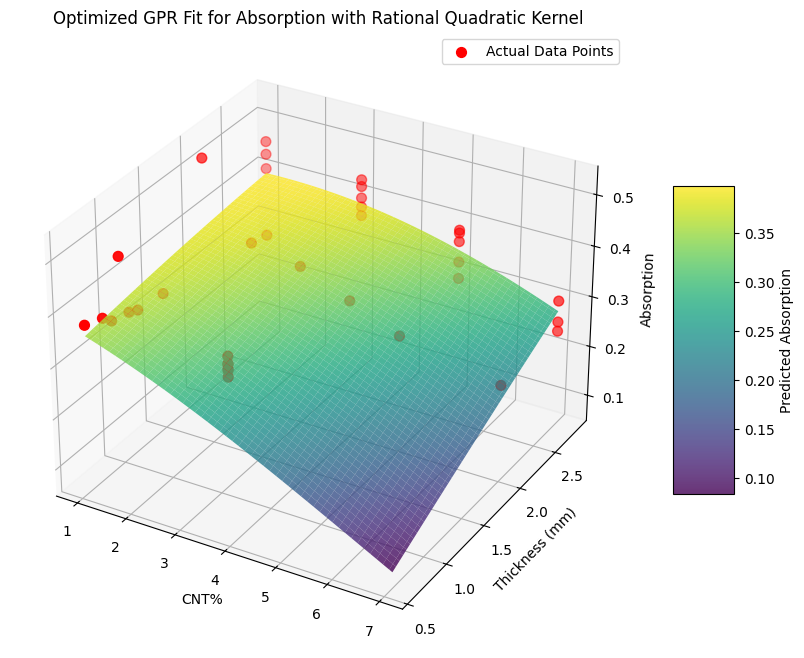

Best Absorption Model Parameters (Rational Quadratic): {'length_scale': 0.1, 'alpha': 5.0, 'length_scale_bounds': (10.0, 1000.0), 'alpha_bounds': (10.0, 1000.0), 'noise_alpha': 0.001, 'loss': 0.0008434463041719607}


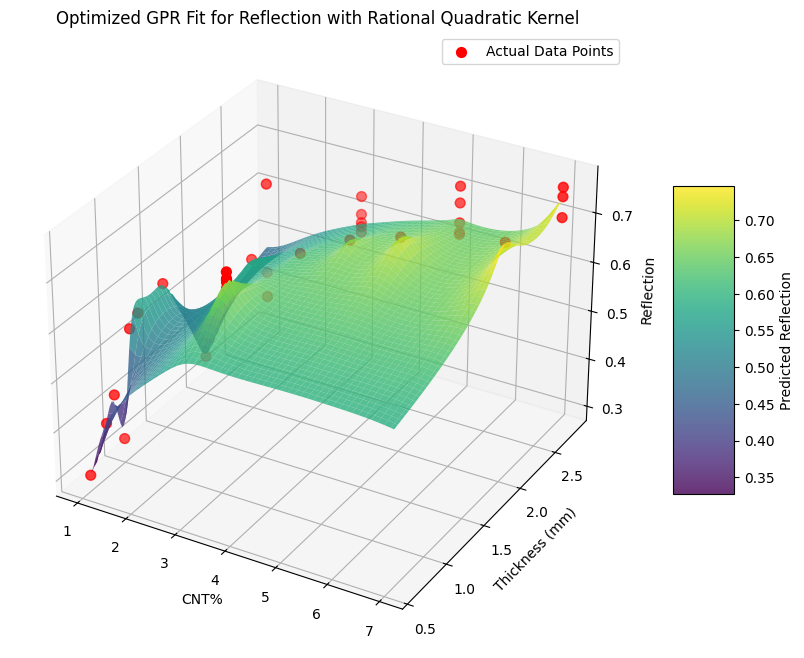

Best Reflection Model Parameters (Rational Quadratic): {'length_scale': 0.5, 'alpha': 0.1, 'length_scale_bounds': (0.01, 100.0), 'alpha_bounds': (0.1, 1000.0), 'noise_alpha': 0.001, 'loss': 0.0013010124603287342}


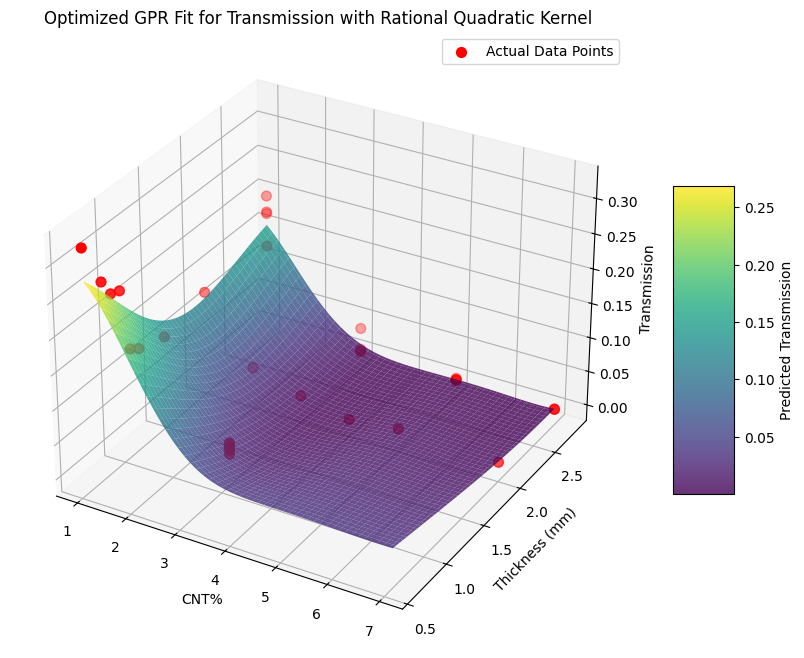

Best Transmission Model Parameters (Rational Quadratic): {'length_scale': 0.1, 'alpha': 0.1, 'length_scale_bounds': (0.1, 1000.0), 'alpha_bounds': (0.01, 100.0), 'noise_alpha': 0.001, 'loss': 0.0006556355968392318}


In [ ]:
def custom_loss_rational_quadratic(y_true, y_pred, kernel):
    """
    Custom loss function for GPR with Rational Quadratic kernel.

    Parameters:
    - y_true: True target values.
    - y_pred: Predicted target values.
    - kernel: The GPR kernel used for predictions.

    Returns:
    - Loss: Weighted sum of MSE and kernel-based penalties.
    """
    # Mean Squared Error
    mse_loss = np.mean((y_true - y_pred) ** 2)

    # Regularization: Penalize small length_scale and alpha
    length_scale = kernel.k2.length_scale
    alpha = kernel.k2.alpha
    smoothness_penalty = 1 / length_scale + 1 / alpha  # Penalize small values

    # Total loss
    return mse_loss + 0.0 * smoothness_penalty  # Adjust regularization weight as needed


def grid_search_rational_quadratic(thesis_df, target, grid_resolution=100):
    """
    Perform grid search to optimize hyperparameters of the Rational Quadratic kernel.

    Parameters:
    - thesis_df (pd.DataFrame): The dataset containing input features and targets.
    - target (str): The target variable to predict ('absorption', 'reflection', or 'transmission').
    - grid_resolution (int): Resolution for the prediction grid.

    Returns:
    - best_model (GaussianProcessRegressor): Trained GPR model with the best Rational Quadratic kernel.
    - best_params (dict): Optimal hyperparameters of the Rational Quadratic kernel.
    """
    # Extract features and target
    X = thesis_df[['cnt_pct', 'thickness']].values
    y = thesis_df[f'mean_{target[0].lower()}'].values

    # Split into train and validation sets
    X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.1, random_state=42)

    # Hyperparameter grid
    length_scales = [0.1, 0.5, 1.0, 2.0, 5.0]
    alphas = [0.1, 0.5, 1.0, 2.0, 5.0]
    length_scale_bounds_options = [(1e-2, 1e2), (1e-1, 1e3), (10.0, 1000.0)]
    alpha_bounds_options = [(1e-2, 1e2), (1e-1, 1e3), (10.0, 1000.0)]
    alpha_values = [1e-3]

    best_loss = float('inf')
    best_model = None
    best_params = None

    # Grid search
    for length_scale in length_scales:
        for alpha in alphas:
            for length_scale_bounds in length_scale_bounds_options:
                for alpha_bounds in alpha_bounds_options:
                    for noise_alpha in alpha_values:
                        # Define kernel
                        kernel = C(1.0, (1e-1, 1e3)) * RationalQuadratic(
                            length_scale=length_scale,
                            alpha=alpha,
                            length_scale_bounds=length_scale_bounds,
                            alpha_bounds=alpha_bounds
                        )
                        gpr = GaussianProcessRegressor(kernel=kernel, alpha=noise_alpha, n_restarts_optimizer=10)
                        gpr.fit(X_train, y_train)
                        y_val_pred = gpr.predict(X_val)
                        loss = custom_loss_rational_quadratic(y_val, y_val_pred, gpr.kernel_)

                        # Update best model if lower loss is found
                        if loss < best_loss:
                            best_loss = loss
                            best_model = gpr
                            best_params = {
                                "length_scale": length_scale,
                                "alpha": alpha,
                                "length_scale_bounds": length_scale_bounds,
                                "alpha_bounds": alpha_bounds,
                                "noise_alpha": noise_alpha,
                                "loss": loss,
                            }

    # Generate grid for predictions
    CNT_grid = np.linspace(thesis_df['CNT%'].min(), thesis_df['CNT%'].max(), grid_resolution)
    Thickness_grid = np.linspace(thesis_df['Thickness'].min(), thesis_df['Thickness'].max(), grid_resolution)
    CNT_grid, Thickness_grid = np.meshgrid(CNT_grid, Thickness_grid)
    X_pred = np.c_[CNT_grid.ravel(), Thickness_grid.ravel()]

    # Make predictions
    y_pred, y_std = best_model.predict(X_pred, return_std=True)
    y_pred = y_pred.reshape(CNT_grid.shape)

    # Plot the results
    fig = plt.figure(figsize=(12, 8))
    ax = fig.add_subplot(111, projection='3d')
    surf = ax.plot_surface(CNT_grid, Thickness_grid, y_pred, cmap='viridis', alpha=0.8)
    fig.colorbar(surf, shrink=0.5, aspect=5, label=f'Predicted {target.capitalize()}')

    # Overlay the actual data points
    ax.scatter(
        thesis_df['CNT%'], thesis_df['Thickness'], thesis_df[f'mean_{target[0].lower()}'],
        c='red', label='Actual Data Points', s=50
    )

    # Labels and title
    ax.set_xlabel('CNT%')
    ax.set_ylabel('Thickness (mm)')
    ax.set_zlabel(f'{target.capitalize()}')
    ax.set_title(f'Optimized GPR Fit for {target.capitalize()} with Rational Quadratic Kernel')
    ax.legend()
    plt.show()

    return best_model, best_params


# Example usage for each target:
gpr_model_absorption_rq, best_params_absorption_rq = grid_search_rational_quadratic(thesis_df, target="absorption")
print("Best Absorption Model Parameters (Rational Quadratic):", best_params_absorption_rq)

gpr_model_reflection_rq, best_params_reflection_rq = grid_search_rational_quadratic(thesis_df, target="reflection")
print("Best Reflection Model Parameters (Rational Quadratic):", best_params_reflection_rq)

gpr_model_transmission_rq, best_params_transmission_rq = grid_search_rational_quadratic(thesis_df, target="transmission")
print("Best Transmission Model Parameters (Rational Quadratic):", best_params_transmission_rq)


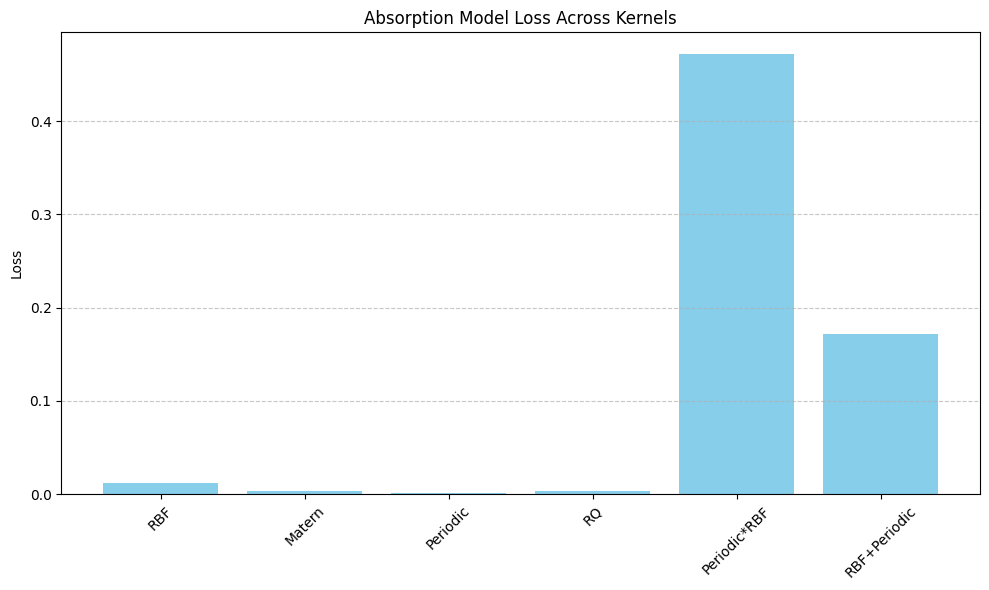

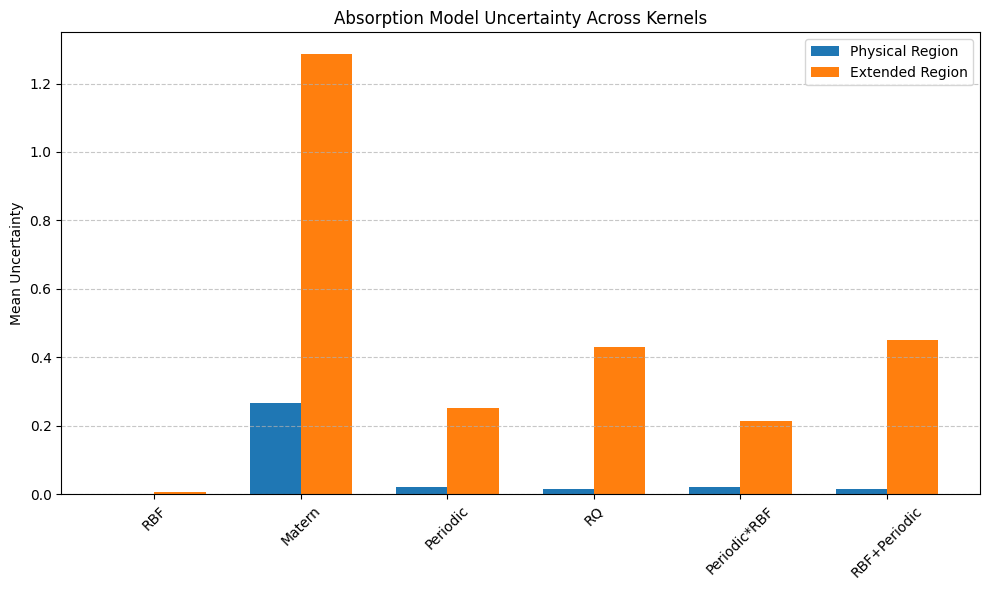

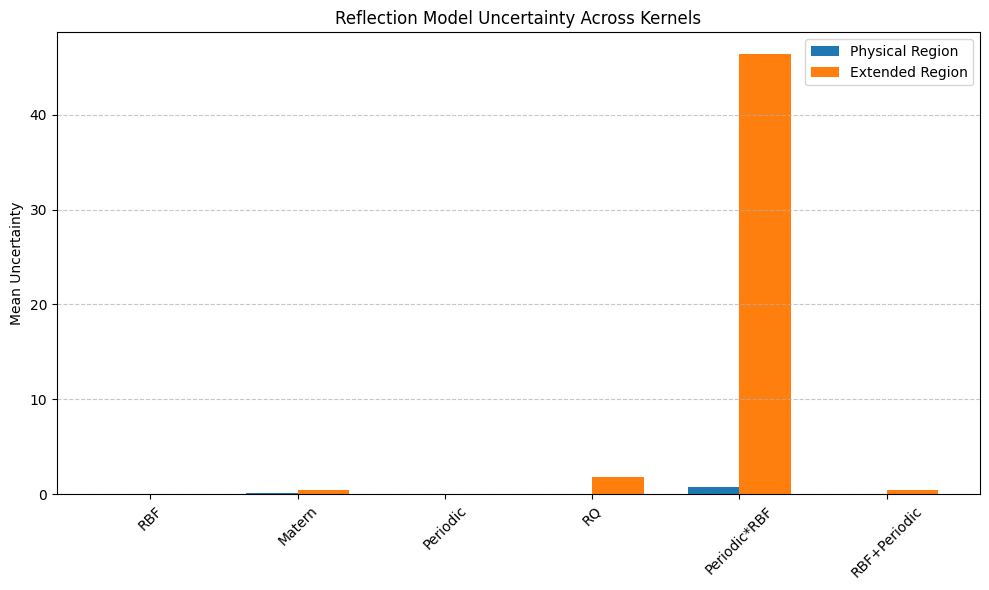

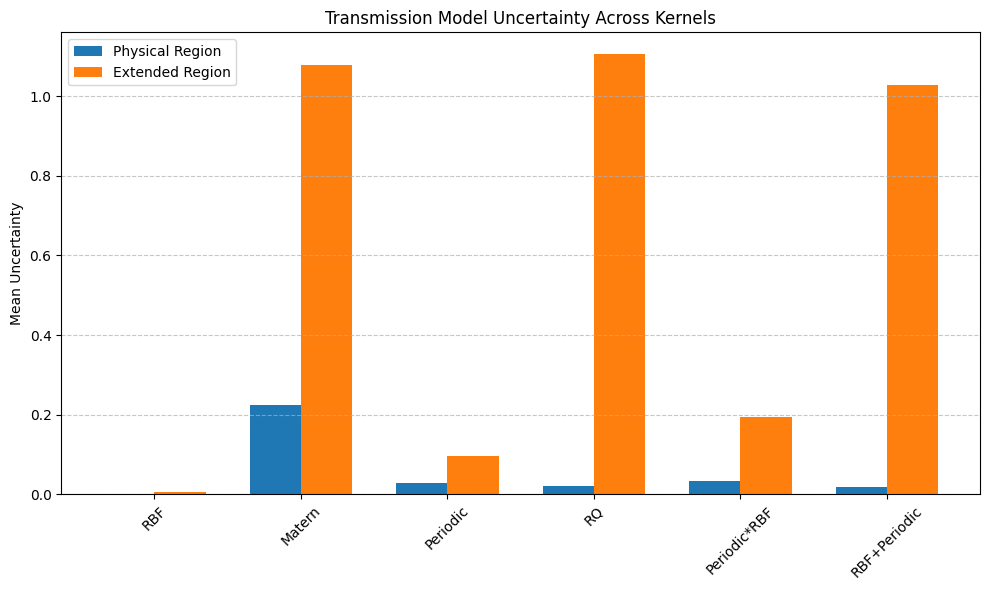

In [48]:
import matplotlib.pyplot as plt
import numpy as np

kernels = ["RBF", "Matern", "Periodic", "RQ", "Periodic*RBF", "RBF+Periodic"]

# -----------------------------
# Loss Bar Plot
# -----------------------------
losses = [
    target_params_dict['absorption']['loss'],
    matern_target_params_dict['absorption']['loss'],
    periodic_target_params_dict['absorption']['loss'],
    rational_quadratic_target_params_dict['absorption']['loss'],
    periodic_rbf_target_params_dict['absorption']['loss'],
    rbf_plus_periodic_target_params_dict['absorption']['loss']
]

plt.figure(figsize=(10, 6))
plt.bar(kernels, losses, color='skyblue')
plt.ylabel('Loss')
plt.title('Absorption Model Loss Across Kernels')
plt.xticks(rotation=45)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()


# -----------------------------
# Uncertainty Bar Plot Function
# -----------------------------
def plot_uncertainty(uncertainty_dict, target_name):
    uncertainty_physical = [
        uncertainty_dict['RBF']['mean_uncertainty_physical_region'],
        uncertainty_dict['Matern']['mean_uncertainty_physical_region'],
        uncertainty_dict['Periodic']['mean_uncertainty_physical_region'],
        uncertainty_dict['RQ']['mean_uncertainty_physical_region'],
        uncertainty_dict['Periodic*RBF']['mean_uncertainty_physical_region'],
        uncertainty_dict['RBF+Periodic']['mean_uncertainty_physical_region'],
    ]

    uncertainty_extended = [
        uncertainty_dict['RBF']['mean_uncertainty_extended_region'],
        uncertainty_dict['Matern']['mean_uncertainty_extended_region'],
        uncertainty_dict['Periodic']['mean_uncertainty_extended_region'],
        uncertainty_dict['RQ']['mean_uncertainty_extended_region'],
        uncertainty_dict['Periodic*RBF']['mean_uncertainty_extended_region'],
        uncertainty_dict['RBF+Periodic']['mean_uncertainty_extended_region'],
    ]

    x = np.arange(len(kernels))
    width = 0.35

    fig, ax = plt.subplots(figsize=(10, 6))
    ax.bar(x - width/2, uncertainty_physical, width, label='Physical Region')
    ax.bar(x + width/2, uncertainty_extended, width, label='Extended Region')

    ax.set_ylabel('Mean Uncertainty')
    ax.set_title(f'{target_name.capitalize()} Model Uncertainty Across Kernels')
    ax.set_xticks(x)
    ax.set_xticklabels(kernels, rotation=45)
    ax.legend()
    ax.grid(axis='y', linestyle='--', alpha=0.7)
    plt.tight_layout()
    plt.show()

uncertainty_absorption = {
    "RBF": uncertainty_absorption_rbf,
    "Matern": uncertainty_absorption_matern,
    "Periodic": uncertainty_absorption_periodic,
    "RQ": uncertainty_absorption_rq,
    "Periodic*RBF": uncertainty_absorption_prbf,
    "RBF+Periodic": uncertainty_absorption_rbf_plus_periodic
}

uncertainty_reflection = {
    "RBF": uncertainty_reflection_rbf,
    "Matern": uncertainty_reflection_matern,
    "Periodic": uncertainty_reflection_periodic,
    "RQ": uncertainty_reflection_rq,
    "Periodic*RBF": uncertainty_reflection_prbf,
    "RBF+Periodic": uncertainty_reflection_rbf_plus_periodic
}

uncertainty_transmission = {
    "RBF": uncertainty_transmission_rbf,
    "Matern": uncertainty_transmission_matern,
    "Periodic": uncertainty_transmission_periodic,
    "RQ": uncertainty_transmission_rq,
    "Periodic*RBF": uncertainty_transmission_prbf,
    "RBF+Periodic": uncertainty_transmission_rbf_plus_periodic
}


# -----------------------------
# Plot Uncertainty for Each Target
# -----------------------------
plot_uncertainty(uncertainty_absorption, 'absorption')
plot_uncertainty(uncertainty_reflection, 'reflection')
plot_uncertainty(uncertainty_transmission, 'transmission')


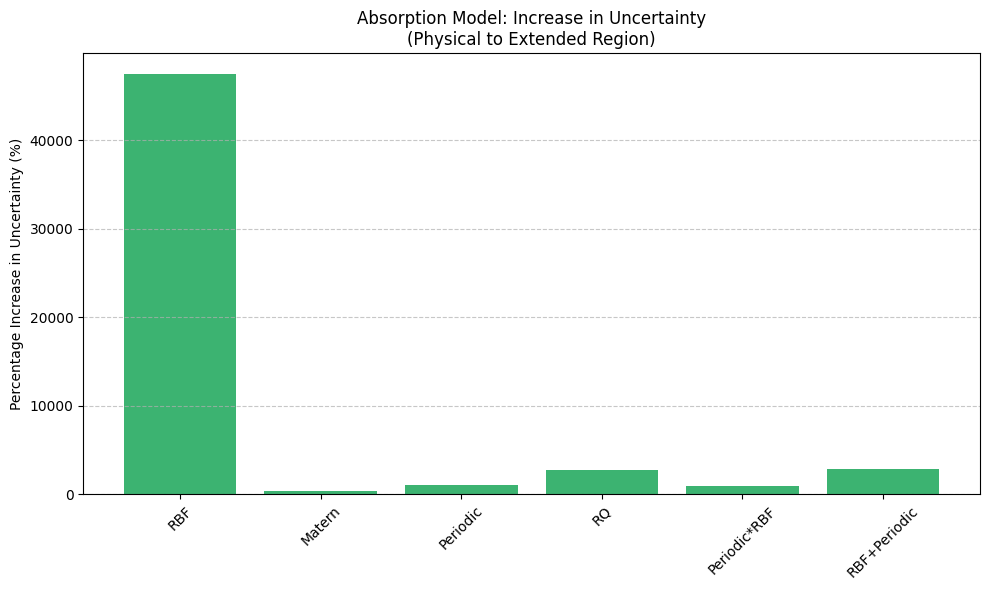

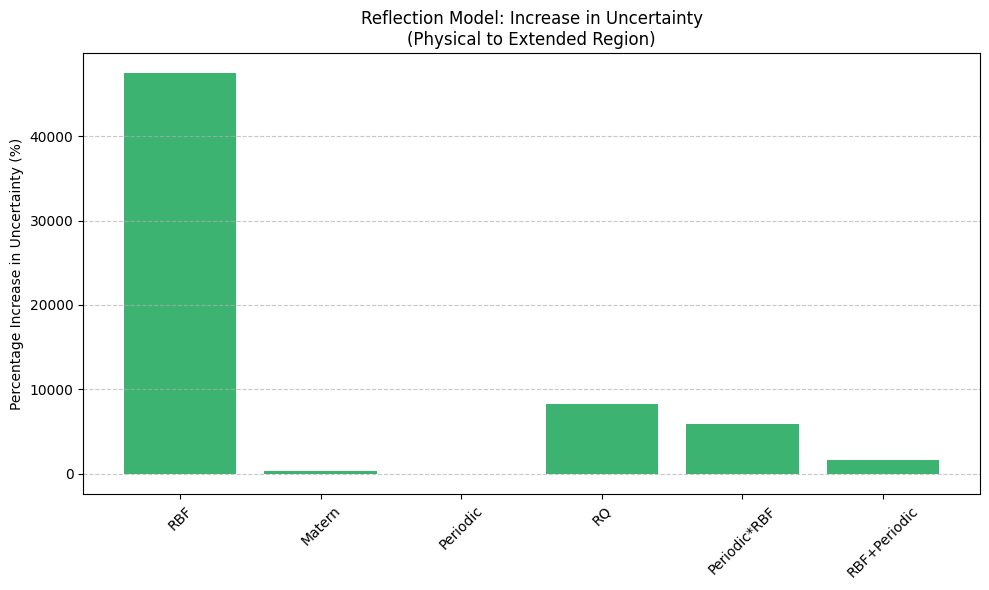

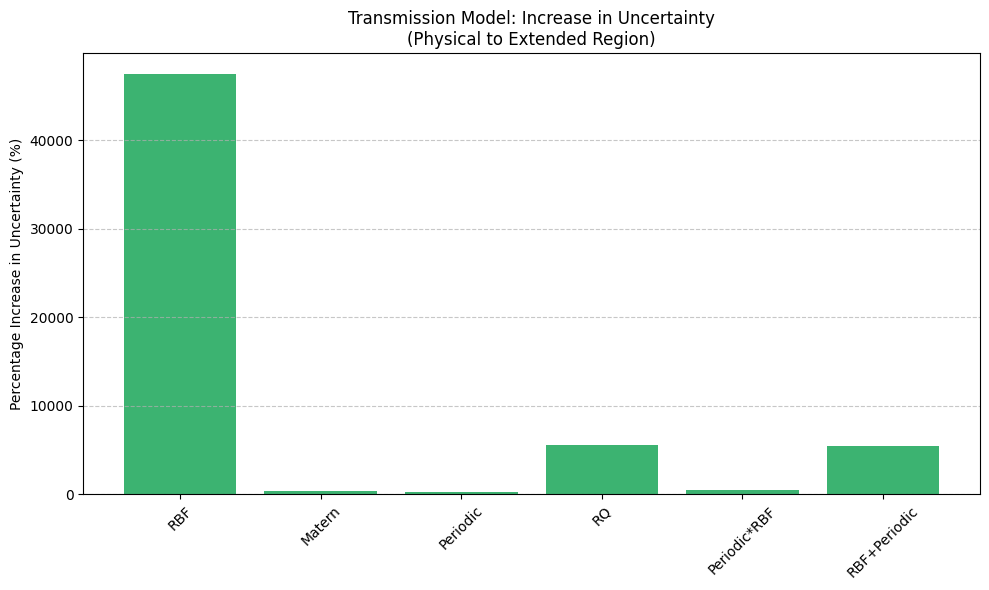

In [49]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming you already defined this earlier
kernels = ["RBF", "Matern", "Periodic", "RQ", "Periodic*RBF", "RBF+Periodic"]

# Compute Percentage Increase in Uncertainty
def compute_percentage_increase(uncertainty_dict):
    return [
        ((uncertainty_dict[kernel]['mean_uncertainty_extended_region'] -
          uncertainty_dict[kernel]['mean_uncertainty_physical_region']) /
         uncertainty_dict[kernel]['mean_uncertainty_physical_region']) * 100
        for kernel in kernels
    ]

# Calculate for Absorption
percentage_increase_absorption = compute_percentage_increase(uncertainty_absorption)

# Calculate for Reflection
percentage_increase_reflection = compute_percentage_increase(uncertainty_reflection)

# Calculate for Transmission
percentage_increase_transmission = compute_percentage_increase(uncertainty_transmission)


# Plotting Function
def plot_percentage_increase(percentage_increase, target_name):
    plt.figure(figsize=(10, 6))
    plt.bar(kernels, percentage_increase, color='mediumseagreen')
    plt.ylabel('Percentage Increase in Uncertainty (%)')
    plt.title(f'{target_name.capitalize()} Model: Increase in Uncertainty\n(Physical to Extended Region)')
    plt.xticks(rotation=45)
    plt.grid(axis='y', linestyle='--', alpha=0.7)
    plt.tight_layout()
    plt.show()


# Plot for Absorption
plot_percentage_increase(percentage_increase_absorption, 'absorption')

# Plot for Reflection
plot_percentage_increase(percentage_increase_reflection, 'reflection')

# Plot for Transmission
plot_percentage_increase(percentage_increase_transmission, 'transmission')


Round Two, extend ranges

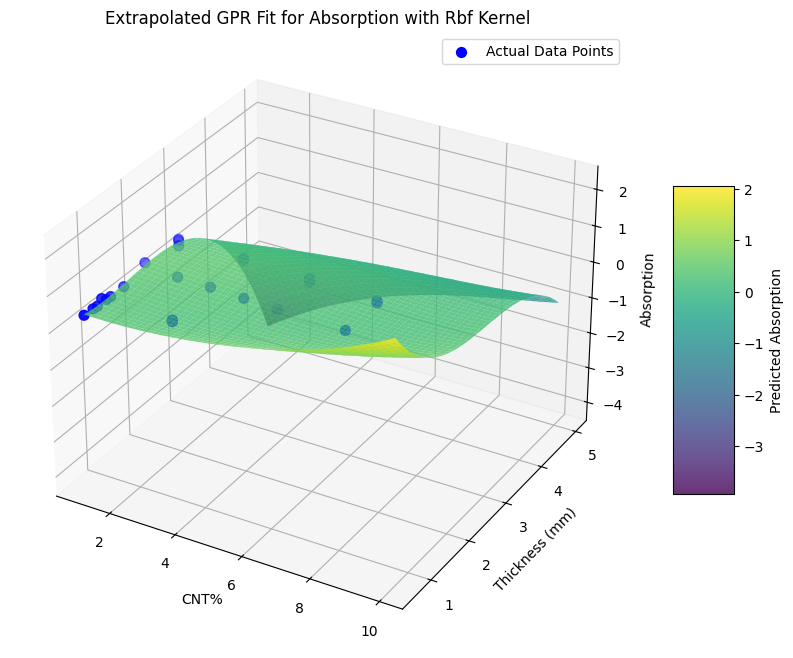

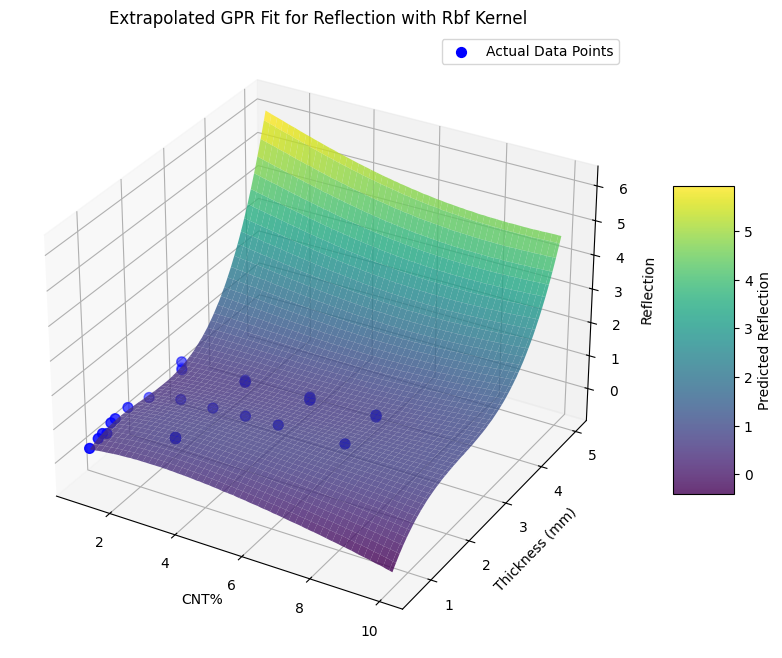

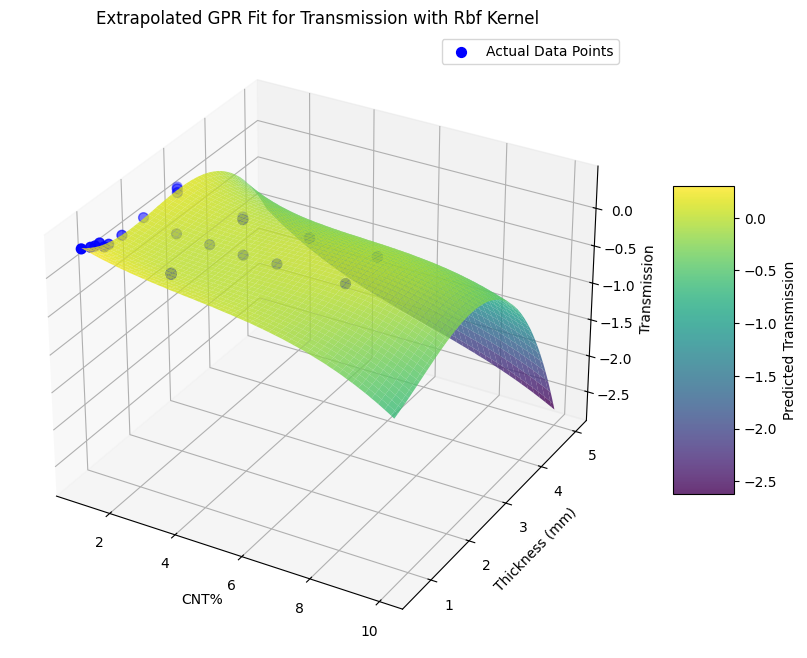

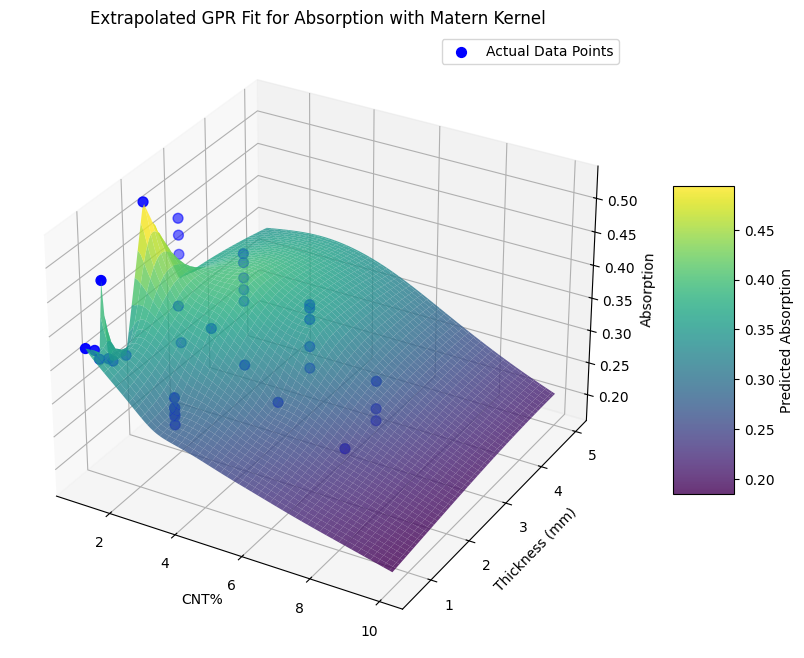

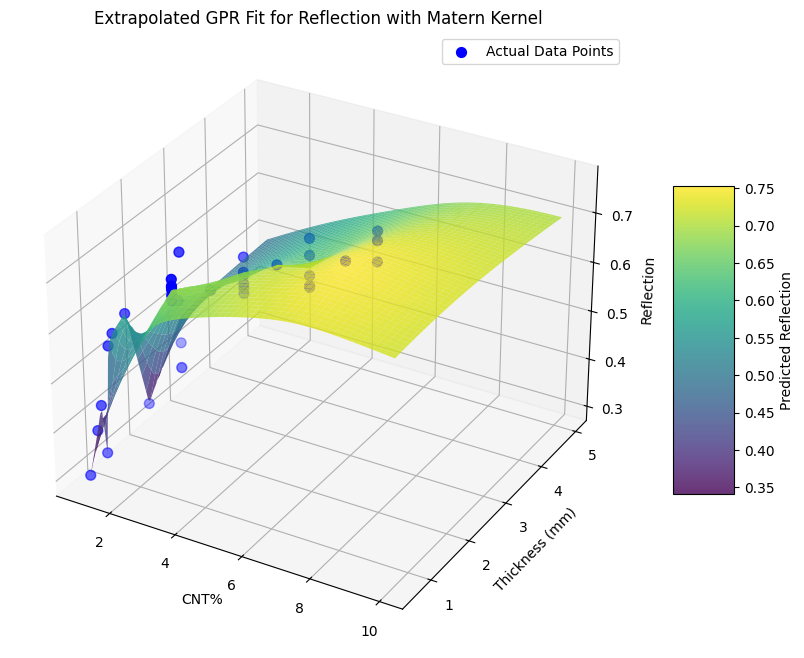

...

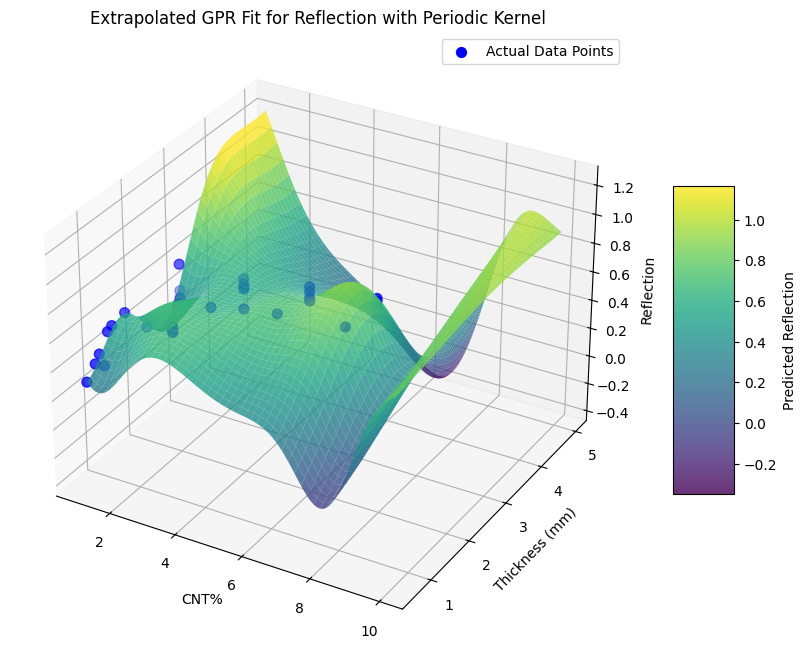

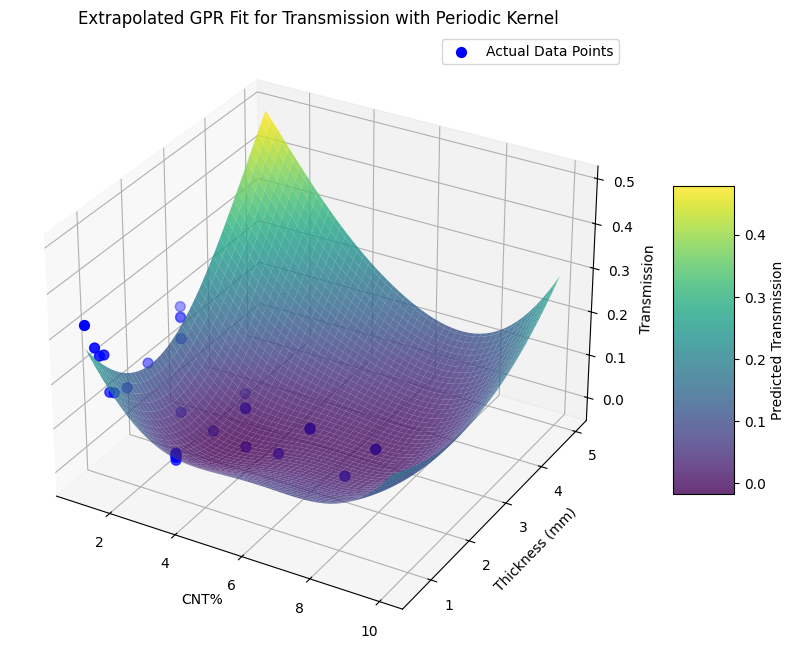

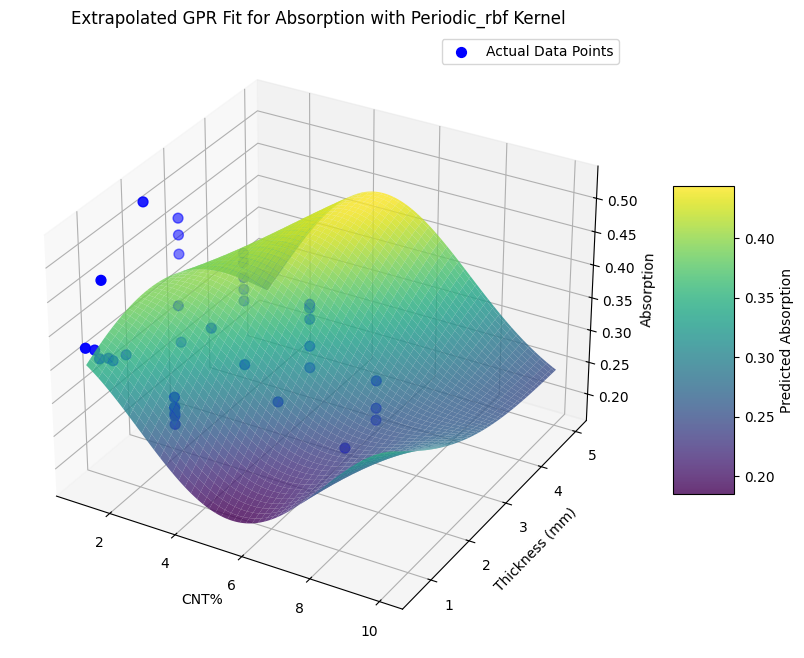

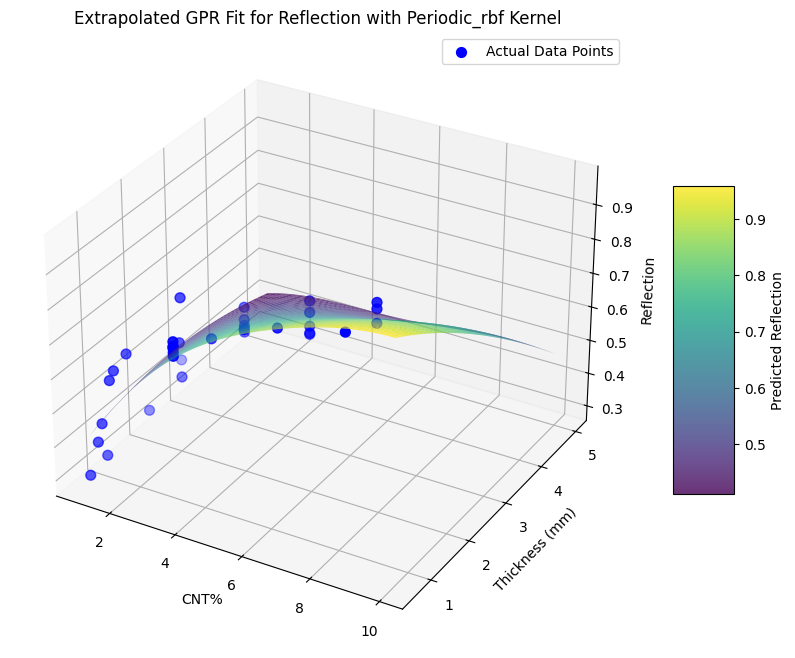

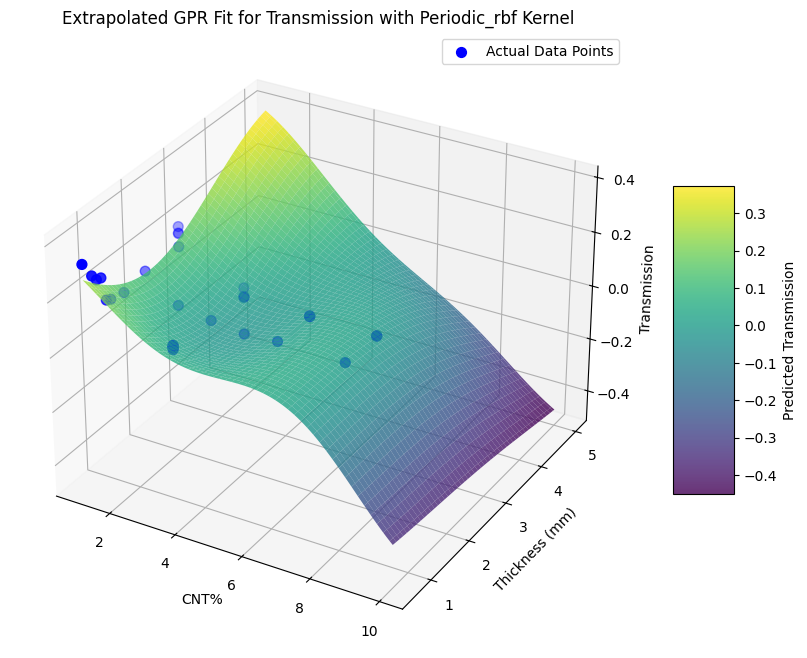

In [ ]:
# Define models with their best parameters
def create_model(kernel, params):
    return GaussianProcessRegressor(kernel=kernel, alpha=params.get('alpha', 1e-10), n_restarts_optimizer=10)

def create_and_visualize_models(thesis_df):
    # Define best parameters for all models
    parameters = {
        "rbf": {
            "absorption": {'length_scale': 0.1, 'length_scale_bounds': (100.0, 10000.0), 'constant': 1.0, 'alpha': 1e-10},
            "reflection": {'length_scale': 0.1, 'length_scale_bounds': (100.0, 10000.0), 'constant': 1.0, 'alpha': 1e-10},
            "transmission": {'length_scale': 0.1, 'length_scale_bounds': (100.0, 10000.0), 'constant': 1.0, 'alpha': 1e-10},
        },
        "matern": {
            "absorption": {'length_scale': 0.5, 'length_scale_bounds': (10.0, 10000.0), 'nu': 0.5, 'alpha': 1e-10},
            "reflection": {'length_scale': 0.5, 'length_scale_bounds': (100.0, 100000.0), 'nu': 0.5, 'alpha': 1e-10},
            "transmission": {'length_scale': 0.5, 'length_scale_bounds': (10.0, 10000.0), 'nu': 0.5, 'alpha': 1e-10},
        },
        "rq": {
            "absorption": {'length_scale': 1.0, 'alpha': 1.0, 'length_scale_bounds': (10.0, 1000.0), 'alpha_bounds': (10.0, 1000.0), 'noise_alpha': 0.001},
            "reflection": {'length_scale': 5.0, 'alpha': 0.5, 'length_scale_bounds': (10.0, 1000.0), 'alpha_bounds': (10.0, 1000.0), 'noise_alpha': 0.001},
            "transmission": {'length_scale': 0.5, 'alpha': 1.0, 'length_scale_bounds': (10.0, 1000.0), 'alpha_bounds': (10.0, 1000.0), 'noise_alpha': 0.001},
        },
        "periodic": {
            "absorption": {'periodic_length_scale': 0.1, 'periodicity': 1.0, 'periodicity_bounds': (1.0, 1000.0), 'alpha': 0.001},
            "reflection": {'periodic_length_scale': 2.0, 'periodicity': 0.5, 'periodicity_bounds': (1.0, 10.0), 'alpha': 0.001},
            "transmission": {'periodic_length_scale': 0.1, 'periodicity': 5.0, 'periodicity_bounds': (1.0, 1000.0), 'alpha': 0.001},
        },
        "periodic_rbf": {
            "absorption": {'rbf_length_scale': 0.1, 'periodic_length_scale': 0.1, 'periodicity': 5.0, 'length_scale_bounds': (10.0, 100000.0), 'periodicity_bounds': (1.0, 1000.0), 'alpha': 0.001},
            "reflection": {'rbf_length_scale': 5.0, 'periodic_length_scale': 2.0, 'periodicity': 5.0, 'length_scale_bounds': (10.0, 100000.0), 'periodicity_bounds': (1.0, 1000.0), 'alpha': 0.001},
            "transmission": {'rbf_length_scale': 5.0, 'periodic_length_scale': 2.0, 'periodicity': 1.0, 'length_scale_bounds': (10.0, 100000.0), 'periodicity_bounds': (1.0, 1000.0), 'alpha': 0.001},
        },
    }

    # Map kernels
    kernels = {
        "rbf": lambda params: C(params['constant'], params['length_scale_bounds']) * RBF(length_scale=params['length_scale'], length_scale_bounds=params['length_scale_bounds']),
        "matern": lambda params: Matern(length_scale=params['length_scale'], length_scale_bounds=params['length_scale_bounds'], nu=params['nu']),
        "rq": lambda params: RationalQuadratic(length_scale=params['length_scale'], alpha=params['alpha'], length_scale_bounds=params['length_scale_bounds'], alpha_bounds=params['alpha_bounds']),
        "periodic": lambda params: ExpSineSquared(length_scale=params['periodic_length_scale'], periodicity=params['periodicity'], periodicity_bounds=params['periodicity_bounds']),
        "periodic_rbf": lambda params: Product(
            RBF(length_scale=params['rbf_length_scale'], length_scale_bounds=params['length_scale_bounds']),
            ExpSineSquared(length_scale=params['periodic_length_scale'], periodicity=params['periodicity'], periodicity_bounds=params['periodicity_bounds']),
        ),
    }

    # Define extended ranges
    CNT_range = [thesis_df['CNT%'].min(), 10]  # Extend to 10%
    thickness_range = [thesis_df['Thickness'].min(), 5.0]  # Extend to 5 mm

    # Visualize models
    for kernel_name, targets in parameters.items():
        for target, params in targets.items():
            # Create model and fit to data
            kernel = kernels[kernel_name](params)
            model = create_model(kernel, params)

            X = thesis_df[['cnt_pct', 'thickness']].values
            y = thesis_df[f'mean_{target[0].lower()}'].values
            model.fit(X, y)

            # Generate extended grid for predictions
            CNT_grid = np.linspace(CNT_range[0], CNT_range[1], 100)
            thickness_grid = np.linspace(thickness_range[0], thickness_range[1], 100)
            CNT_grid, thickness_grid = np.meshgrid(CNT_grid, thickness_grid)
            X_pred = np.c_[CNT_grid.ravel(), thickness_grid.ravel()]
            y_pred = model.predict(X_pred).reshape(CNT_grid.shape)

            # Plot results
            fig = plt.figure(figsize=(12, 8))
            ax = fig.add_subplot(111, projection='3d')
            surf = ax.plot_surface(CNT_grid, thickness_grid, y_pred, cmap='viridis', alpha=0.8)
            fig.colorbar(surf, shrink=0.5, aspect=5, label=f'Predicted {target.capitalize()}')

            # Overlay actual data points
            ax.scatter(
                thesis_df['CNT%'], thesis_df['Thickness'], thesis_df[f'mean_{target[0].lower()}'],
                c='blue', label='Actual Data Points', s=50
            )

            # Labels and title
            ax.set_xlabel('CNT%')
            ax.set_ylabel('Thickness (mm)')
            ax.set_zlabel(f'{target.capitalize()}')
            ax.set_title(f'Extrapolated GPR Fit for {target.capitalize()} with {kernel_name.capitalize()} Kernel')
            ax.legend()
            plt.show()

# Call the function to visualize all 15 plots
create_and_visualize_models(thesis_df)


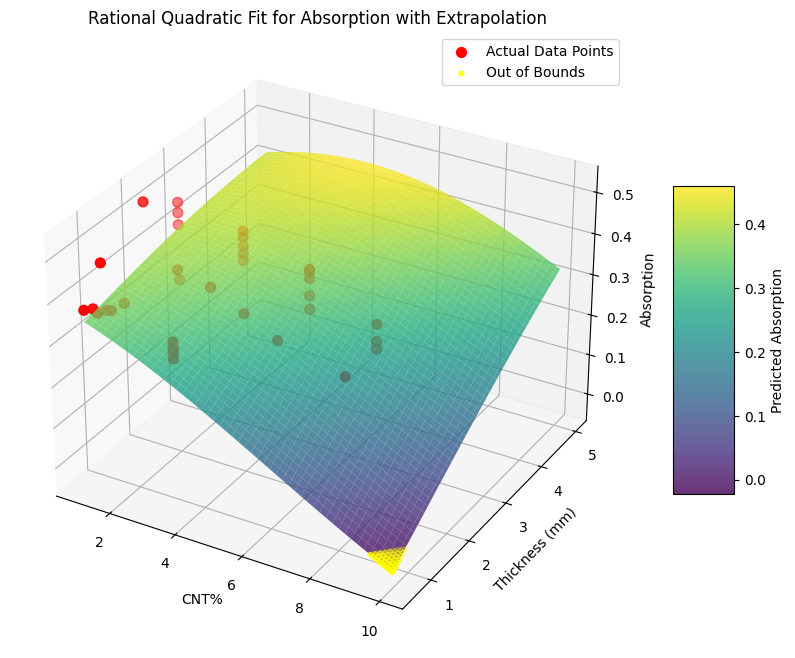

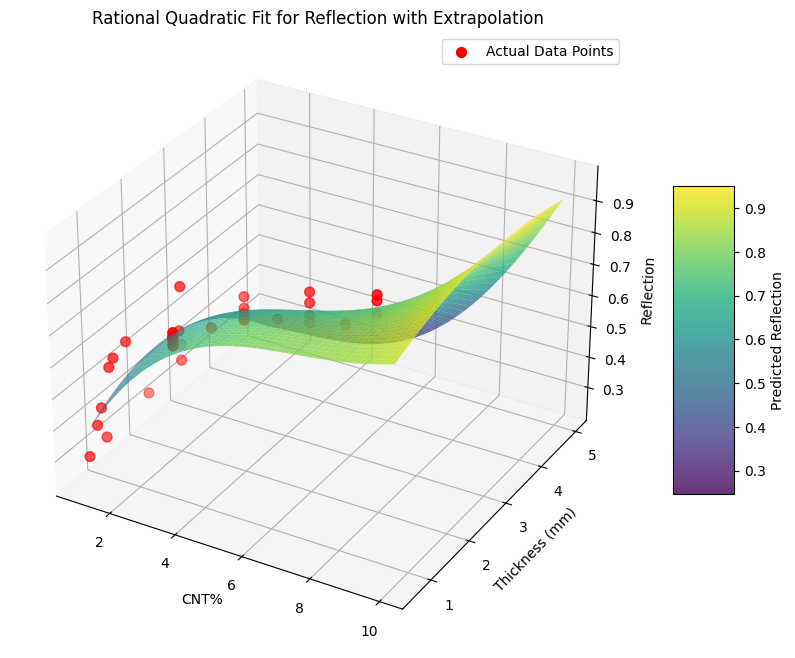

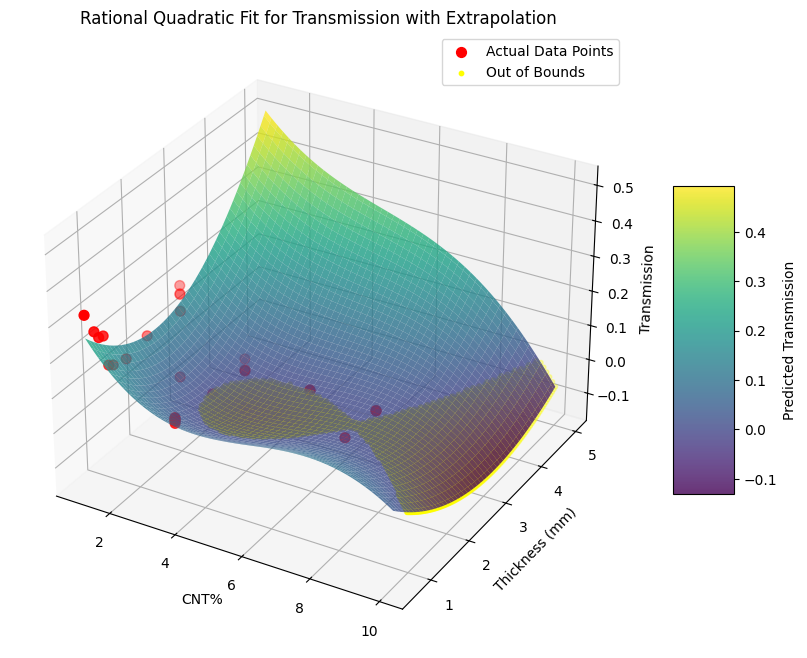

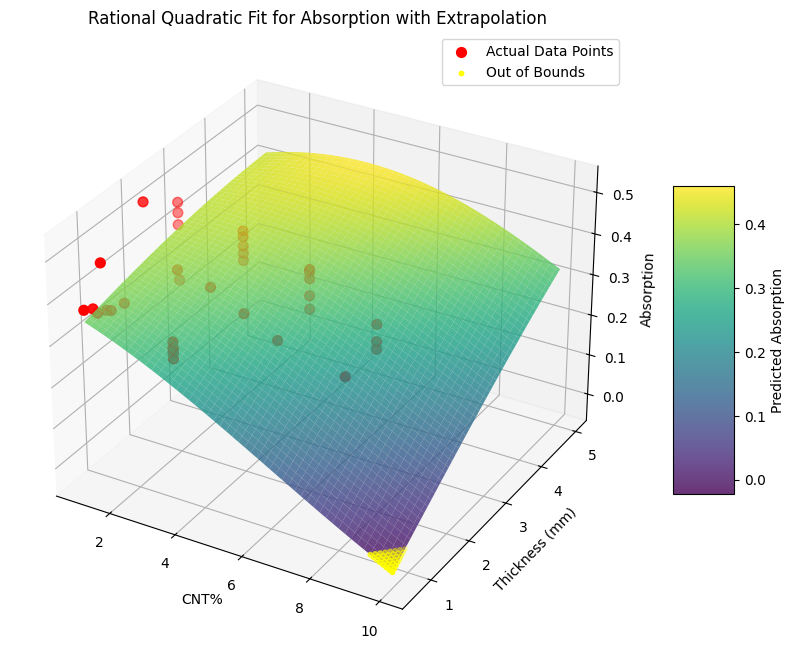

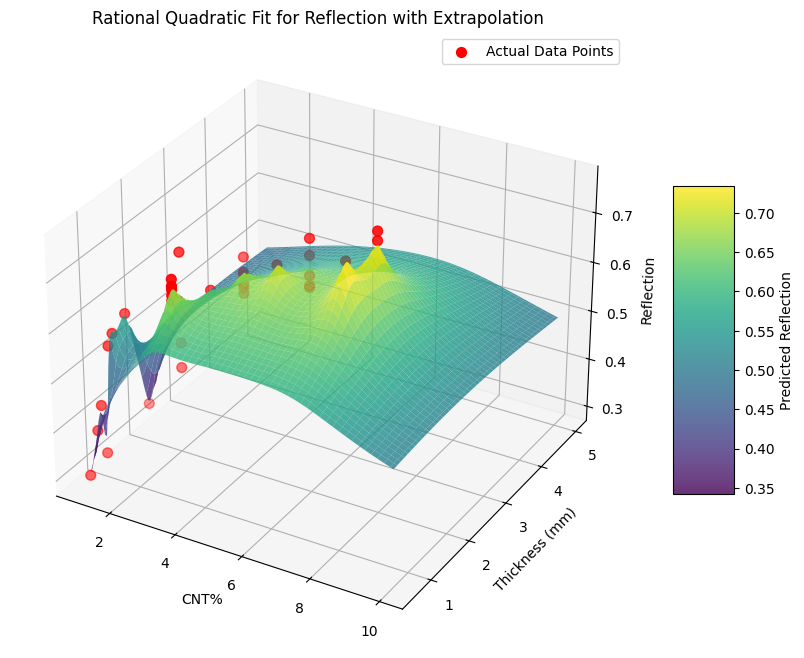

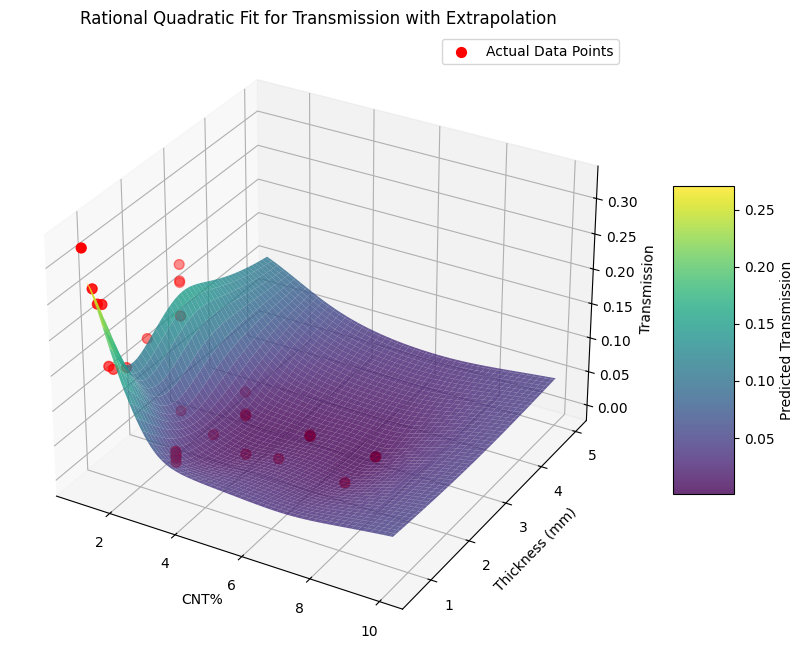

In [ ]:
def plot_rational_quadratic(thesis_df, best_params, target, grid_resolution=100, extrapolation_bounds=(0.1, 10.0, 0.6, 5.0)):
    """
    Plot Rational Quadratic kernel results with extrapolated predictions.

    Parameters:
    - thesis_df (pd.DataFrame): The dataset containing input features and targets.
    - best_params (dict): Best hyperparameters for the Rational Quadratic kernel.
    - target (str): The target variable to predict ('absorption', 'reflection', or 'transmission').
    - grid_resolution (int): Resolution for the prediction grid.
    - extrapolation_bounds (tuple): Bounds for extrapolation (min_CNT%, max_CNT%, min_Thickness, max_Thickness).

    Returns:
    - None (plots results)
    """
    # Extract features and target
    X = thesis_df[['cnt_pct', 'thickness']].values
    y = thesis_df[f'mean_{target[0].lower()}'].values

    # Define the Rational Quadratic kernel with the given parameters
    kernel = C(1.0, (1e-1, 1e3)) * RationalQuadratic(
        length_scale=best_params['length_scale'],
        alpha=best_params['alpha'],
        length_scale_bounds=best_params['length_scale_bounds'],
        alpha_bounds=best_params['alpha_bounds']
    )

    # Train the Gaussian Process Regressor
    gpr = GaussianProcessRegressor(kernel=kernel, alpha=best_params['noise_alpha'], n_restarts_optimizer=10)
    gpr.fit(X, y)

    # Generate grid for predictions
    CNT_min, CNT_max, Thickness_min, Thickness_max = extrapolation_bounds
    CNT_grid = np.linspace(CNT_min, CNT_max, grid_resolution)
    Thickness_grid = np.linspace(Thickness_min, Thickness_max, grid_resolution)
    CNT_grid, Thickness_grid = np.meshgrid(CNT_grid, Thickness_grid)
    X_pred = np.c_[CNT_grid.ravel(), Thickness_grid.ravel()]

    # Make predictions
    y_pred, y_std = gpr.predict(X_pred, return_std=True)
    y_pred = y_pred.reshape(CNT_grid.shape)

    # Plot the results
    fig = plt.figure(figsize=(12, 8))
    ax = fig.add_subplot(111, projection='3d')
    surf = ax.plot_surface(CNT_grid, Thickness_grid, y_pred, cmap='viridis', alpha=0.8)
    fig.colorbar(surf, shrink=0.5, aspect=5, label=f'Predicted {target.capitalize()}')

    # Overlay the actual data points
    ax.scatter(
        thesis_df['CNT%'], thesis_df['Thickness'], thesis_df[f'mean_{target[0].lower()}'],
        c='red', label='Actual Data Points', s=50
    )

    # Highlight where predictions exceed bounds
    out_of_bounds = (y_pred < 0) | (y_pred > 1)
    if np.any(out_of_bounds):
        ax.scatter(CNT_grid[out_of_bounds], Thickness_grid[out_of_bounds], y_pred[out_of_bounds],
                   c='yellow', label='Out of Bounds', s=10)

    # Labels and title
    ax.set_xlabel('CNT%')
    ax.set_ylabel('Thickness (mm)')
    ax.set_zlabel(f'{target.capitalize()}')
    ax.set_title(f'Rational Quadratic Fit for {target.capitalize()} with Extrapolation')
    ax.legend()
    plt.show()

# Example usage
rational_quadratic_params = [
    {'length_scale': 1.0, 'alpha': 1.0, 'length_scale_bounds': (10.0, 1000.0), 'alpha_bounds': (10.0, 1000.0), 'noise_alpha': 0.001},
    {'length_scale': 5.0, 'alpha': 0.5, 'length_scale_bounds': (10.0, 1000.0), 'alpha_bounds': (10.0, 1000.0), 'noise_alpha': 0.001},
    {'length_scale': 0.5, 'alpha': 1.0, 'length_scale_bounds': (10.0, 1000.0), 'alpha_bounds': (10.0, 1000.0), 'noise_alpha': 0.001},
    {'length_scale': 0.1, 'alpha': 5.0, 'length_scale_bounds': (10.0, 1000.0), 'alpha_bounds': (10.0, 1000.0), 'noise_alpha': 0.001},
    {'length_scale': 0.5, 'alpha': 0.1, 'length_scale_bounds': (0.01, 100.0), 'alpha_bounds': (0.1, 1000.0), 'noise_alpha': 0.001},
    {'length_scale': 0.1, 'alpha': 0.1, 'length_scale_bounds': (0.1, 1000.0), 'alpha_bounds': (0.01, 100.0), 'noise_alpha': 0.001},
]

targets = ["absorption", "reflection", "transmission"]

for i, params in enumerate(rational_quadratic_params):
    target = targets[i % 3]  # Rotate through targets
    plot_rational_quadratic(thesis_df, params, target, extrapolation_bounds=(1.0, 10.0, 0.6, 5.0))
